In [1]:
#######################################################################################
# Read Me Section:
## Name:
# Kaylen Smith Darnbrook
# Student ID:
# 2135667
# Course:
# M.S.c Machine Learning and Artificial Intelligence
# Module:
## DemonstrationProgressiveFaceGeneration
## Description: 
# This module is responsible for the creation and evaluation of the Curricullum Learning Based Generative Accumulation Of Photons.
# 
# This module is responsible for creating the experimentation and creation of
# pipeline for the generation of faces using the Generative Accumulation Of Photons.
# The module will also be responsible for the analysis of the faces generated.
# It uses the FFHQ256 dataset to train the model. The model is then saved to the
# 'models' directory. The model is then used to generate faces from the FFHQ256 dataset.
# A single model and cascade model implementation of GAP is used. The model is trained
# using the Adam optimizer and the loss function is the PhotonLoss Function. Each model
# is trained for 30 epochs. The models are compared using the Psnr, SSIM and Perceptual
# loss metric.
#####################################################################################

In [2]:
# Import Relevant Libraries:

# Import modules for system managment, io and file management 
import os 
import sys
import time 
import random

# Import modules for data manipulation and analysis
import numpy as np
import pandas as pd
import scipy as sp

# Import modules for data visualisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})
sns.set_context("notebook")
from PIL import Image

# Import modules for Deep learning
import torch

from torch.utils.data import DataLoader
torch.set_float32_matmul_precision('medium')
torch.autograd.set_detect_anomaly(True)

# Pytorch Lightning Modules:
import pytorch_lightning as pL
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping, LearningRateMonitor
from pytorch_lightning.callbacks import LearningRateMonitor

# Import modules for model selection and evaluation.
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Import the DataLoader
#from BinomDataset4 import FacesDataset
from PoissonDataset10 import FacesDataset
from PoissonValidator2 import ValidationSetGenerator
from OriginalGAPUNet import UNet
import wandb 
from pytorch_lightning.loggers import WandbLogger

# Visualisation Software
import time
import numpy as np
import lpips

In [3]:
'''
Samples an image using Generative Accumulation of Photons (GAP) based on an initial photon image.
If the initial photon image contains only zeros the model samples from scratch. 
If it contains photon numbers, the model performs diversity denoising.

        Parameters:
                input_image (torch tensor): the initial photon image, containing integers (batch, channel, y, x).  
                model: the network used to predict the next phton location.
                max_photons (int): stop sampling when image contains more photons. 
                max_its (int): stop sampling after max_its iterations. 
                max_psnr (float): stop sampling when pseudo PSNR is larger max_psnr
                save_every_n (int): store and return images at every nth step. 
                augment (bool): use 8-fold data augmentation (default is False) 
                beta (float): photon number is increased exponentially by factor beta in each step.
        Returns:
                denoised (numpy array): denoised image at the end of that sampling process.
                photons (numpy array): photon image at the end of the sampling process.
                stack (list): list of numpy arrays containing intermediate results.
                i (int) number of executed iterations.
'''
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            break
            
        if psnr > max_psnr:
            break
    
        denoised = model(photons)
        denoised.detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    return denoised[...].detach().cpu().numpy(), photons[...].detach().cpu().numpy(), stack, i

In [4]:
# Wraps around the sample_image_3 function to generate the faces.
def Sample_Image(input_image, model,  max_psnr, max_its = 1000, beta = 0.005, save_every_n = 10, device = 'cuda'):
    channels = 3
    batch_size = 1
    pixels_x = 128
    pixels_y = 128

    model = model.to(device)
    model.eval()
    input_image = input_image.to(device)

    denoised, photons, stack, i = sample_image_3(input_image, model, max_its = max_its, max_psnr = max_psnr, 
                                                 beta = beta, save_every_n = save_every_n)
    return denoised, photons, stack, i

In [27]:
# Sets the plotting parameters for the visualisation of the images.
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["savefig.facecolor"] = "white"
plt.rc("text", usetex = False)
plt.rc("font", family = "Times New Roman")
plt.rcParams["axes.grid"] = False

In [6]:
## Configuration
# Set the seed for reproducibility
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

# Set the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")
GREYSCALE = False

# Set the path to the data
root_path = r"ffhq256_dataset/ffhq256"  # Replace with the Directory the FFHQ256 dataset is stored in
out_dir =r"TestSet"  # Replace with the Directory to save the generated images
Batch_Size = 32
load_pretained = False
NUM_Features = 128 * 128
max_epochs = 30
patience = 10
minpsnr = -40
maxpsnr = 32

Device: cuda


In [7]:
# Generates plots of the Psnr, SSIM and Perceptual Loss from the data.
from IPython.display import display
def Plot_Creater(Psnr_Distribution, SSIM_Distribution, Perceptual_Distribution, minpsnr, maxpsnr):
    Psnr_Distribution = Psnr_Distribution.copy()
    SSIM_Distribution = SSIM_Distribution.copy()
    Perceptual_Distribution = Perceptual_Distribution.copy()
    Psnr_Distribution = pd.DataFrame(Psnr_Distribution, columns = ["PSNR"])
    Psnr_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution.shape[0])
    Psnr_Distribution["PSNR_Average"] = Psnr_Distribution["PSNR"].rolling(window = 12).mean()
    Psnr_Distribution["PSNR_Variance"] = Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Upper"] = Psnr_Distribution["PSNR_Average"] + Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Lower"] = Psnr_Distribution["PSNR_Average"] - Psnr_Distribution["PSNR"].rolling(window = 12).std()   
    Psnr_Distribution.dropna(inplace = True)
    display(Psnr_Distribution.describe())

    SSIM_Distribution = pd.DataFrame(SSIM_Distribution, columns = ["SSIM"])
    SSIM_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution.shape[0])
    SSIM_Distribution["SSIM_Average"] = SSIM_Distribution["SSIM"].rolling(window = 12).mean()
    SSIM_Distribution["SSIM_Variance"] = SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Upper"] = SSIM_Distribution["SSIM_Average"] + SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Lower"] = SSIM_Distribution["SSIM_Average"] - SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution.dropna(inplace = True)
    display(SSIM_Distribution.describe())

    Perceptual_Distribution = pd.DataFrame(Perceptual_Distribution, columns = ["1-PL"])
    Perceptual_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution.shape[0])
    Perceptual_Distribution["1-PL_Average"] = Perceptual_Distribution["1-PL"].rolling(window = 12).mean()
    Perceptual_Distribution["1-PL_Variance"] = Perceptual_Distribution["1-PL"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Upper"] = Perceptual_Distribution["1-PL_Average"] + Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Lower"] = Perceptual_Distribution["1-PL_Average"] - Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution.dropna(inplace = True)
    display(Perceptual_Distribution.describe())

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
    Psnr_Area = np.trapz(Psnr_Distribution["PSNR_Average"].values, Psnr_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("PSNR")
    plt.title("Psnr vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
    SSIM_Area = np.trapz(SSIM_Distribution["SSIM_Average"].values, SSIM_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("SSIM")
    plt.title("SSIM vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.scatterplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red") 
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
    Perceptual_Area = np.trapz(Perceptual_Distribution["1-PL_Average"].values, Perceptual_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("1-Perceptual_Loss")
    plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
    plt.show()

    print(f"Psnr Area: {Psnr_Area}, SSIM Area: {SSIM_Area}, Perceptual Area: {Perceptual_Area}")

    print("Mean Psnr",Psnr_Distribution["PSNR"].mean())
    print("Std Psnr",Psnr_Distribution["PSNR"].std()) 
    print("Min Psnr",Psnr_Distribution["PSNR"].min()) 
    print("Max Psnr",Psnr_Distribution["PSNR"].max())
    print("Mean Roll Var",Psnr_Distribution["PSNR_Variance"].mean())

    print("Mean SSIM",SSIM_Distribution["SSIM"].mean())
    print("Std SSIM",SSIM_Distribution["SSIM"].std()) 
    print("Min SSIM",SSIM_Distribution["SSIM"].min()) 
    print("Max SSIM",SSIM_Distribution["SSIM"].max())
    print("Mean Roll SSIM",SSIM_Distribution["SSIM_Variance"].mean())

    print("Mean 1-PL",Perceptual_Distribution["1-PL"].mean())
    print("Std 1-PL",Perceptual_Distribution["1-PL"].std()) 
    print("Min 1-PL",Perceptual_Distribution["1-PL"].min()) 
    print("Max 1-PL",Perceptual_Distribution["1-PL"].max())
    print("Mean Roll 1-PL",Perceptual_Distribution["1-PL_Variance"].mean())

    return Psnr_Area, SSIM_Area, Perceptual_Area

In [8]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
Steps = 9
Spacing = (maxpsnr - minpsnr) // Steps
PSNR_Ranges = [(i, j) for i, j in zip(range(minpsnr, maxpsnr, Spacing), range(minpsnr + Spacing, maxpsnr + Spacing, Spacing))]
print(PSNR_Ranges)

[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32)]


In [9]:
# Generates the metric functions for the PSNR, SSIM and Pseudo_PSNR
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

def SSIM(original, transformed):
    return sp.signal.ssim(original, transformed, multichannel=True)

def Estimated_Psuedo_PSNR(transformed, image_size):
    intensity = transformed/image_size
    return 10 * np.log(intensity)

In [10]:
# Generates a plot of the random persons in the dataset.
def plot_random_persons(images, sample = 9):
    random_image_indexes=np.array(random.sample(list(range(len(images))),sample))
    images = np.array([np.asarray(Image.open(os.path.join(root_path, images[index]))) for index in random_image_indexes])

    if (np.sqrt(sample) - int(np.sqrt(sample))) == 0:
        sqrt = int(np.sqrt(sample))
        Length, width = sqrt, sqrt
    else:
        Length, width = 1, sample
    
    fig = plt.figure(figsize=(15,15))
    for index, values in enumerate(random_image_indexes):
        images = np.array(images)
        image = (images[index] - images[index].min())/(images[index].max() - images[index].min())
        plt.subplot(Length,width,index+1)
        plt.imshow(image)
        plt.title(f'Person_id: {random_image_indexes[index]}\nShape: {images[index].shape}')
    return fig

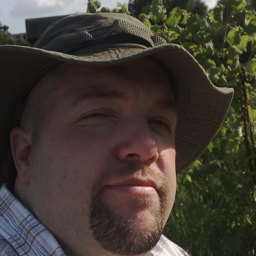

In [11]:
# Grabs the image paths from the dataset.
Image_Paths = [img for img in os.listdir(root_path)]
Image.open(os.path.join(root_path, Image_Paths[50128]))

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

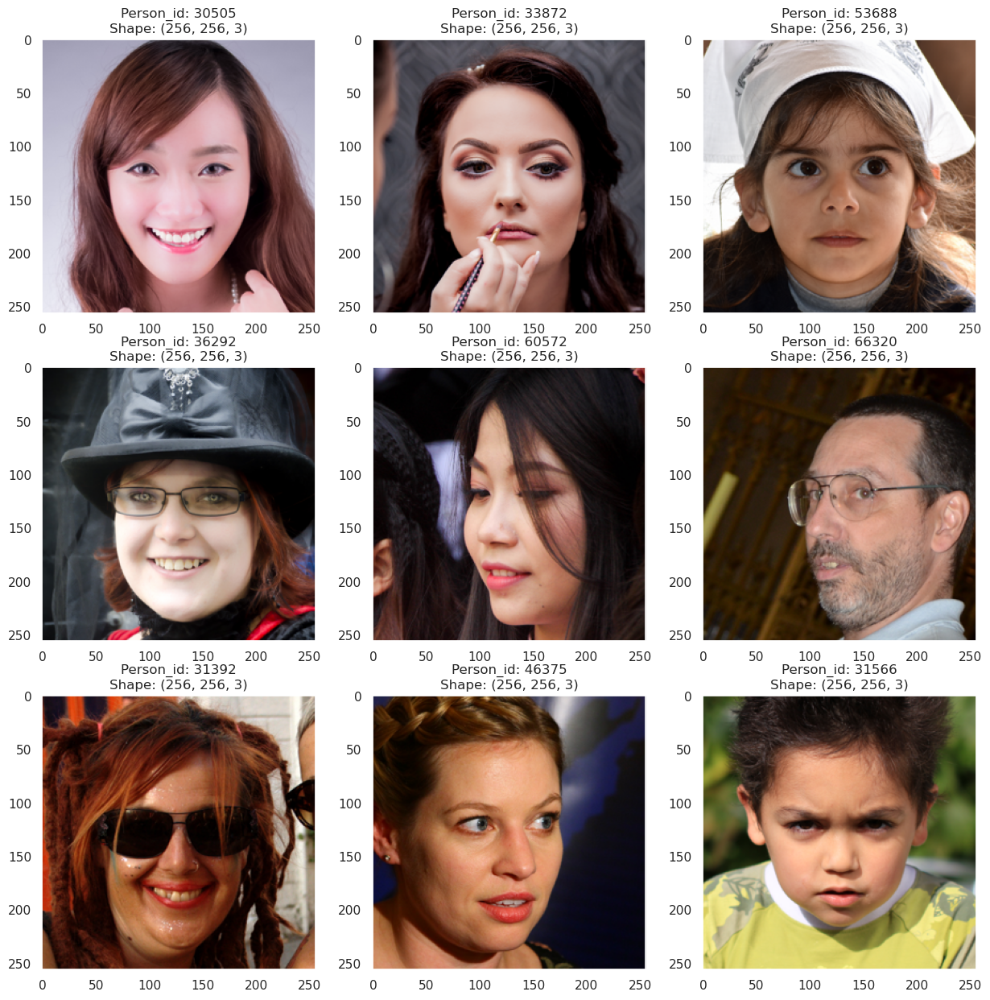

In [12]:
# Plots the Faces
fig = plot_random_persons(Image_Paths, sample = 9)

In [13]:
# Splits the data into the training and validation sets.
Directory = [path for path in os.listdir(root_path)]
rng = np.random.default_rng(seed)
indices = rng.permutation(len(Directory))
split_index = int(len(Directory) * 0.8)
train_indices = indices[:split_index]
val_indices = indices[split_index:]
train_indices.shape, val_indices.shape

((56000,), (14000,))

In [14]:
# Collects the Training and Validation Paths
Train_Paths = [Directory[index] for index in train_indices]
Val_Paths = [Directory[index] for index in val_indices]
Paths = Train_Paths.copy()
Paths.extend(Val_Paths)
np.shape(Train_Paths), np.shape(Val_Paths), np.shape(Paths)

((56000,), (14000,), (70000,))

In [15]:
# Generates the Training and Validation Datasets as well as their respective loaders.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

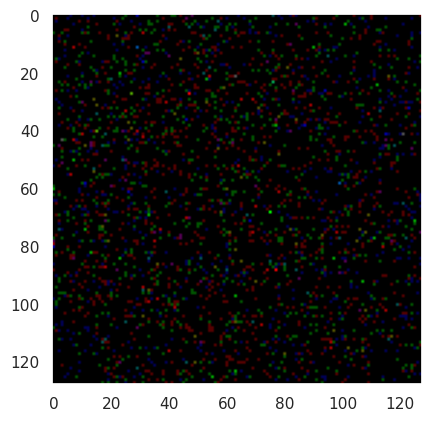

PSNR: -12.433809280395508
True PSNR: 4.245058599899253


In [16]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(42)
ImageNoise = ImageNoise.detach().cpu().numpy().transpose(1,2,0)
image_target = image_target.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image = ImageNoise/ImageNoise.mean()
normalised_image_target = image_target/image_target.mean()
normalised_image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
normalised_noisy_image = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
true_psnr = psnr(normalised_image_target, normalised_noisy_image, data_range = normalised_image_target.max() - normalised_image_target.min())
plt.imshow(normalised_noisy_image)
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr}")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

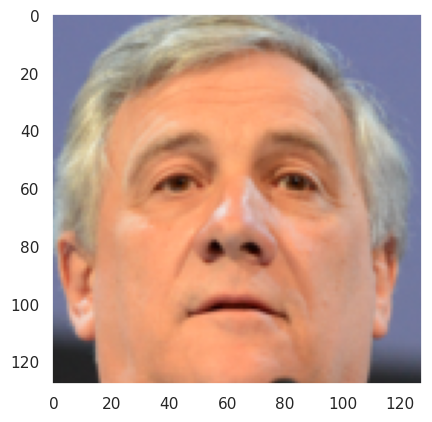

In [17]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target)
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

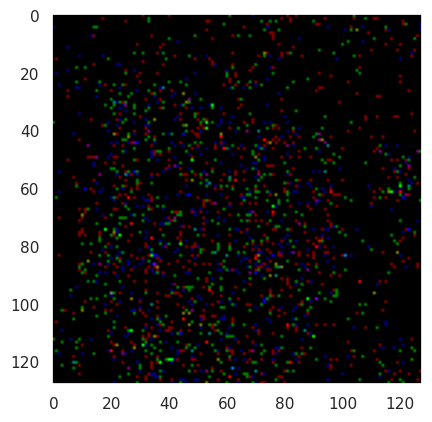

PSNR: -14.192867279052734
True PSNR: 8.257027904901333


In [18]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise_2, psnr_map_2, image_target_2 = Train_Dataset.__getitem__(42)
ImageNoise_2 = ImageNoise_2.detach().cpu().numpy().transpose(1,2,0)
image_target_2 = image_target_2.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image_2 = ImageNoise/ImageNoise.mean()
normalised_image_target_2 = image_target/image_target.mean()
normalised_image_target_2 = (image_target_2 - image_target_2.min())/(image_target_2.max() - image_target_2.min())
normalised_noisy_image_2 = (ImageNoise_2 - ImageNoise_2.min())/(ImageNoise_2.max() - ImageNoise_2.min())
true_psnr_2 = psnr(normalised_image_target_2, normalised_noisy_image_2, data_range = normalised_image_target_2.max() - normalised_image_target_2.min())
plt.imshow(normalised_noisy_image_2)
plt.show()
print(f"PSNR: {psnr_map_2.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr_2}")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

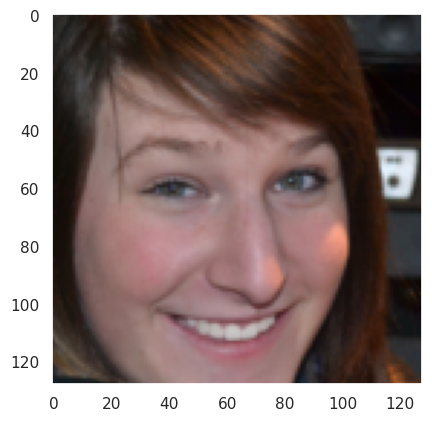

In [19]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target_2)
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

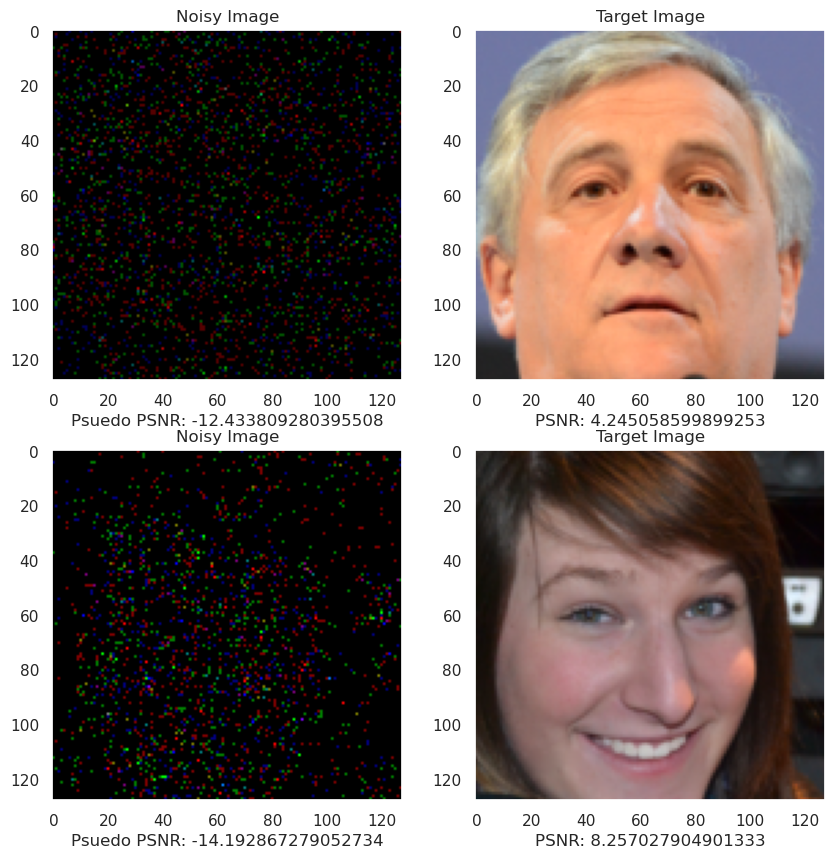

In [20]:
# Generates the model and loads the model.
figure, axes = plt.subplots(nrows = 2,ncols = 2, figsize = (10,10))
axes[0,0].imshow(normalised_noisy_image)
axes[0,0].set_title("Noisy Image")
axes[0,0].set_xlabel(f"Psuedo PSNR: {psnr_map.min().detach().cpu().numpy()}")
axes[0,1].imshow(normalised_image_target)
axes[0,1].set_title("Target Image")
axes[0,1].set_xlabel(f"PSNR: {true_psnr}")
axes[1,0].imshow(normalised_noisy_image_2)
axes[1,0].set_title("Noisy Image")
axes[1,0].set_xlabel(f"Psuedo PSNR: {psnr_map_2.min().detach().cpu().numpy()}")
axes[1,1].imshow(normalised_image_target_2)
axes[1,1].set_title("Target Image")
axes[1,1].set_xlabel(f"PSNR: {true_psnr_2}")
plt.show()

In [21]:
# Grabs the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images_Paths = []
Psnr_Maps_Paths = []
Image_Targets_Paths = []
with open(r"Validation_File_PathNames/NoisyImageNames.txt", "r") as File:  # Replace with the Dirctory Pathnames are stored in
    for line in File.readlines():
        Noisy_Images_Paths.append(line[:-1])
with open(r"Validation_File_PathNames/Psnr_MapNames.txt", "r") as File:
    for line in File.readlines():
        Psnr_Maps_Paths.append(line[:-1])
with open(r"Validation_File_PathNames/TargetImageNames.txt", "r") as File:
    for line in File.readlines():
        Image_Targets_Paths.append(line[:-1])
len(Noisy_Images_Paths), len(Psnr_Maps_Paths), len(Image_Targets_Paths)

(10, 10, 10)

In [22]:
# Generates dictionaries to store the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images = {}
Validation_Psnr_Maps = {}
Validation_Target_Images = {}
val_Steps = 10
val_minpsnr = -40
val_maxpsnr = 40
val_Spacing = (val_maxpsnr - val_minpsnr) // val_Steps
val_psnr_ranges = [(i, j) for i, j in zip(range(val_minpsnr, val_maxpsnr, val_Spacing), range(val_minpsnr + val_Spacing, val_maxpsnr + val_Spacing, val_Spacing))]
print(len(val_psnr_ranges))
FaceValidators = [ValidationSetGenerator(root_dir= root_path, out_dir=out_dir, names = Paths, minPSNR= val_psnr_ranges[i][0], targetPSNR = val_psnr_ranges[i][1], augment= True, sample_size = 100, grayscale= GREYSCALE, amplification_factor= 1e2) for i in range(len(val_psnr_ranges))]
FaceValidators[0].out_dir
print(val_psnr_ranges)
for index in range(len(val_psnr_ranges)):
    psnr_label = str(val_psnr_ranges[index][0]) + str(val_psnr_ranges[index][1])
    print(f"Loading Validation Data for {index} Val_Dataset at psnr range {psnr_label}")
    FaceValidator = FaceValidators[index]
    File_Path_NI = Noisy_Images_Paths[index]
    File_Path_PSM = Psnr_Maps_Paths[index]
    File_Path_TI = Image_Targets_Paths[index]
    Noisy_Images, Psnr_Maps, Target_Images = FaceValidator.Load_Noisy_Faces(File_Path_NI, File_Path_PSM, File_Path_TI, device=device)
    Validation_Noisy_Images[psnr_label] = Noisy_Images
    Validation_Psnr_Maps[psnr_label] = Psnr_Maps
    Validation_Target_Images[psnr_label] = Target_Images
len(Validation_Noisy_Images), len(Validation_Psnr_Maps), len(Validation_Target_Images)

10
[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32), (32, 40)]
Loading Validation Data for 0 Val_Dataset at psnr range -40-32
Loading Validation Data for 1 Val_Dataset at psnr range -32-24
Loading Validation Data for 2 Val_Dataset at psnr range -24-16
Loading Validation Data for 3 Val_Dataset at psnr range -16-8
Loading Validation Data for 4 Val_Dataset at psnr range -80
Loading Validation Data for 5 Val_Dataset at psnr range 08
Loading Validation Data for 6 Val_Dataset at psnr range 816


/home/linux/KaylenGAP/MScGAPProject/PoissonValidator2.py:114: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Noisy_Images = torch.load(file_path_NI)
/home/linux/KaylenGAP/MSc

Loading Validation Data for 7 Val_Dataset at psnr range 1624
Loading Validation Data for 8 Val_Dataset at psnr range 2432
Loading Validation Data for 9 Val_Dataset at psnr range 3240


(10, 10, 10)

In [23]:
Validation_Noisy_Images.keys()

dict_keys(['-40-32', '-32-24', '-24-16', '-16-8', '-80', '08', '816', '1624', '2432', '3240'])

In [24]:
# Generates a sample image from the Validation Noisy Images across different noise levels
# and evaluates the visualisation of the image.
ValidationNoisyTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationPsnrTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationTargetTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
for index, key in enumerate(Validation_Noisy_Images.keys()):
    ValidationNoisyTest_Batch[index] = Validation_Noisy_Images[key][-10]
    ValidationPsnrTest_Batch[index] = Validation_Psnr_Maps[key][-10].view(1, 3, 128, 128)
    ValidationTargetTest_Batch[index] = Validation_Target_Images[key][-10]
ValidationNoisyTest_Batch.shape, ValidationPsnrTest_Batch.shape, ValidationTargetTest_Batch.shape

(torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]))

In [25]:
# Moves the validation data to the gpu
ValidationNoisyTest_Batch = ValidationNoisyTest_Batch.to(device)
ValidationPsnrTest_Batch = ValidationPsnrTest_Batch.to(device)
ValidationTargetTest_Batch = ValidationTargetTest_Batch.to(device)

In [26]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [32]:
# Creates the directory to save the model in.
name = "FaceGenerationUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [33]:
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


2.4679296 0.0 2.458251476287842 0.8903902769088745
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 17.583152770996094
18.004363313772235 25.543781375231273 inf


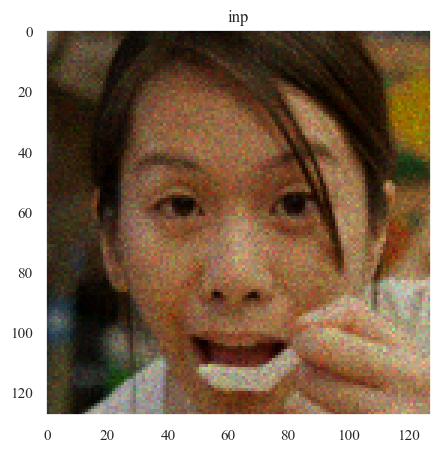

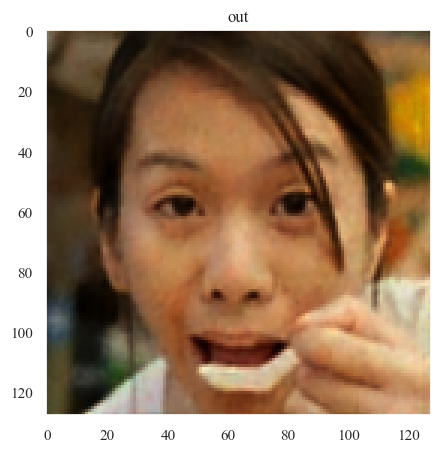

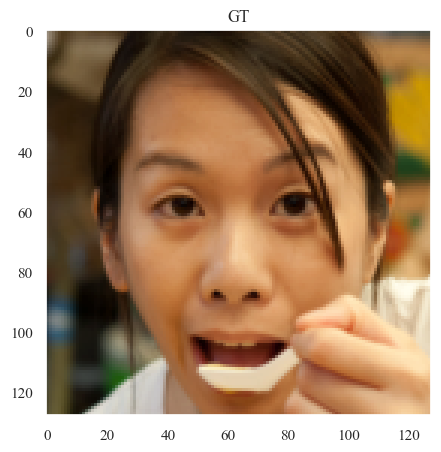

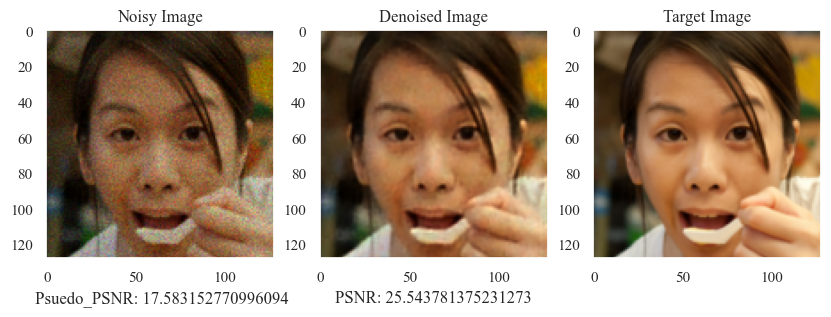

In [126]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")


ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

Psnr = psnr(ImageNoise.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

Psnr_out = psnr(out.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

Pnsr_Target = psnr(image_target.permute(1,2,0).detach().cpu().numpy(), image_target.permute(1,2,0).detach().cpu().numpy(), data_range = image_target.max().item() - image_target.min().item())

print(Psnr, Psnr_out, Pnsr_Target)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

figure, axes = plt.subplots(nrows = 1,ncols = 3, figsize = (10,10))
axes[0].imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy())
axes[0].set_title("Noisy Image")
axes[0].set_xlabel(f" Psuedo_PSNR: {Psnr_map.min().detach().cpu().numpy()}")
axes[1].imshow(out.permute(1,2,0).detach().cpu().numpy())
axes[1].set_title("Denoised Image")
axes[1].set_xlabel(f"PSNR: {Psnr_out}")
axes[2].imshow(image_target.permute(1,2,0).detach().cpu().numpy())
axes[2].set_title("Target Image")
plt.show()

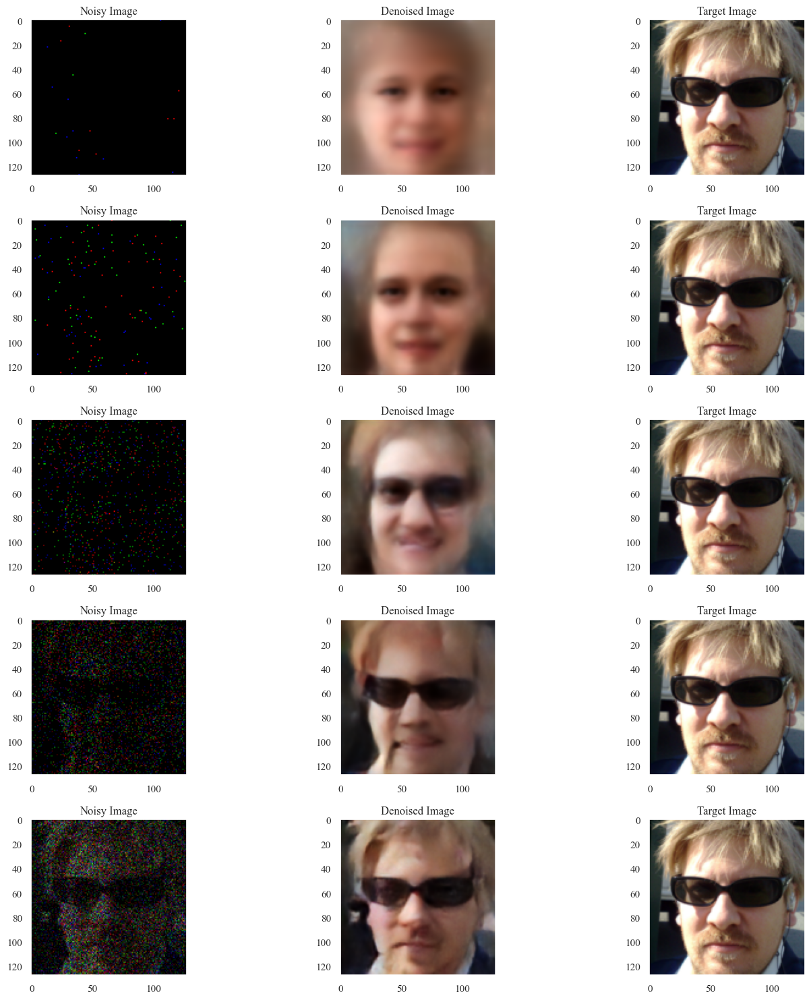

In [108]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

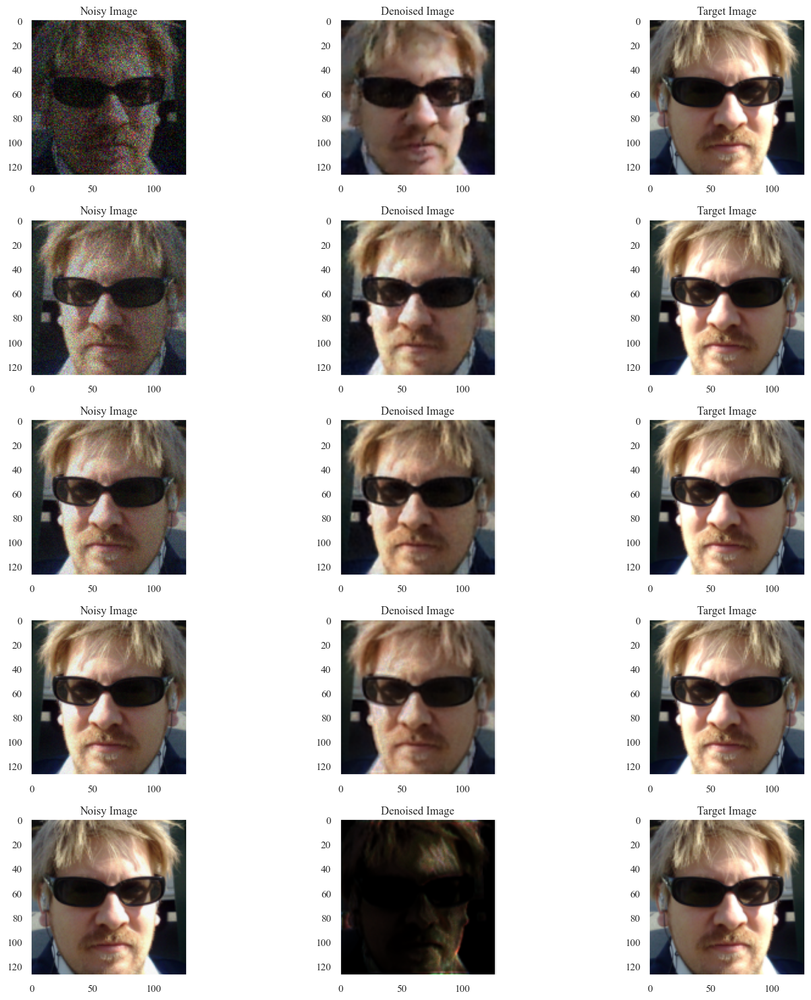

In [109]:
# continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

torch.Size([1, 3, 128, 128])
-33.6932189928148
-32.443831330892166
-30.480885081161325
-28.22309451896559
-26.270831905065673
-24.290901042849697
-22.23193863603242
-20.093960900872734
-18.067458214265123
-15.873956226059772
-13.874817014748299
-11.742133117210257
-9.666102698353482
-7.548264112718208
-5.4532007491603105
-3.3524756323123626
-1.2195661515999665
0.8907850649657698
2.9999941832440453
5.113393034966721
7.221725716047747
9.354721834552128
11.480920752877463
13.59576221542439
15.713366383985468
17.83120376086433
19.945903503716107
22.063618339747777
24.183342723478898
26.30359087346846
28.42163491404035
30.541091249051743


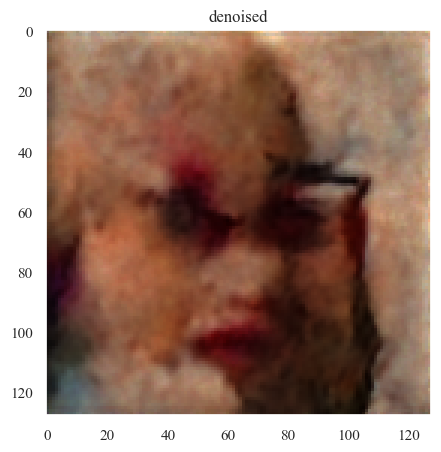

_______________________________________ 317
time (s): 96.06261706352234 time per image (s) 96.06261706352234


<Figure size 640x480 with 0 Axes>

In [22]:
# Generates an unseen image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.10,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

In [155]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_1 = np.array(Psnr_Distribution)
SSIM_Distribution_1 = np.array(SSIM_Distribution)
Perceptual_Distribution_1 = np.array(Perceptual_Distribution)
Psnr_Distribution_1.shape, SSIM_Distribution_1.shape, Perceptual_Distribution_1.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [123]:
# Generates the dataframe for the Psnr
Psnr_Distribution_1 = pd.DataFrame(Psnr_Distribution_1, columns = ["PSNR"])
Psnr_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_1.shape[0])
Psnr_Distribution_1["PSNR_Average"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_1["PSNR_Variance"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Upper"] = Psnr_Distribution_1["PSNR_Average"] + Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Lower"] = Psnr_Distribution_1["PSNR_Average"] - Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1.dropna(inplace = True)
Psnr_Distribution_1.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,22.946108,-3.559511,22.851904,1.419083,24.270986,21.432821
std,6.524294,20.564969,6.396547,0.340836,6.361009,6.449925
min,9.534812,-39.119021,13.076077,0.703284,14.475742,11.329538
25%,16.927605,-21.339266,16.770744,1.188115,18.092826,15.316895
50%,22.823743,-3.559511,22.721654,1.358948,24.025030,21.420345
75%,29.226769,14.220245,29.881936,1.612756,31.285603,28.237103
max,35.376661,32.000000,31.961869,2.553532,33.917736,30.955282


In [124]:
# Generates the dataframe for the SSIM
SSIM_Distribution_1 = pd.DataFrame(SSIM_Distribution_1, columns = ["SSIM"])
SSIM_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_1.shape[0])
SSIM_Distribution_1["SSIM_Average"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_1["SSIM_Variance"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Upper"] = SSIM_Distribution_1["SSIM_Average"] + SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Lower"] = SSIM_Distribution_1["SSIM_Average"] - SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1.dropna(inplace = True)
SSIM_Distribution_1.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.673632,-3.559511,0.670108,0.050748,0.720856,0.619359
std,0.217673,20.564969,0.211923,0.020682,0.194796,0.229635
min,0.185041,-39.119021,0.332490,0.009061,0.396513,0.252586
25%,0.477732,-21.339266,0.456092,0.034303,0.514691,0.390345
50%,0.705189,-3.559511,0.694195,0.052941,0.749749,0.638867
75%,0.886519,14.220245,0.885591,0.066979,0.920308,0.835858
max,0.971518,32.000000,0.950868,0.107478,0.990535,0.934394


In [125]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_1 = pd.DataFrame(Perceptual_Distribution_1, columns = ["1-PL"])
Perceptual_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_1.shape[0])
Perceptual_Distribution_1["1-PL_Average"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_1["1-PL_Variance"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Upper"] = Perceptual_Distribution_1["1-PL_Average"] + Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Lower"] = Perceptual_Distribution_1["1-PL_Average"] - Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1.dropna(inplace = True)
Perceptual_Distribution_1.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.465052,-3.119021,0.461664,0.055355,0.471579,0.451749
std,0.299528,20.310653,0.294188,0.028444,0.298115,0.290840
min,-0.052407,-38.238042,0.098707,0.010989,0.101214,0.093494
25%,0.132980,-20.678532,0.124758,0.033289,0.127995,0.120599
50%,0.619635,-3.119021,0.667601,0.053993,0.686700,0.654774
75%,0.735786,14.440489,0.716669,0.072825,0.727453,0.707677
max,0.914533,32.000000,0.824970,0.242917,0.836123,0.814135


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

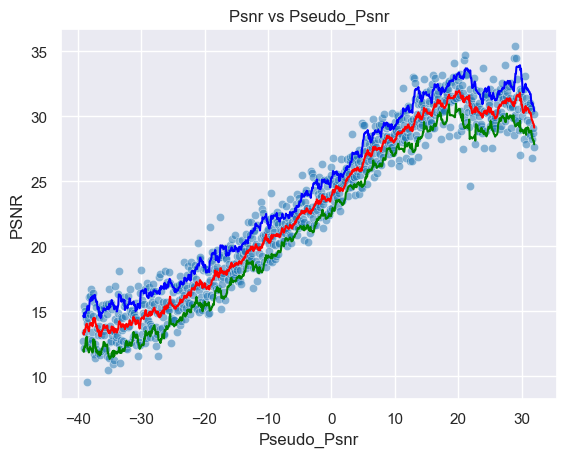

In [126]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_1 = np.trapz(Psnr_Distribution_1["PSNR_Average"].values, Psnr_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

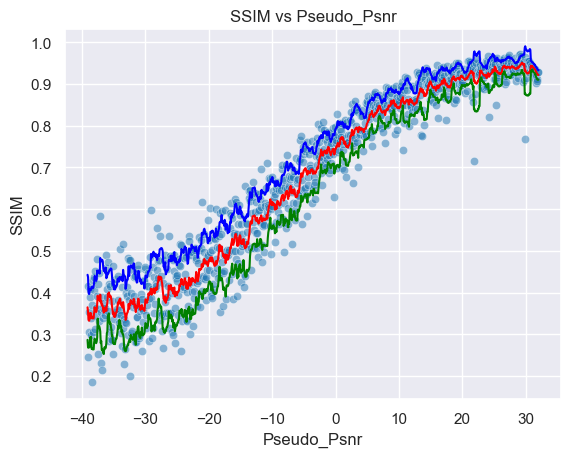

In [127]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.scatterplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_1 = np.trapz(SSIM_Distribution_1["SSIM_Average"].values, SSIM_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

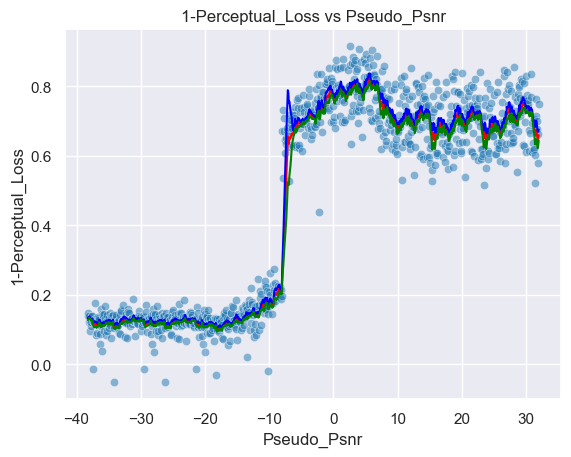

In [128]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_1 = np.trapz(Perceptual_Distribution_1["1-PL_Average"].values, Perceptual_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [129]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_1), print(SSIM_Area_1), print(Perceptual_Area_1)

1625.3343218156792
47.65957568391943
32.43177531425892


(None, None, None)

In [130]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_1["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_1["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_1["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_1["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_1["PSNR_Variance"].mean())

Mean Psnr 22.946107974973163
Std Psnr 6.524294312550647
Min Psnr 9.534811680980802
Max Psnr 35.37666074161767
Mean Roll Var 1.4190828863838074


In [131]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_1["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_1["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_1["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_1["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_1["SSIM_Variance"].mean())

Mean SSIM 0.6736319
Std SSIM 0.21767307817935944
Min SSIM 0.18504057824611664
Max SSIM 0.9715179800987244
Mean Roll SSIM 0.05074841963372095


In [132]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_1["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_1["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_1["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_1["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_1["1-PL_Variance"].mean())

Mean 1-PL 0.4650525
Std 1-PL 0.29952818155288696
Min 1-PL -0.05240678787231445
Max 1-PL 0.914533257484436
Mean Roll 1-PL 0.0553552430007652


In [28]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Highest PSNR Range
print(PSNR_Ranges[-1][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-1][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-1][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

24 32


(16384, 4096)

In [29]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

In [173]:
# Creates the directory to save the model in.
name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/" 

In [31]:
# Trains the model using the Pytorch Lightning Trainer for the Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/logger_connector/logger_connector.py:75: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `pytorch_lightning` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default


In [32]:
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-24-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [174]:
# Loads the model from the checkpoint for the Second Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [34]:
# Validates the trained model on the Training Data for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17060470581054688    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17060470581054688}]

In [35]:
# Validates the trained model on the Validation Set for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1684131920337677    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1684131920337677}]

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

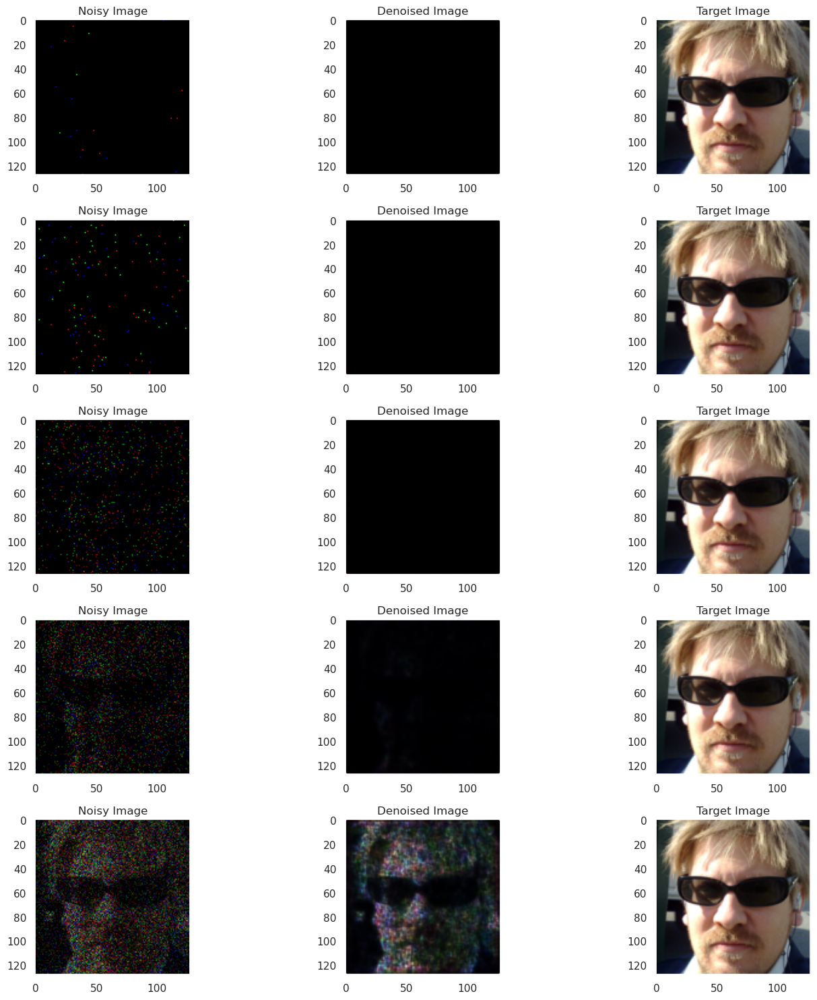

In [36]:
# Generates the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

2.5846894 0.0630412 2.5216481685638428 0.9246043562889099
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 25.58551597595215
25.584961678511068 25.584961678511068 -2.588596909321764e-07


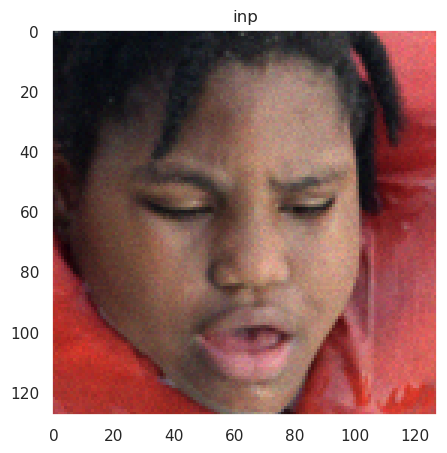

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

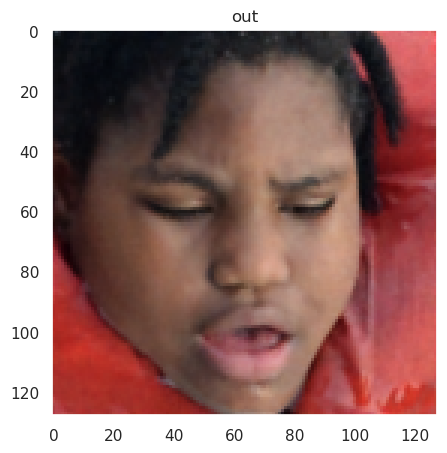

Text(0.5, 1.0, 'GT')

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

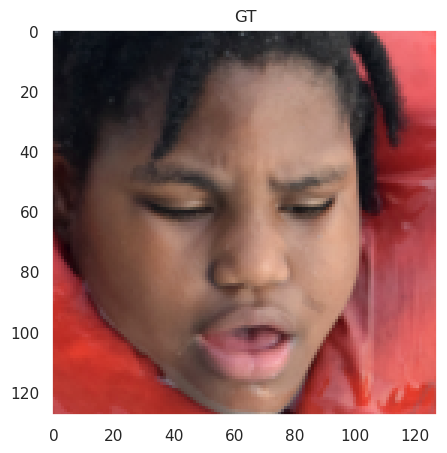

In [37]:
# # Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

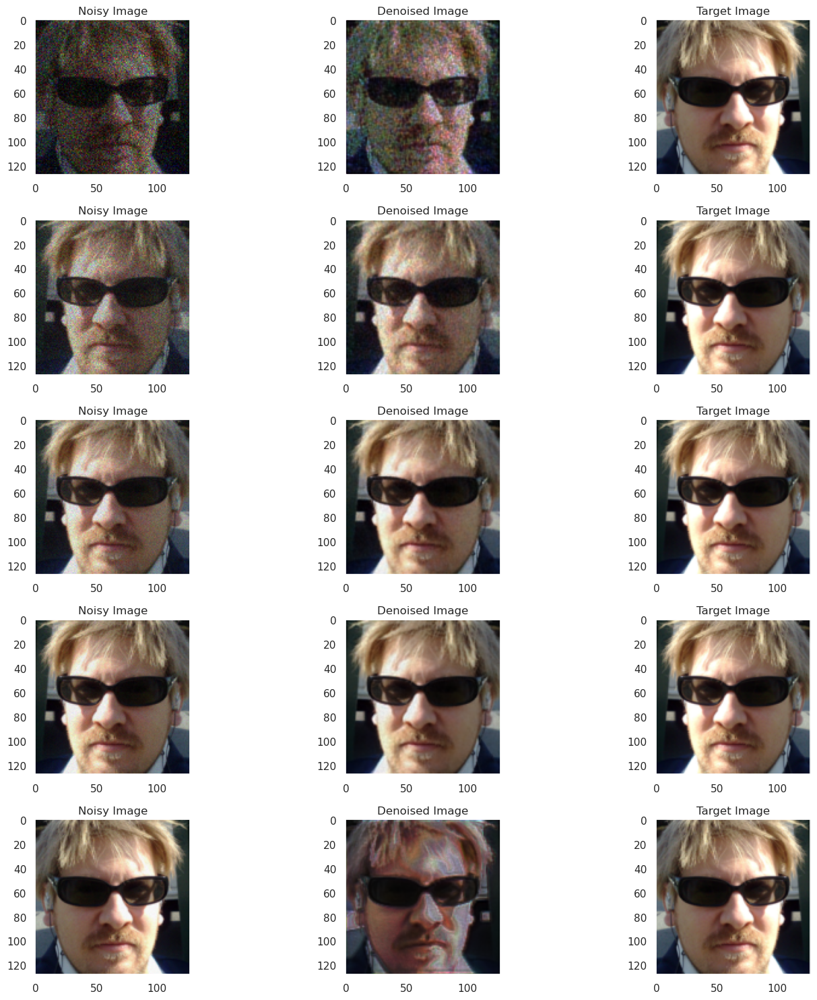

In [38]:
# Plots for a sample image the Noisy Image, its corresponding denoised image 
# and the target image for the Highest PSNR Range.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [175]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_2 = np.array(Psnr_Distribution)
SSIM_Distribution_2 = np.array(SSIM_Distribution)
Perceptual_Distribution_2 = np.array(Perceptual_Distribution)
Psnr_Distribution_2.shape, SSIM_Distribution_2.shape, Perceptual_Distribution_2.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during u

-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [176]:
np.save("Data/Psnr_Distribution_24_32.npy", Psnr_Distribution_2)
np.save("Data/SSIM_Distribution_24_32.npy", SSIM_Distribution_2)
np.save("Data/Perceptual_Distribution_24_32.npy", Perceptual_Distribution_2)

In [40]:
# Generates the dataframe for the Psnr
Psnr_Distribution_2 = pd.DataFrame(Psnr_Distribution_2, columns = ["PSNR"])
Psnr_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_2.shape[0])
Psnr_Distribution_2["PSNR_Average"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_2["PSNR_Variance"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Upper"] = Psnr_Distribution_2["PSNR_Average"] + Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Lower"] = Psnr_Distribution_2["PSNR_Average"] - Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2.dropna(inplace = True)
Psnr_Distribution_2.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,11.359438,-3.559511,11.079161,1.704677,12.783839,9.374484
std,17.414106,20.564969,17.268261,0.397940,17.192488,17.352831
min,-11.800598,-39.119021,-8.450824,0.828138,-7.073168,-10.074258
25%,-6.018301,-21.339266,-6.652582,1.425905,-4.779026,-8.339371
50%,10.297022,-3.559511,10.366104,1.676062,11.958338,8.847659
75%,28.248873,14.220245,27.672526,2.024040,29.504166,25.574737
max,42.849084,32.000000,40.190755,2.816196,41.904370,38.477141


In [41]:
# Generates the dataframe for the SSIM
SSIM_Distribution_2 = pd.DataFrame(SSIM_Distribution_2, columns = ["SSIM"])
SSIM_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_2.shape[0])
SSIM_Distribution_2["SSIM_Average"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_2["SSIM_Variance"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Upper"] = SSIM_Distribution_2["SSIM_Average"] + SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Lower"] = SSIM_Distribution_2["SSIM_Average"] - SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2.dropna(inplace = True)
SSIM_Distribution_2.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.437347,-3.559511,0.432125,0.049803,0.481928,0.382322
std,0.324482,20.564969,0.317196,0.034867,0.321760,0.316430
min,0.072744,-39.119021,0.127024,0.002670,0.142134,0.098078
25%,0.152939,-21.339266,0.150210,0.024398,0.177381,0.123850
50%,0.285650,-3.559511,0.288109,0.035117,0.368625,0.209623
75%,0.792677,14.220245,0.769512,0.075428,0.856917,0.683187
max,0.990434,32.000000,0.984618,0.157978,0.993012,0.981647


In [42]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_2 = pd.DataFrame(Perceptual_Distribution_2, columns = ["1-PL"])
Perceptual_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_2.shape[0])
Perceptual_Distribution_2["1-PL_Average"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_2["1-PL_Variance"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Upper"] = Perceptual_Distribution_2["1-PL_Average"] + Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Lower"] = Perceptual_Distribution_2["1-PL_Average"] - Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2.dropna(inplace = True)
Perceptual_Distribution_2.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.400399,-3.119021,0.396732,0.060403,0.406425,0.387039
std,0.231077,20.310653,0.221114,0.031813,0.224875,0.217476
min,-0.051249,-38.238042,0.105059,0.011438,0.107202,0.101186
25%,0.163465,-20.678532,0.155183,0.030207,0.158937,0.150377
50%,0.394134,-3.119021,0.418213,0.055396,0.430564,0.405896
75%,0.599354,14.440489,0.615984,0.086104,0.629198,0.601858
max,0.871309,32.000000,0.765900,0.147252,0.782025,0.755394


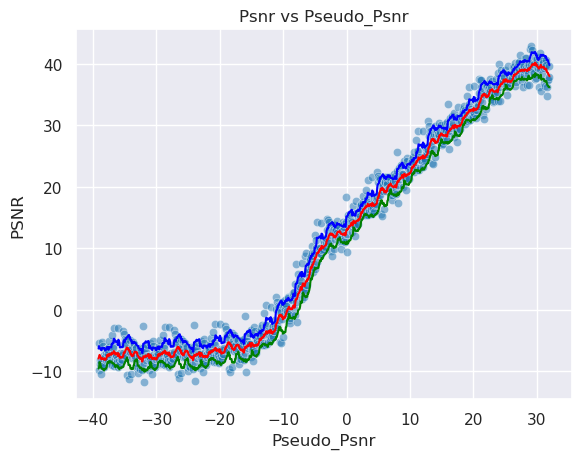

In [43]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_2 = np.trapz(Psnr_Distribution_2["PSNR_Average"].values, Psnr_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

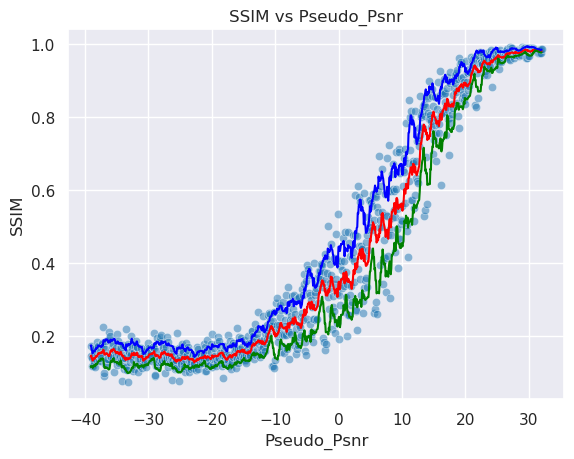

In [44]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_2 = np.trapz(SSIM_Distribution_2["SSIM_Average"].values, SSIM_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

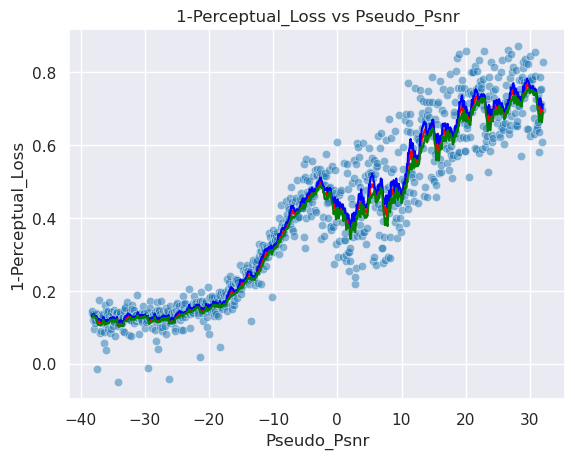

In [45]:
# Plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_2 = np.trapz(Perceptual_Distribution_2["1-PL_Average"].values, Perceptual_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [46]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_2), print(SSIM_Area_2), print(Perceptual_Area_2)

787.6238069063114
30.72193745091077
27.864216911050182


(None, None, None)

In [47]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_2["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_2["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_2["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_2["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_2["PSNR_Variance"].mean())

Mean Psnr 11.359438107299193
Std Psnr 17.414106152968785
Min Psnr -11.80059818187393
Max Psnr 42.84908353494684
Mean Roll Var 1.7046772768413683


In [48]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_2["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_2["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_2["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_2["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_2["SSIM_Variance"].mean())

Mean SSIM 0.43734726
Std SSIM 0.32448241114616394
Min SSIM 0.0727439746260643
Max SSIM 0.9904338717460632
Mean Roll SSIM 0.04980291216707416


In [49]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_2["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_2["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_2["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_2["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_2["1-PL_Variance"].mean())

Mean 1-PL 0.40039918
Std 1-PL 0.23107707500457764
Min 1-PL -0.05124938488006592
Max 1-PL 0.8713086843490601
Mean Roll 1-PL 0.06040330675296751


In [51]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Second Highest PSNR Range
print(PSNR_Ranges[-2][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-2][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-2][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

16 32


(16384, 4096)

In [52]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [53]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
name = "FaceGenerationUNet128x128-16-32"
CHECKPOINT_PATH = "./models/" 

In [54]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
Missing logger folder: models/FaceGenerationUNet128x128-16-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [55]:
# Tests the model on the Training Data for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16959334909915924    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16959334909915924}]

In [56]:
# Tests the model on the Validation Data for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17215515673160553    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17215515673160553}]

In [57]:
# Generates the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


2.385408 0.0 2.342233180999756 0.9282582998275757
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 29.23590087890625
29.235893925890345 29.235893925890345 5.177193355766363e-07


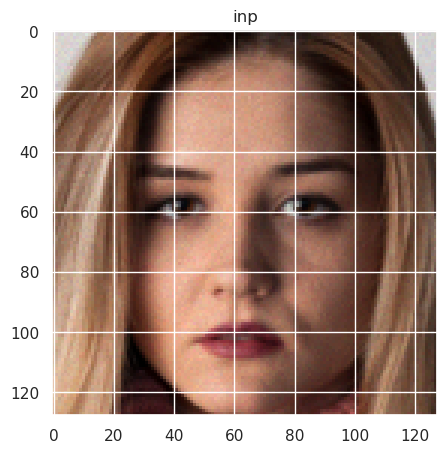

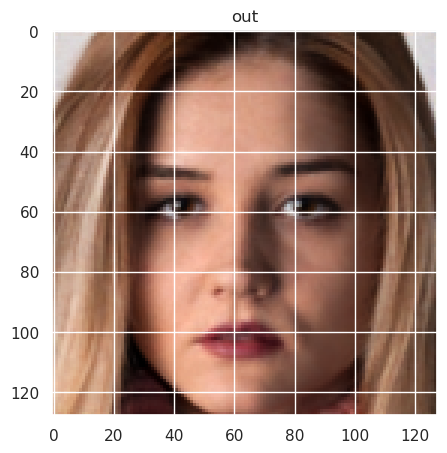

Text(0.5, 1.0, 'GT')

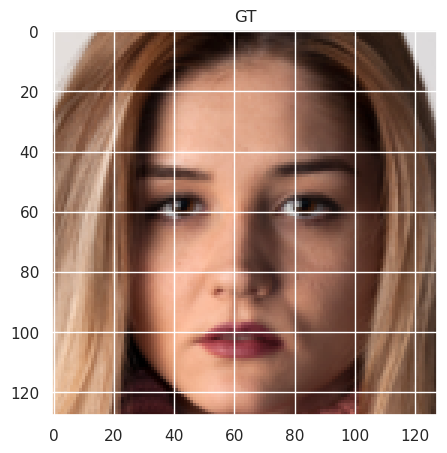

In [58]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

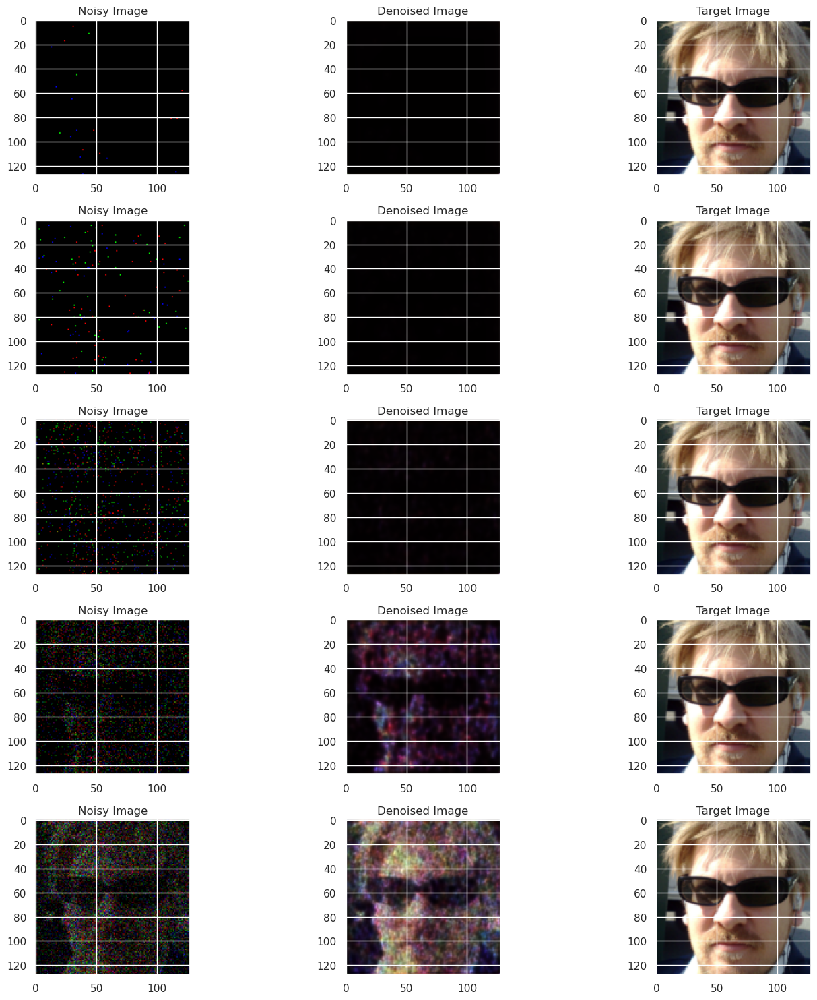

In [59]:
# Plots for a sample image the Noisy Image, its corresponding denoised image across the psnr range
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

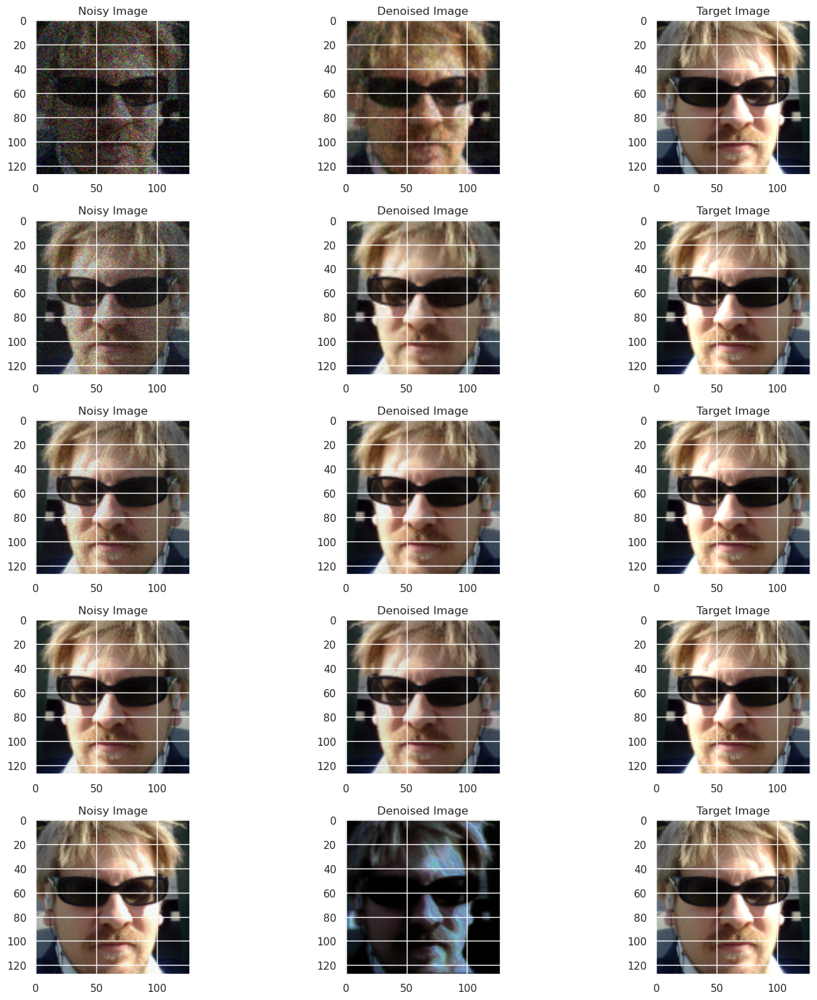

In [60]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [61]:
# Generates the Psnr, SSIM and Perceptual Loss Scores for the Validation Data.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_3 = np.array(Psnr_Distribution)
SSIM_Distribution_3 = np.array(SSIM_Distribution)
Perceptual_Distribution_3 = np.array(Perceptual_Distribution)
Psnr_Distribution_3.shape, SSIM_Distribution_3.shape, Perceptual_Distribution_3.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [62]:
np.save("Data/Psnr_Distribution_16_32.npy", Psnr_Distribution_3)
np.save("Data/SSIM_Distribution_16_32.npy", SSIM_Distribution_3)
np.save("Data/Perceptual_Distribution_16_32.npy", Perceptual_Distribution_3)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,16.715432,-3.559511,16.493656,1.582226,18.075882,14.911430
std,13.947899,20.564969,13.838481,0.389667,13.768188,13.919332
min,-4.086990,-39.119021,-0.788334,0.631972,0.530885,-2.363908
25%,2.626873,-21.339266,2.040393,1.287508,3.461551,0.441062
50%,15.957775,-3.559511,15.449945,1.554521,17.133038,13.871997
75%,31.077186,14.220245,30.391727,1.896868,32.160815,28.707193
max,41.417723,32.000000,38.850904,2.463770,40.640650,37.127936


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.492448,-3.559511,0.487601,0.050635,0.538236,0.436965
std,0.338077,20.564969,0.331926,0.030856,0.322779,0.343609
min,0.070293,-39.119021,0.135727,0.003407,0.161350,0.091188
25%,0.183103,-21.339266,0.187831,0.025021,0.232962,0.132963
50%,0.358520,-3.559511,0.328991,0.045690,0.434586,0.229069
75%,0.904640,14.220245,0.892702,0.071672,0.933525,0.843832
max,0.988403,32.000000,0.981021,0.141348,0.991523,0.977614


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.414480,-3.119021,0.410852,0.057843,0.420079,0.401625
std,0.248665,20.310653,0.240806,0.027201,0.244264,0.237437
min,-0.051711,-38.238042,0.104684,0.011123,0.106843,0.100929
25%,0.150795,-20.678532,0.133812,0.030172,0.137065,0.130811
50%,0.368623,-3.119021,0.365530,0.058973,0.375922,0.355137
75%,0.647294,14.440489,0.681257,0.079855,0.696666,0.665827
max,0.872250,32.000000,0.765994,0.124459,0.781626,0.755884


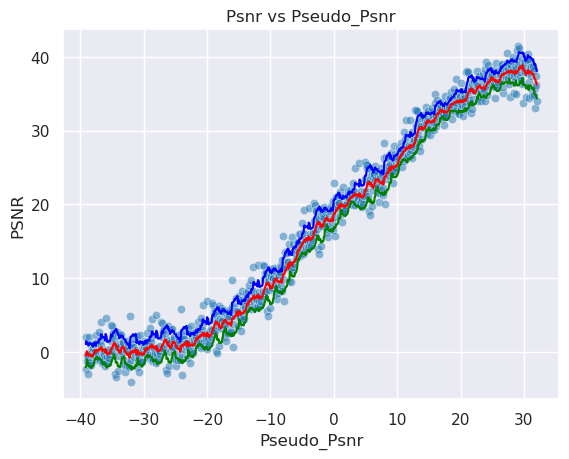

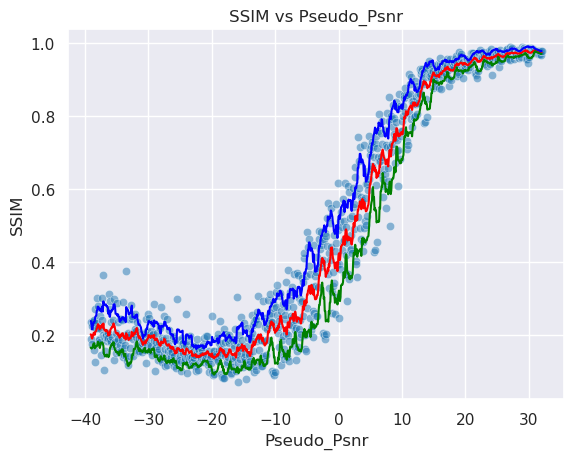

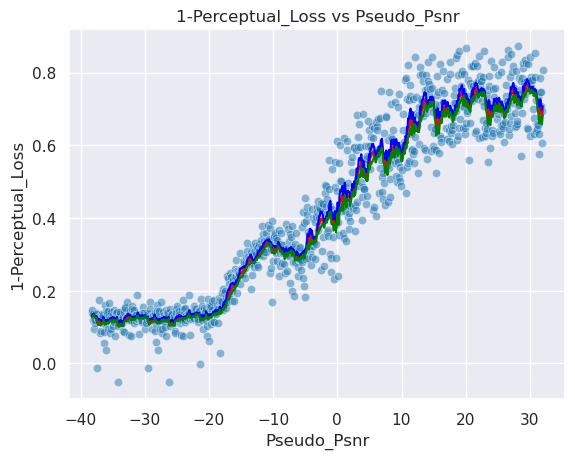

Psnr Area: 1172.9035999001028, SSIM Area: 34.66963242998842, Perceptual Area: 28.857328497130293
Mean Psnr 16.715432148448922
Std Psnr 13.947898834495033
Min Psnr -4.0869903352446695
Max Psnr 41.417723211071255
Mean Roll Var 1.5822263082385248
Mean SSIM 0.4924476
Std SSIM 0.33807748556137085
Min SSIM 0.07029320299625397
Max SSIM 0.9884031414985657
Mean Roll SSIM 0.05063543564241443
Mean 1-PL 0.4144803
Std 1-PL 0.24866527318954468
Min 1-PL -0.05171096324920654
Max 1-PL 0.8722503185272217
Mean Roll 1-PL 0.057842987462866764


(1172.9035999001028, 34.66963242998842, 28.857328497130293)

In [63]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Second Highest PSNR Range.
Plot_Creater(Psnr_Distribution_3, SSIM_Distribution_3, Perceptual_Distribution_3, minpsnr, maxpsnr)

In [64]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Third Highest PSNR Range
print(PSNR_Ranges[-3][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-3][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-3][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

8 32


(16384, 4096)

In [65]:
# Creates the directory to save the model in for the Third Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-8-32"
CHECKPOINT_PATH = "./models/" 

In [66]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [67]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-8-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [68]:
# Loads the model from the checkpoint for the Third Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [69]:
# Validates the trained model on the Train Set for the Third Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16896381974220276    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16896381974220276}]

In [70]:
# Validates the trained model on the Validation Set for the Third Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17342287302017212    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17342287302017212}]

2.5631697 0.0 2.3867573738098145 0.9547029137611389
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 14.548054695129395
14.550354842187751 14.550354842187751 -2.588596909321764e-07


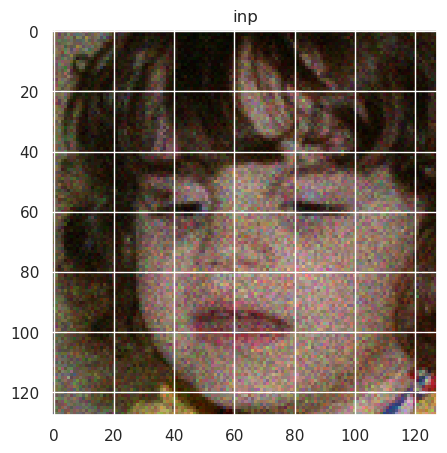

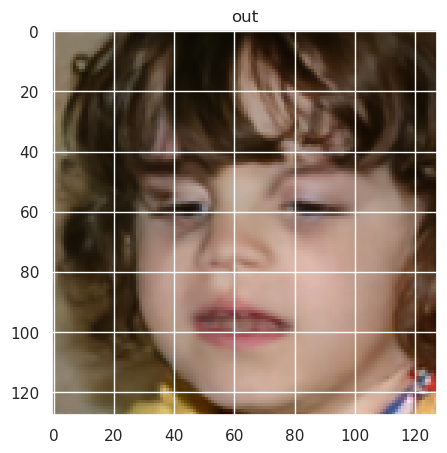

Text(0.5, 1.0, 'GT')

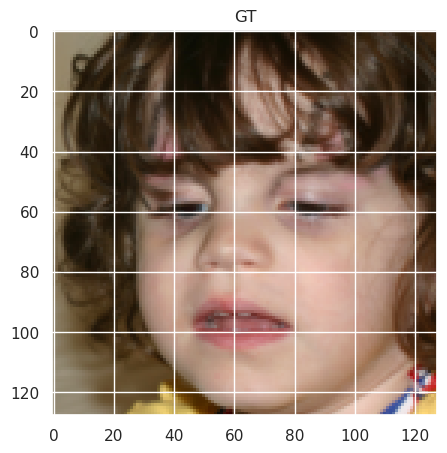

In [71]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

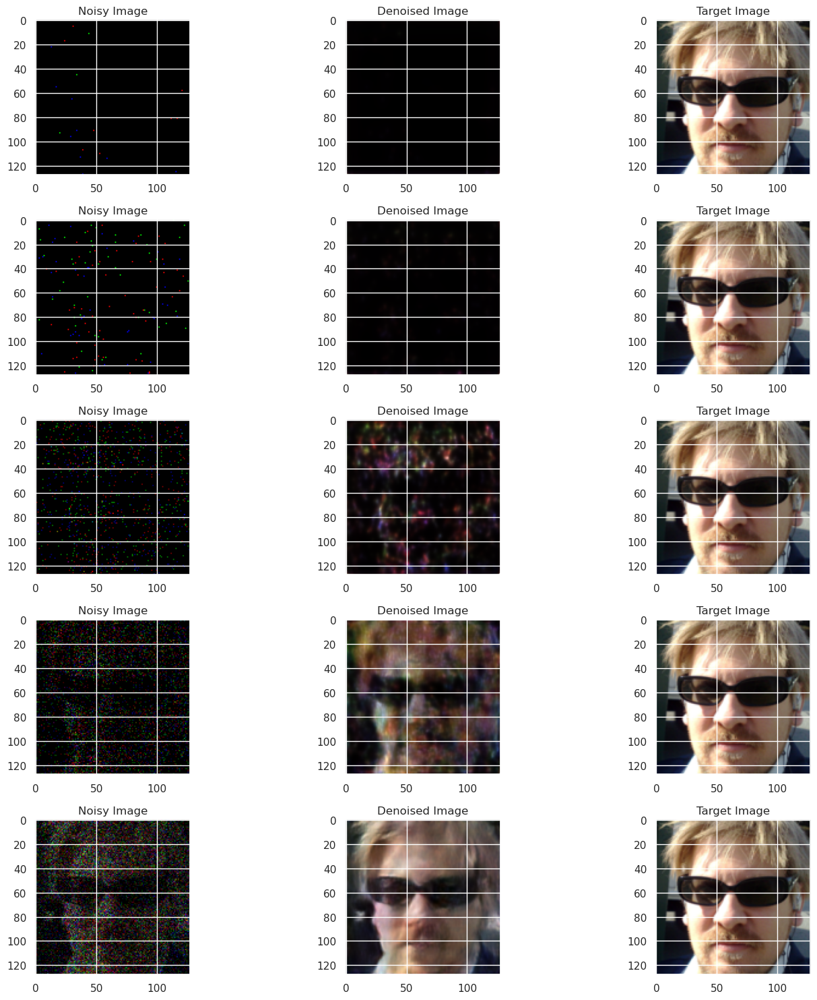

In [72]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

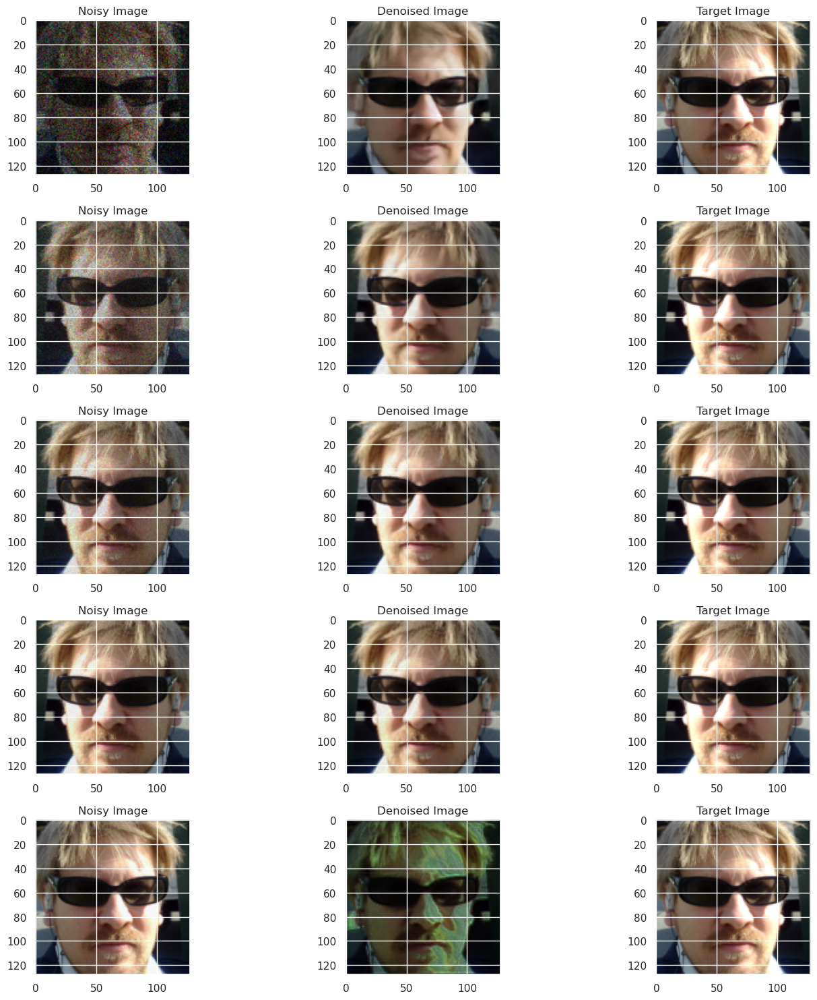

In [73]:
# Continuation of above
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [74]:
# # Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Third Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)
    
Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_4 = np.array(Psnr_Distribution)
SSIM_Distribution_4 = np.array(SSIM_Distribution)
Perceptual_Distribution_4 = np.array(Perceptual_Distribution)
Psnr_Distribution_4.shape, SSIM_Distribution_4.shape, Perceptual_Distribution_4.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [75]:
np.save("Data/Psnr_Distribution_8_32.npy", Psnr_Distribution_4)
np.save("Data/SSIM_Distribution_8_32.npy", SSIM_Distribution_4)
np.save("Data/Perceptual_Distribution_8_32.npy", Perceptual_Distribution_4)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,19.216206,-3.559511,18.968910,1.486550,20.455459,17.482360
std,14.579033,20.564969,14.523095,0.361102,14.402297,14.651799
min,-5.359474,-39.119021,-2.531815,0.609288,-1.085097,-4.208328
25%,4.126619,-21.339266,4.441416,1.214387,5.590087,3.009913
50%,21.365473,-3.559511,21.166626,1.446954,22.556933,19.642586
75%,32.887473,14.220245,32.825989,1.724980,34.193206,31.569590
max,42.696392,32.000000,39.976398,2.416498,41.733756,38.364469


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.547264,-3.559511,0.542014,0.039529,0.581543,0.502486
std,0.364976,20.564969,0.362038,0.025259,0.351834,0.373673
min,0.048552,-39.119021,0.103360,0.002691,0.133121,0.069087
25%,0.146653,-21.339266,0.140199,0.020089,0.182003,0.100656
50%,0.601249,-3.559511,0.551589,0.034145,0.645910,0.473828
75%,0.933568,14.220245,0.933307,0.056831,0.952132,0.913333
max,0.989999,32.000000,0.984554,0.119311,0.995584,0.981575


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.486867,-3.119021,0.483200,0.052762,0.492358,0.474043
std,0.289903,20.310653,0.285171,0.025034,0.288459,0.282022
min,-0.051528,-38.238042,0.104808,0.011069,0.106967,0.101022
25%,0.187338,-20.678532,0.178266,0.027932,0.184557,0.171975
50%,0.613215,-3.119021,0.614543,0.054162,0.644911,0.583322
75%,0.759254,14.440489,0.747983,0.069973,0.758071,0.738074
max,0.930605,32.000000,0.870866,0.141724,0.886816,0.862727


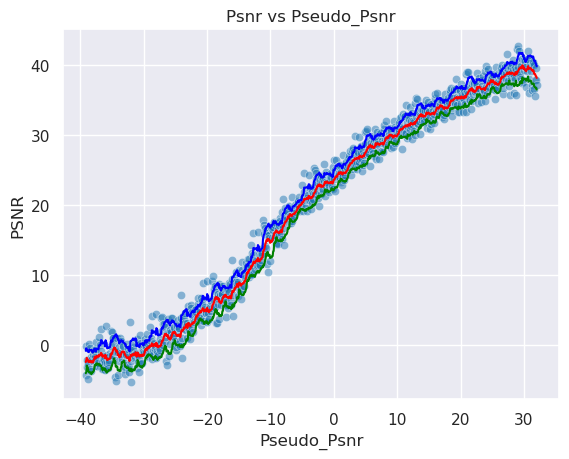

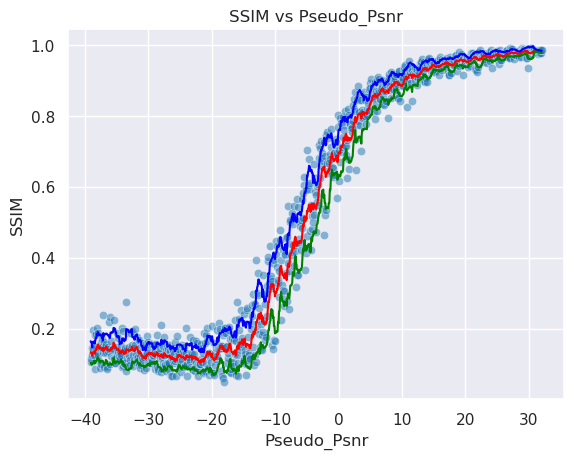

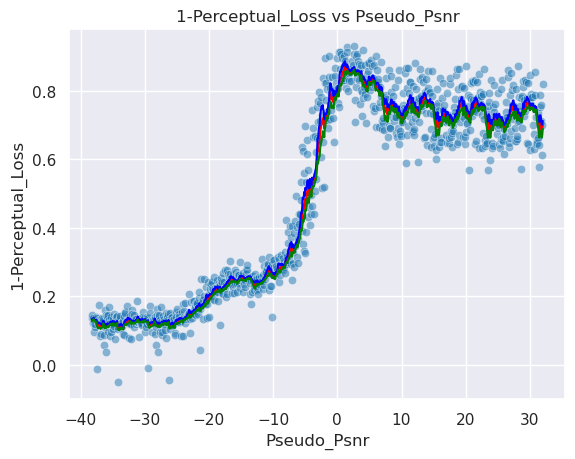

Psnr Area: 1349.1399012961638, SSIM Area: 38.546338925687174, Perceptual Area: 33.944495714082066
Mean Psnr 19.21620609200858
Std Psnr 14.579032614332048
Min Psnr -5.359474483568894
Max Psnr 42.696391557411744
Mean Roll Var 1.4865495635303394
Mean SSIM 0.5472642
Std SSIM 0.3649756908416748
Min SSIM 0.04855239391326904
Max SSIM 0.9899985194206238
Mean Roll SSIM 0.03952866822937334
Mean 1-PL 0.48686734
Std 1-PL 0.289903461933136
Min 1-PL -0.051528215408325195
Max 1-PL 0.9306047558784485
Mean Roll 1-PL 0.052761642022095635


(1349.1399012961638, 38.546338925687174, 33.944495714082066)

In [76]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Third Highest PSNR Range.
Plot_Creater(Psnr_Distribution_4, SSIM_Distribution_4, Perceptual_Distribution_4, minpsnr, maxpsnr)

In [77]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fourth Highest PSNR Range 
print(PSNR_Ranges[-4][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-4][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-4][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

0 32


(16384, 4096)

In [78]:
# Creates the directory to save the model in for the Fourth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-0-32"
CHECKPOINT_PATH = "./models/" 

In [79]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [80]:
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-0-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [81]:
# Loads the model from the checkpoint for the Fourth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [82]:
# Validates the trained model on the Train Set for the Fourth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1677279770374298    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1677279770374298}]

In [83]:
# Validates the trained model on the Validation Set for the Fourth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16866542398929596    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16866542398929596}]

3.90652 0.0 3.891200304031372 0.7200252413749695
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 13.228616714477539
13.230095715735821 13.230095322000077 0.0


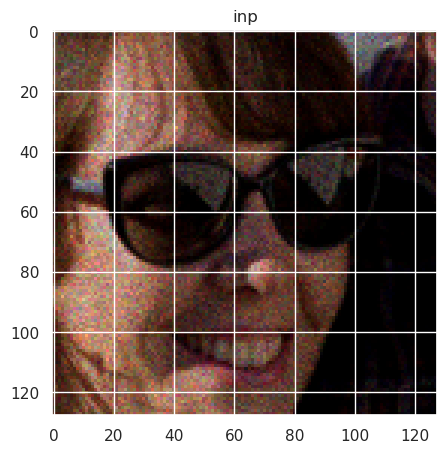

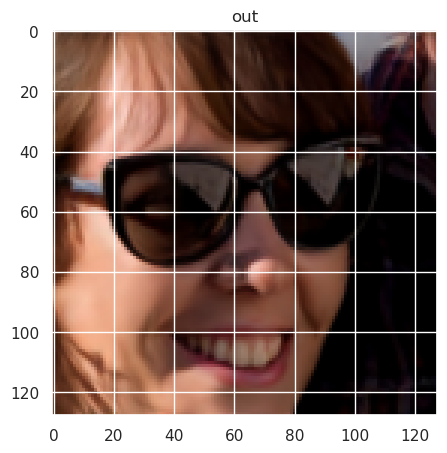

Text(0.5, 1.0, 'GT')

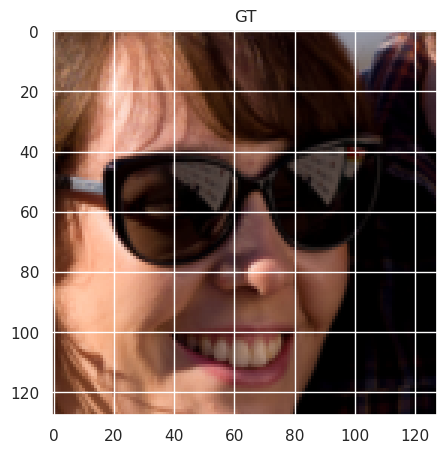

In [84]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

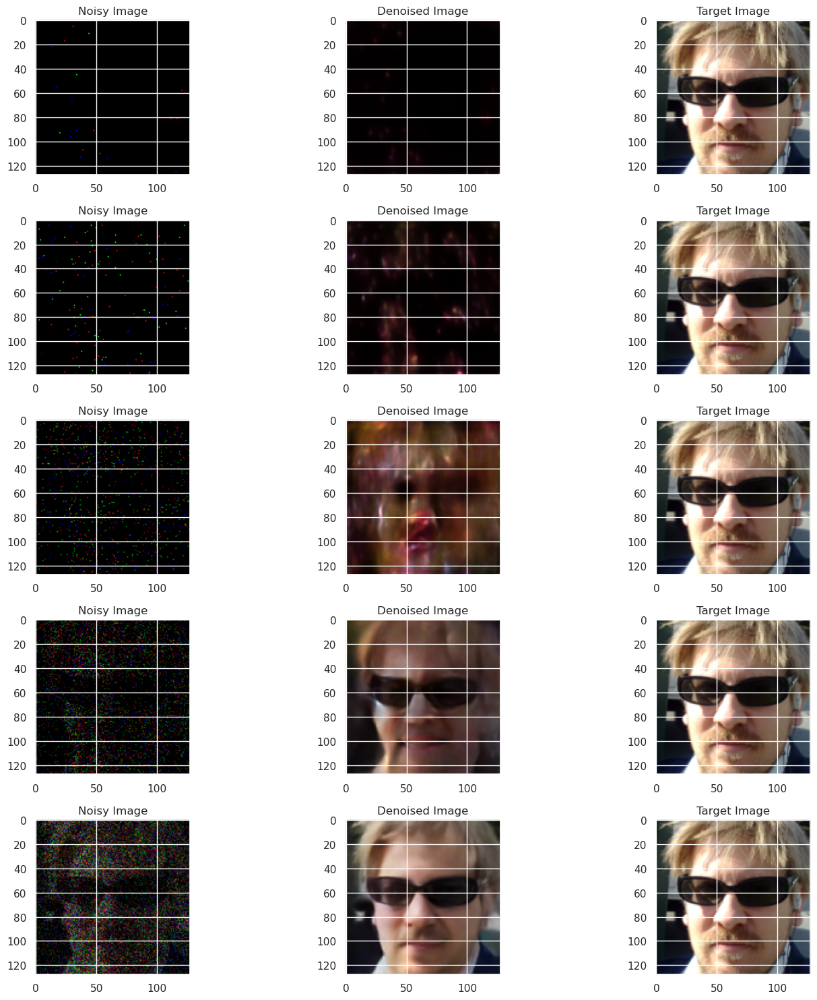

In [85]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

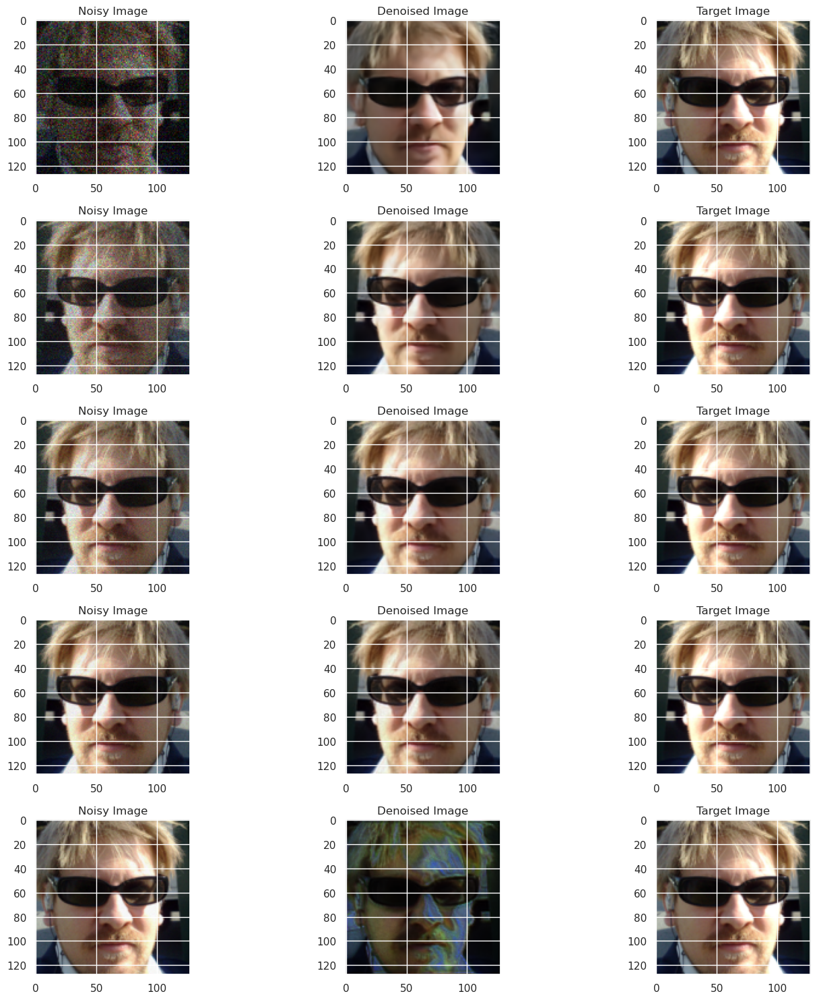

In [86]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [88]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fourth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_5 = np.array(Psnr_Distribution)
SSIM_Distribution_5 = np.array(SSIM_Distribution)
Perceptual_Distribution_5 = np.array(Perceptual_Distribution)
Psnr_Distribution_5.shape, SSIM_Distribution_5.shape, Perceptual_Distribution_5.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [89]:
np.save("Data/Psnr_Distribution_0_32.npy", Psnr_Distribution_5)
np.save("Data/SSIM_Distribution_0_32.npy", SSIM_Distribution_5)
np.save("Data/Perceptual_Distribution_0_32.npy", Perceptual_Distribution_5)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,20.940153,-3.559511,20.695712,1.496188,22.191900,19.199524
std,13.555281,20.564969,13.511871,0.395270,13.354744,13.678618
min,-3.784910,-39.119021,-1.704022,0.655177,-0.268221,-3.372686
25%,8.133458,-21.339266,8.203137,1.219662,9.736582,6.533018
50%,23.374692,-3.559511,23.144233,1.436635,24.558029,21.730436
75%,33.009978,14.220245,32.909687,1.720948,34.230467,31.686860
max,42.974840,32.000000,40.267259,2.722164,42.071046,38.479221


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.594941,-3.559511,0.589587,0.034352,0.623939,0.555235
std,0.353031,20.564969,0.351644,0.019780,0.343917,0.360294
min,0.040159,-39.119021,0.084676,0.002570,0.105222,0.047075
25%,0.178137,-21.339266,0.158658,0.019235,0.204946,0.110050
50%,0.731797,-3.559511,0.704885,0.031407,0.767239,0.649850
75%,0.935653,14.220245,0.934882,0.047811,0.953593,0.915153
max,0.990542,32.000000,0.985486,0.088158,0.995708,0.982574


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.492111,-3.119021,0.488427,0.050813,0.497487,0.479367
std,0.307486,20.310653,0.303691,0.020546,0.306366,0.301127
min,-0.051884,-38.238042,0.104469,0.010809,0.106643,0.100758
25%,0.141035,-20.678532,0.131203,0.030140,0.134577,0.127939
50%,0.645506,-3.119021,0.693785,0.052574,0.707273,0.674854
75%,0.774120,14.440489,0.755600,0.068358,0.764086,0.744408
max,0.937006,32.000000,0.887058,0.093019,0.894714,0.881212


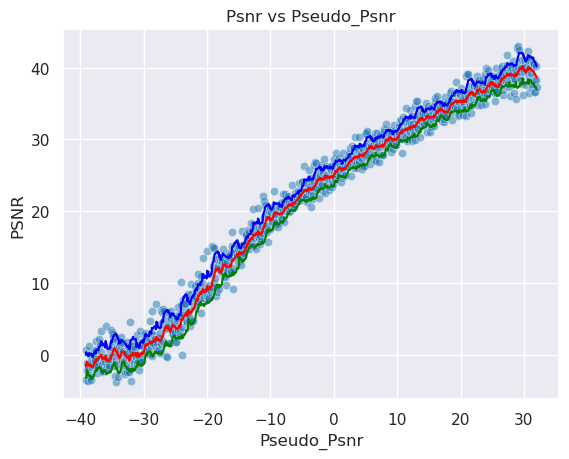

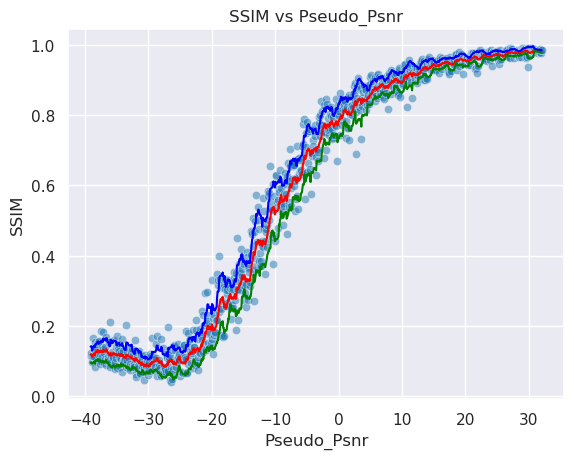

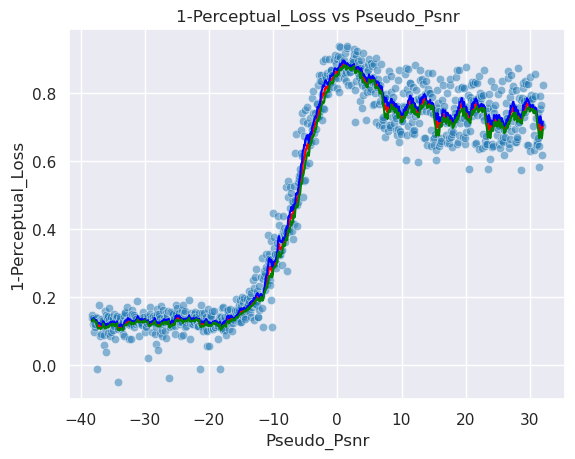

Psnr Area: 1472.0336923307843, SSIM Area: 41.93397695431952, Perceptual Area: 34.311894754414034
Mean Psnr 20.940153391460715
Std Psnr 13.555281343162894
Min Psnr -3.7849099447551113
Max Psnr 42.97483994193214
Mean Roll Var 1.4961877670227435
Mean SSIM 0.5949413
Std SSIM 0.3530312180519104
Min SSIM 0.04015929996967316
Max SSIM 0.9905417561531067
Mean Roll SSIM 0.034351860290037936
Mean 1-PL 0.49211052
Std 1-PL 0.30748555064201355
Min 1-PL -0.05188441276550293
Max 1-PL 0.9370057582855225
Mean Roll 1-PL 0.05081271205209185


(1472.0336923307843, 41.93397695431952, 34.311894754414034)

In [90]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fourth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_5, SSIM_Distribution_5, Perceptual_Distribution_5, minpsnr, maxpsnr)

In [91]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fifth Highest PSNR Range
print(PSNR_Ranges[-5][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-5][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-5][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-8 32


(16384, 4096)

In [92]:
# Creates the directory to save the model in for the Fifth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m8-32"
CHECKPOINT_PATH = "./models/" 

In [93]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [94]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-m8-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [95]:
# Loads the model from the checkpoint for the Fifth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [96]:
# # Validates the trained model on the Train Set for the Fifth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16710089147090912    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16710089147090912}]

In [97]:
# Validates the trained model on the Validation Set for the Fifth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16382546722888947    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16382546722888947}]

2.1577015 0.008461575 2.149240016937256 0.9392347931861877
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 11.888595581054688
11.890443248567868 11.890443248567868 0.0


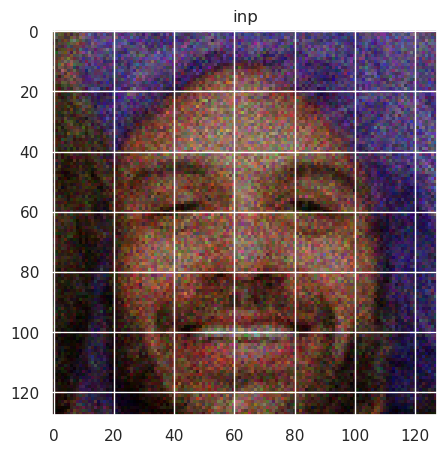

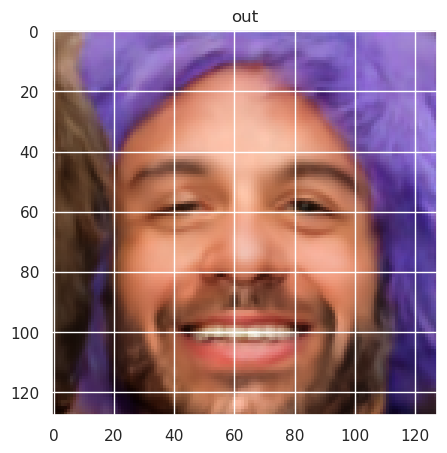

Text(0.5, 1.0, 'GT')

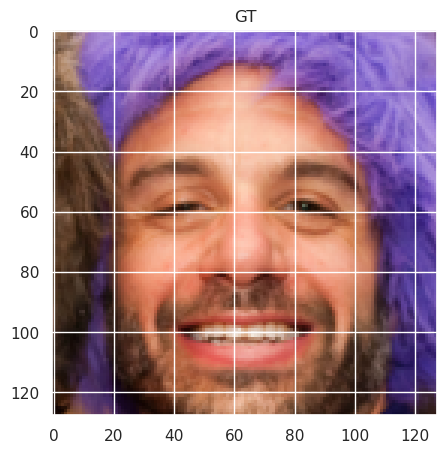

In [98]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image. 
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

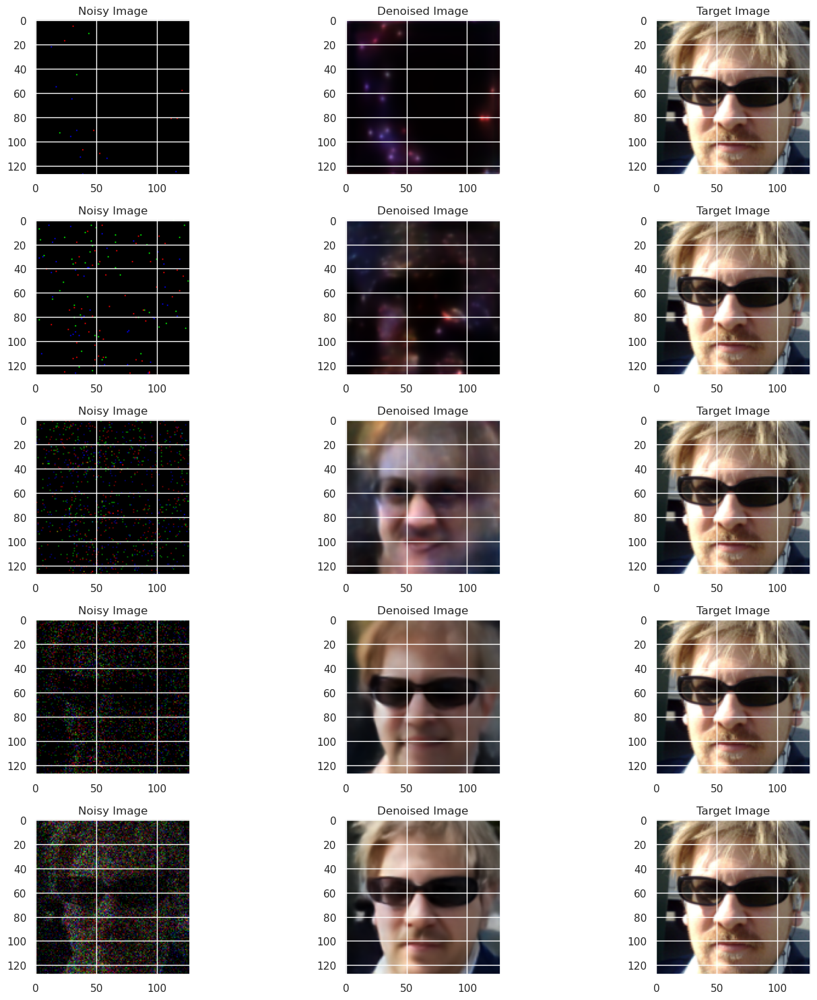

In [99]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

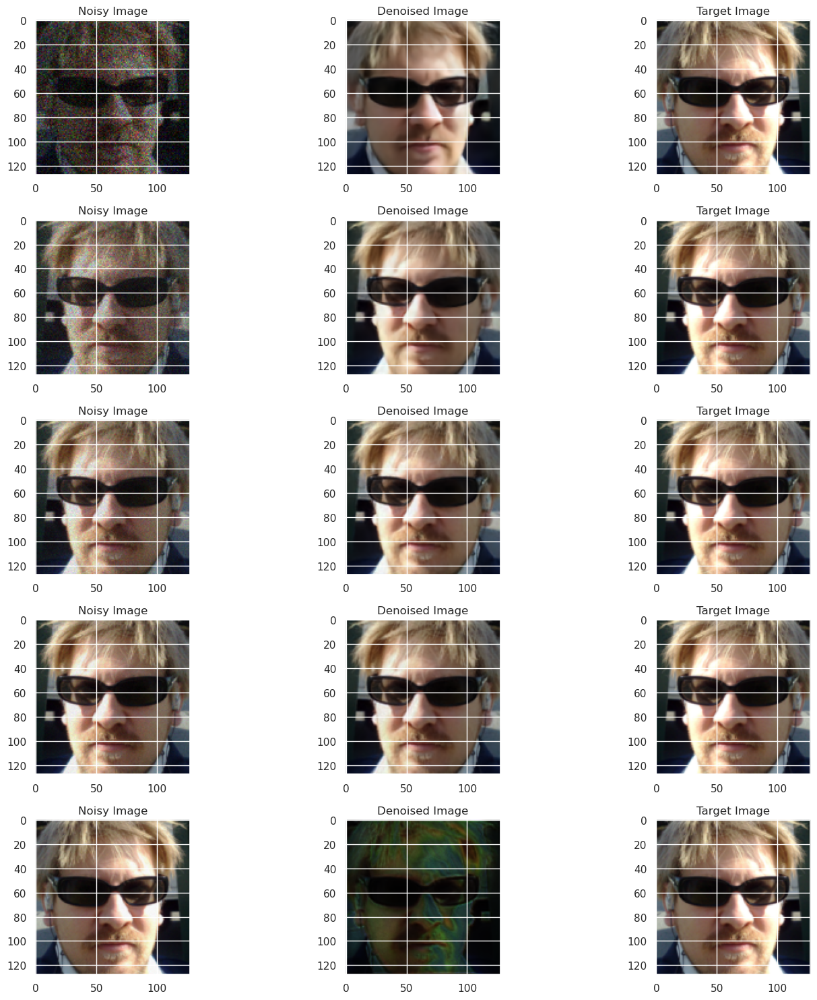

In [100]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [101]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fifth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_6 = np.array(Psnr_Distribution)
SSIM_Distribution_6 = np.array(SSIM_Distribution)
Perceptual_Distribution_6 = np.array(Perceptual_Distribution)
Psnr_Distribution_6.shape, SSIM_Distribution_6.shape, Perceptual_Distribution_6.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [102]:
np.save("Data/Psnr_Distribution_m8_32.npy", Psnr_Distribution_6)
np.save("Data/SSIM_Distribution_m8_32.npy", SSIM_Distribution_6)
np.save("Data/Perceptual_Distribution_m8_32.npy", Perceptual_Distribution_6)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,22.719779,-3.559511,22.497364,1.459394,23.956758,21.037970
std,11.965749,20.564969,11.914961,0.344884,11.775190,12.062976
min,-1.306066,-39.119021,1.735445,0.775355,3.359661,0.005297
25%,13.550999,-21.339266,13.203384,1.209851,14.299677,12.046660
50%,24.402454,-3.559511,24.205002,1.432687,25.696746,22.691728
75%,33.031543,14.220245,32.915356,1.671787,34.264609,31.687811
max,43.061593,32.000000,40.300652,2.520202,42.086972,38.565183


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.633667,-3.559511,0.628277,0.035376,0.663653,0.592902
std,0.329440,20.564969,0.328547,0.019621,0.320479,0.337564
min,0.042571,-39.119021,0.093944,0.002511,0.120219,0.067076
25%,0.295108,-21.339266,0.287242,0.019217,0.353821,0.219196
50%,0.757438,-3.559511,0.742659,0.033552,0.797418,0.689164
75%,0.935433,14.220245,0.934465,0.051847,0.953292,0.914578
max,0.991102,32.000000,0.985547,0.085531,0.992506,0.982569


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.483784,-3.119021,0.480094,0.051047,0.489185,0.471003
std,0.313973,20.310653,0.310114,0.020675,0.312800,0.307543
min,-0.052554,-38.238042,0.097162,0.010087,0.099677,0.091972
25%,0.130752,-20.678532,0.121570,0.031914,0.124877,0.118088
50%,0.642876,-3.119021,0.691333,0.053234,0.705240,0.672829
75%,0.771701,14.440489,0.754190,0.068439,0.763347,0.743837
max,0.939958,32.000000,0.887615,0.096609,0.896091,0.880945


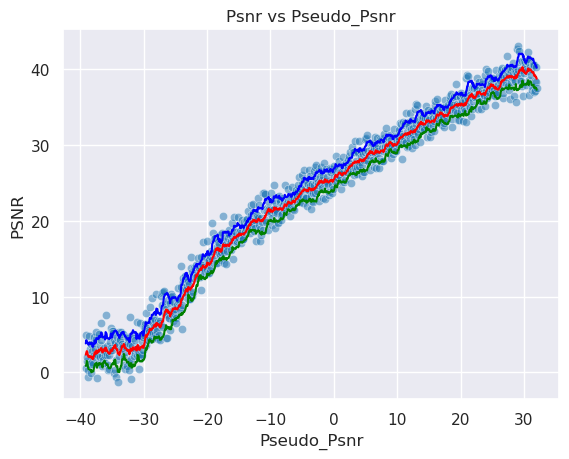

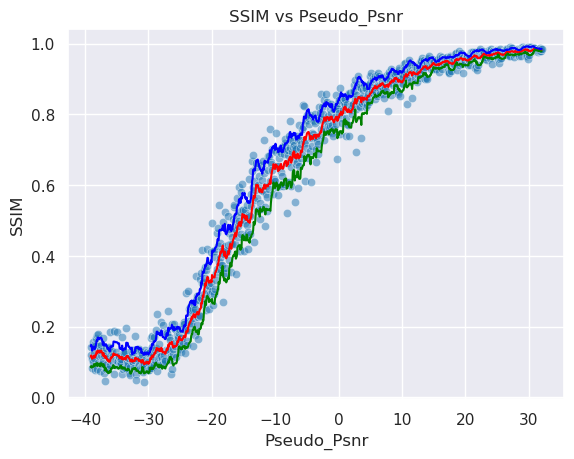

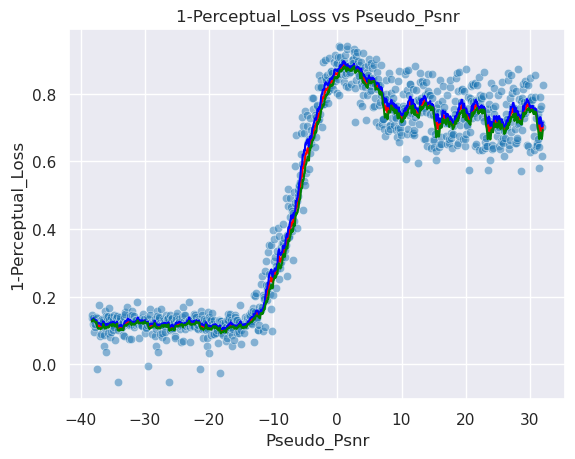

Psnr Area: 1600.1462183379053, SSIM Area: 44.68885302024006, Perceptual Area: 33.72594871172253
Mean Psnr 22.719778532710855
Std Psnr 11.965748699175201
Min Psnr -1.3060660554172387
Max Psnr 43.061592814757844
Mean Roll Var 1.459393991530175
Mean SSIM 0.6336672
Std SSIM 0.32943978905677795
Min SSIM 0.04257073625922203
Max SSIM 0.9911024570465088
Mean Roll SSIM 0.035375672471778
Mean 1-PL 0.48378372
Std 1-PL 0.3139728307723999
Min 1-PL -0.05255389213562012
Max 1-PL 0.9399582147598267
Mean Roll 1-PL 0.051047110840695395


(1600.1462183379053, 44.68885302024006, 33.72594871172253)

In [103]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fifth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_6, SSIM_Distribution_6, Perceptual_Distribution_6, minpsnr, maxpsnr)

In [104]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Sixth Highest PSNR Range
print(PSNR_Ranges[-6][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-6][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-6][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-16 32


(16384, 4096)

In [105]:
# Creates the directory to save the model in for the Sixth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m16-32"
CHECKPOINT_PATH = "./models/" 

In [106]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range. 
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [107]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-m16-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [108]:
# Loads the model from the checkpoint for the Sixth Highest PSNR Range. 
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [109]:
# Validates the trained model on the Train Set for the Sixth Highest PSNR Range. 
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1639409214258194    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1639409214258194}]

In [110]:
# Validates the trained model on the Validation Set for the Sixth Highest PSNR Range. 
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16050677001476288    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16050677001476288}]

2.5567155 0.020052671 2.556715488433838 0.9224228858947754
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 24.965885162353516
24.965763419711603 24.96576299727839 -7.76579119084255e-07


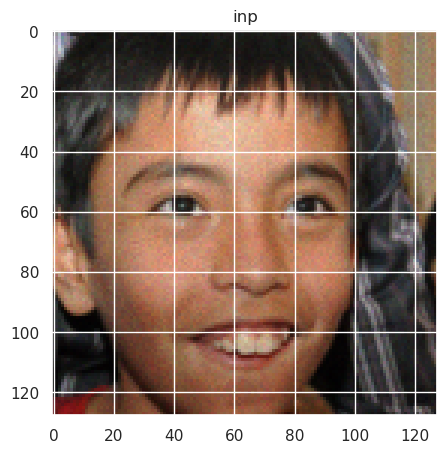

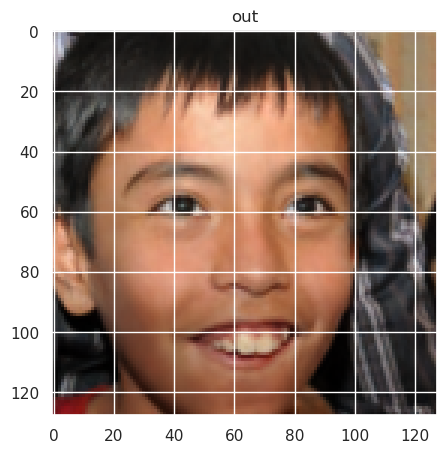

Text(0.5, 1.0, 'GT')

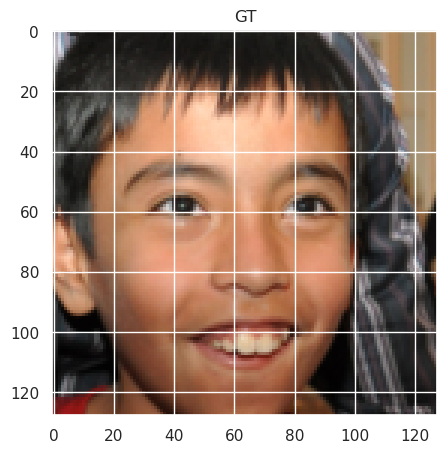

In [111]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

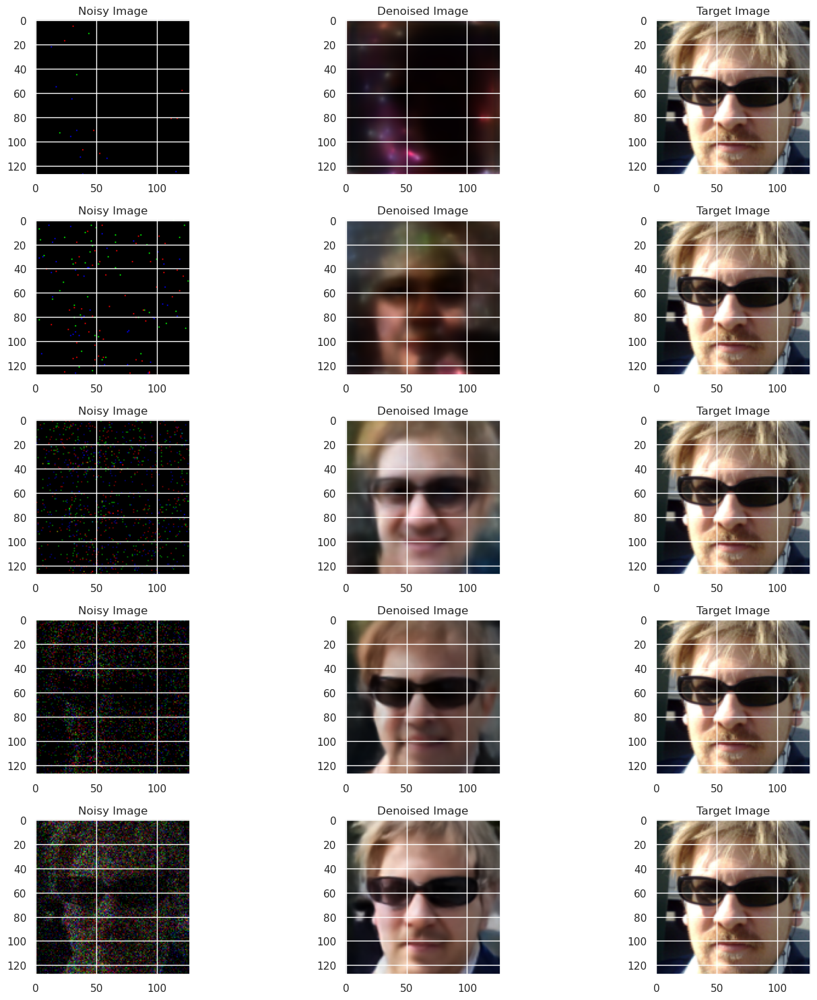

In [112]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

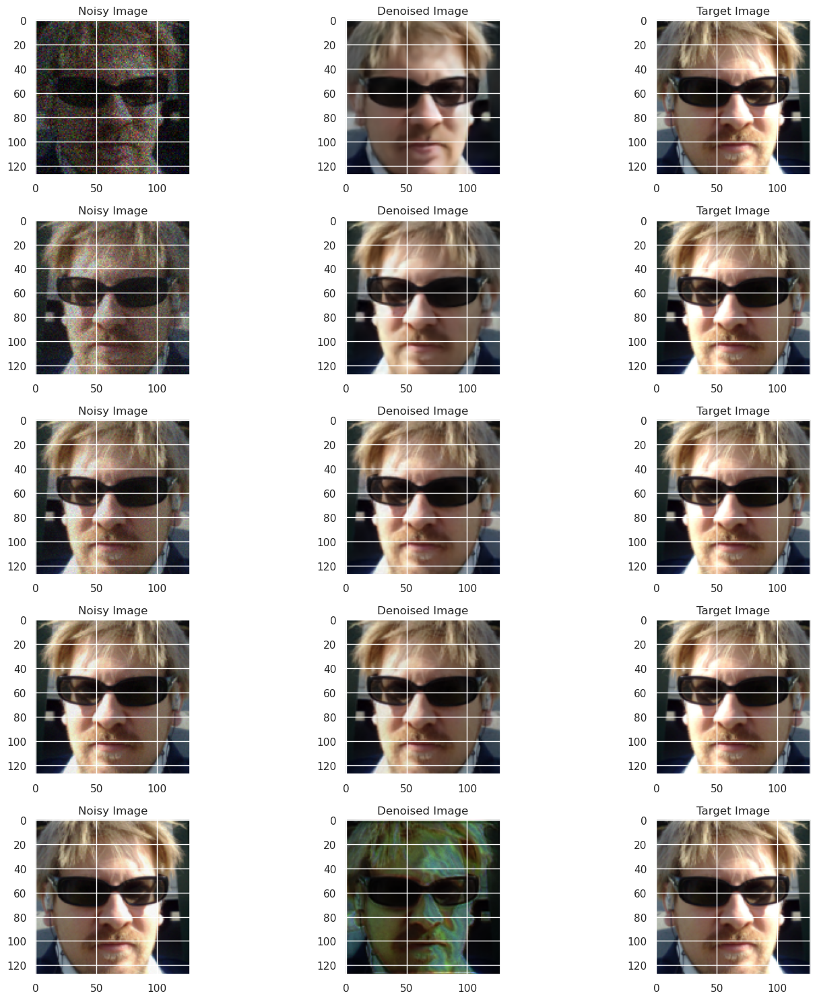

In [113]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [114]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Sixth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_7 = np.array(Psnr_Distribution)
SSIM_Distribution_7 = np.array(SSIM_Distribution)
Perceptual_Distribution_7 = np.array(Perceptual_Distribution)
Psnr_Distribution_7.shape, SSIM_Distribution_7.shape, Perceptual_Distribution_7.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during u

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [115]:
np.save("Data/Psnr_Distribution_m16_32.npy", Psnr_Distribution_7)
np.save("Data/SSIM_Distribution_m16_32.npy", SSIM_Distribution_7)
np.save("Data/Perceptual_Distribution_m16_32.npy", Perceptual_Distribution_7)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,23.549063,-3.559511,23.348780,1.460663,24.809443,21.888117
std,10.500129,20.564969,10.441584,0.382960,10.290368,10.604479
min,0.539978,-39.119021,3.578779,0.685594,5.321389,1.677474
25%,15.705582,-21.339266,15.932672,1.175682,16.845321,14.800793
50%,24.334386,-3.559511,24.098999,1.390971,25.565170,22.582990
75%,32.597306,14.220245,32.566742,1.695639,34.001390,31.297618
max,42.166485,32.000000,39.274235,2.659940,41.125097,37.519123


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.661731,-3.559511,0.656417,0.038778,0.695195,0.617638
std,0.295093,20.564969,0.294026,0.020949,0.283342,0.305773
min,0.066260,-39.119021,0.114915,0.002815,0.140296,0.077448
25%,0.409973,-21.339266,0.409669,0.020053,0.465420,0.352718
50%,0.752745,-3.559511,0.738382,0.039938,0.794977,0.685871
75%,0.932707,14.220245,0.931140,0.054031,0.953712,0.908043
max,0.990637,32.000000,0.984412,0.092813,0.992364,0.981197


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.484411,-3.119021,0.480728,0.051894,0.489906,0.471549
std,0.314005,20.310653,0.310020,0.020823,0.312673,0.307484
min,-0.054577,-38.238042,0.094407,0.011047,0.097038,0.089266
25%,0.131333,-20.678532,0.122491,0.033416,0.125820,0.119110
50%,0.642747,-3.119021,0.692631,0.053951,0.705750,0.673074
75%,0.770744,14.440489,0.754354,0.068886,0.762709,0.743875
max,0.940598,32.000000,0.888974,0.097964,0.897654,0.882815


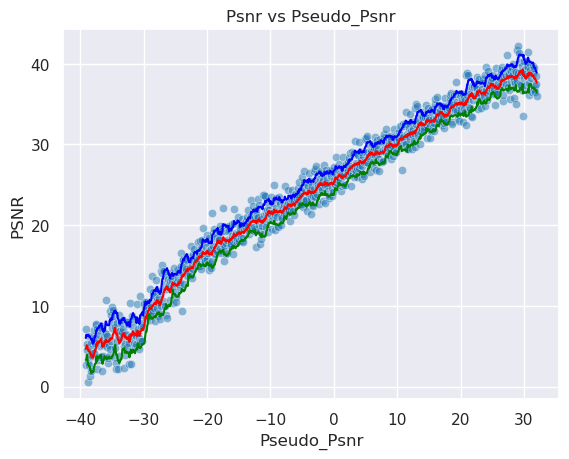

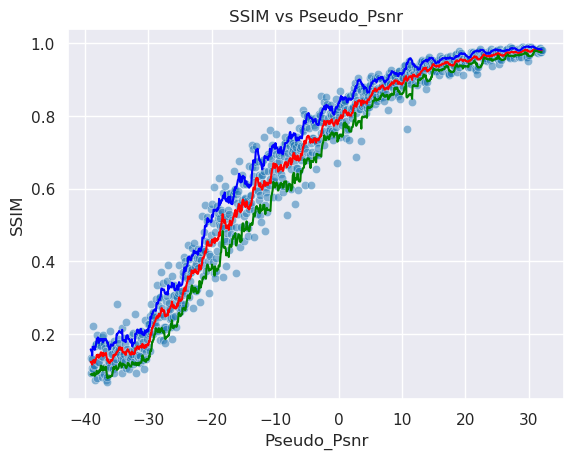

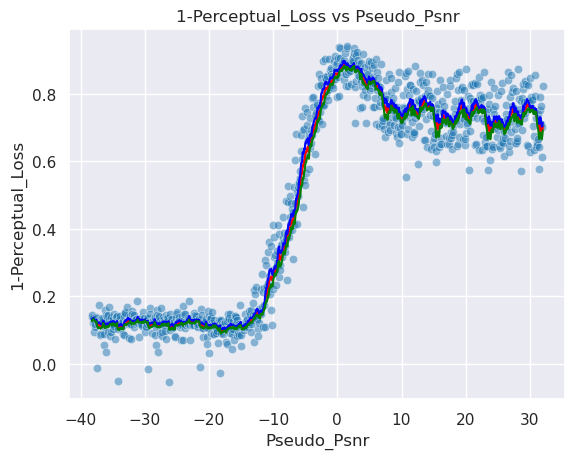

Psnr Area: 1660.7175275019993, SSIM Area: 46.69213352569517, Perceptual Area: 33.77052313759012
Mean Psnr 23.549062539552057
Std Psnr 10.500128575788302
Min Psnr 0.5399777217634165
Max Psnr 42.16648461150083
Mean Roll Var 1.4606631831162125
Mean SSIM 0.66173106
Std SSIM 0.2950930893421173
Min SSIM 0.06625968217849731
Max SSIM 0.9906371235847473
Mean Roll SSIM 0.03877827757638456
Mean 1-PL 0.48441052
Std 1-PL 0.3140048086643219
Min 1-PL -0.05457663536071777
Max 1-PL 0.9405982494354248
Mean Roll 1-PL 0.051894097856446234


(1660.7175275019993, 46.69213352569517, 33.77052313759012)

In [116]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Sixth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_7, SSIM_Distribution_7, Perceptual_Distribution_7, minpsnr, maxpsnr)

In [117]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Seventh Highest PSNR Range
print(PSNR_Ranges[-7][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-7][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-7][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-24 32


(16384, 4096)

In [118]:
# Creates the directory to save the model in for the Seventh Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m24-32"
CHECKPOINT_PATH = "./models/" 

In [119]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [120]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-m24-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [121]:
# Loads the model from the checkpoint for the Seventh Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [122]:
# Validates the trained model on the Train Set for the Seventh Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.15618211030960083    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.15618211030960083}]

In [123]:
# Validates the trained model on the Validation Set for the Seventh Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1527632623910904    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1527632623910904}]

2.6532989 0.021141823 2.5581605434417725 0.8985275030136108
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -16.795625686645508
-16.766008442224628 -16.766008442224628 0.0


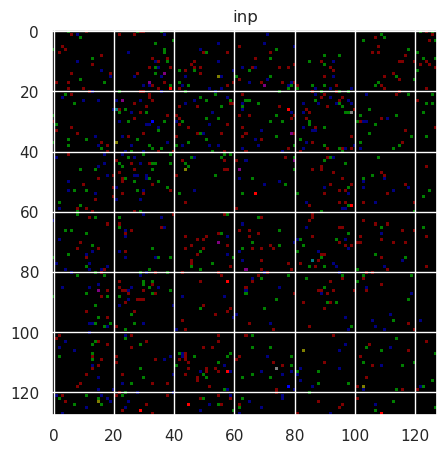

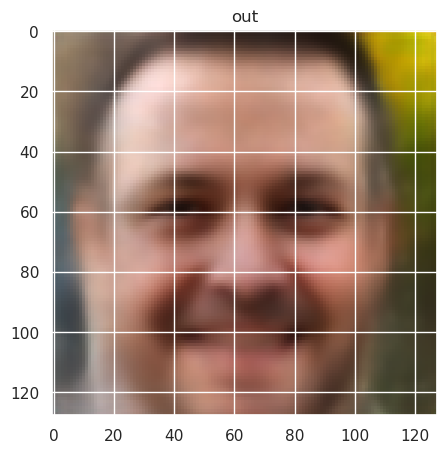

Text(0.5, 1.0, 'GT')

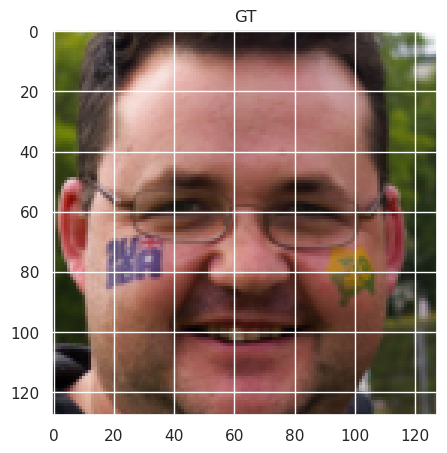

In [124]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

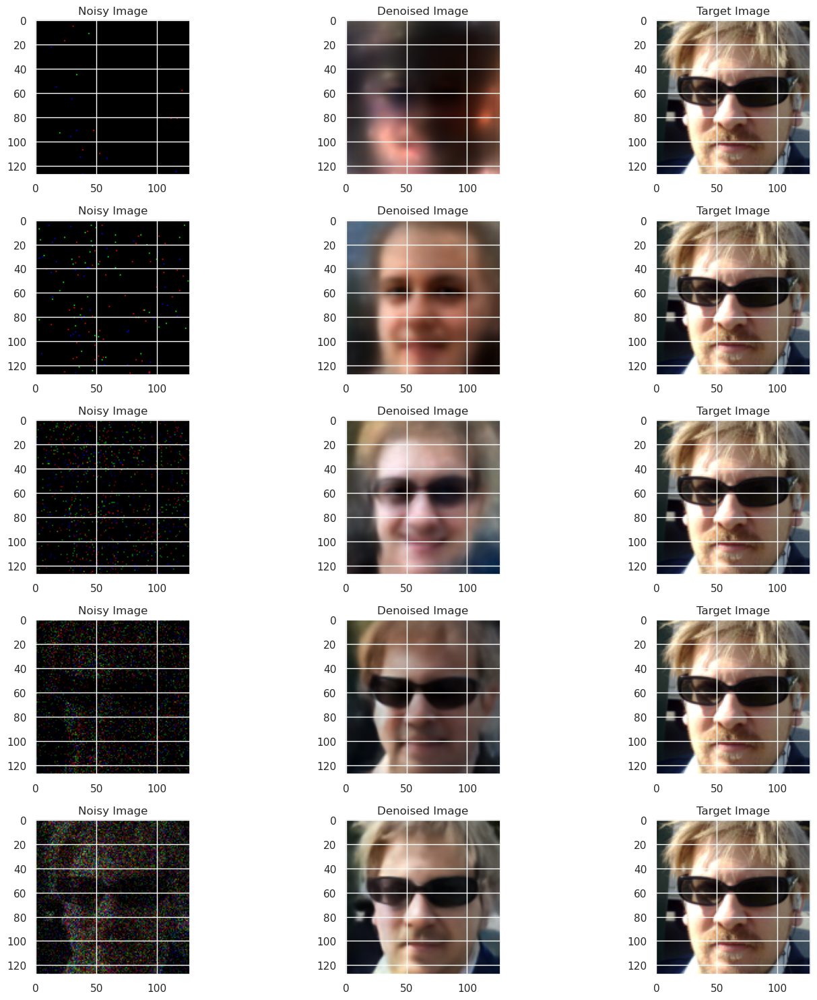

In [125]:
# Plots for a sample image the Noisy Image, its corresponding denoised image and the Target Image.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

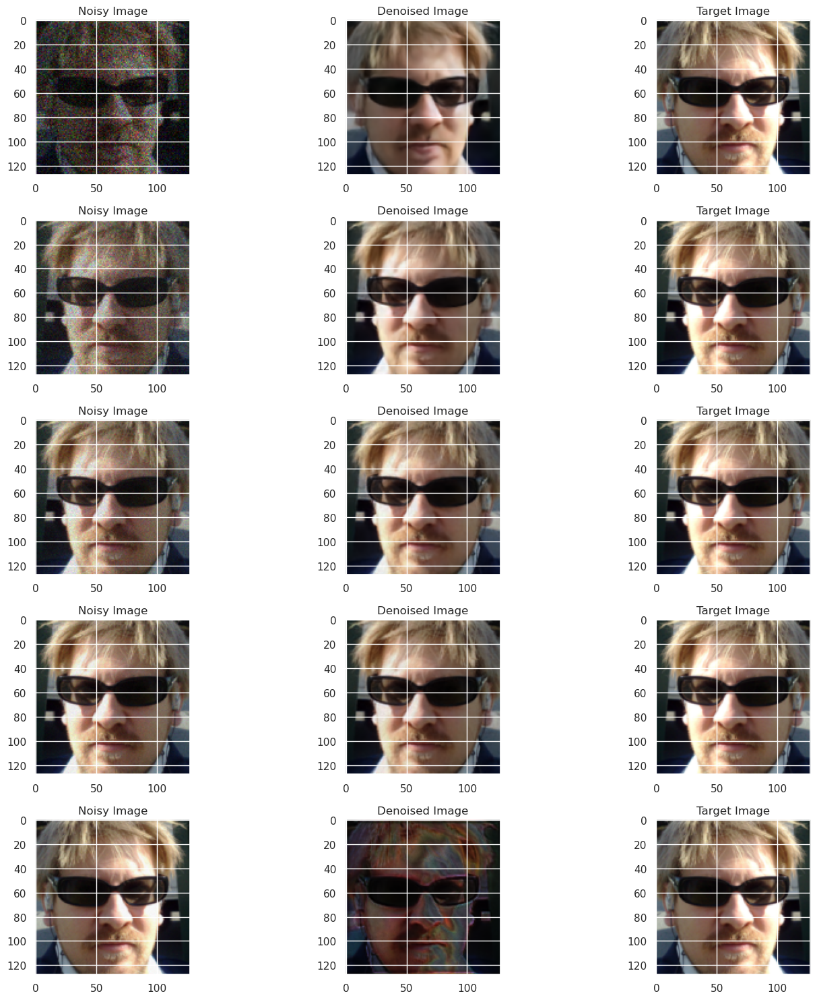

In [126]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [127]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Seventh Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_8 = np.array(Psnr_Distribution)
SSIM_Distribution_8 = np.array(SSIM_Distribution)
Perceptual_Distribution_8 = np.array(Perceptual_Distribution)
Psnr_Distribution_8.shape, SSIM_Distribution_8.shape, Perceptual_Distribution_8.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [128]:
np.save("Data/Psnr_Distribution_m24_32.npy", Psnr_Distribution_8)
np.save("Data/SSIM_Distribution_m24_32.npy", SSIM_Distribution_8)
np.save("Data/Perceptual_Distribution_m24_32.npy", Perceptual_Distribution_8)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.444025,-3.559511,24.274868,1.435577,25.710445,22.839291
std,9.069158,20.564969,8.968381,0.364833,8.932538,9.018853
min,6.698888,-39.119021,8.965176,0.772774,10.388645,7.541708
25%,17.031929,-21.339266,16.934396,1.203843,18.300256,15.405295
50%,24.212626,-3.559511,23.990460,1.375314,25.490849,22.560032
75%,32.473319,14.220245,32.387431,1.591312,33.916572,30.987210
max,42.103633,32.000000,39.307743,3.054780,41.573631,37.570291


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.688720,-3.559511,0.684030,0.042186,0.726216,0.641844
std,0.253885,20.564969,0.251303,0.022884,0.235279,0.268323
min,0.128080,-39.119021,0.209001,0.002955,0.239334,0.172856
25%,0.470169,-21.339266,0.452835,0.020376,0.525875,0.384759
50%,0.752171,-3.559511,0.733804,0.045345,0.790908,0.681536
75%,0.930287,14.220245,0.930255,0.060369,0.951959,0.909077
max,0.990282,32.000000,0.983582,0.089513,0.994207,0.980219


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.481705,-3.119021,0.478009,0.051729,0.487110,0.468909
std,0.312253,20.310653,0.308238,0.020628,0.310899,0.305692
min,-0.052830,-38.238042,0.096415,0.011015,0.098966,0.091240
25%,0.131499,-20.678532,0.123348,0.033316,0.127032,0.119891
50%,0.642837,-3.119021,0.689627,0.053582,0.704752,0.671339
75%,0.769028,14.440489,0.752851,0.068170,0.760768,0.742368
max,0.937285,32.000000,0.880862,0.096274,0.888931,0.874786


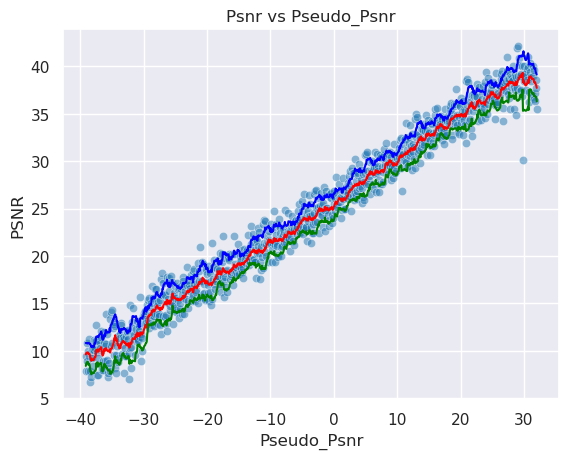

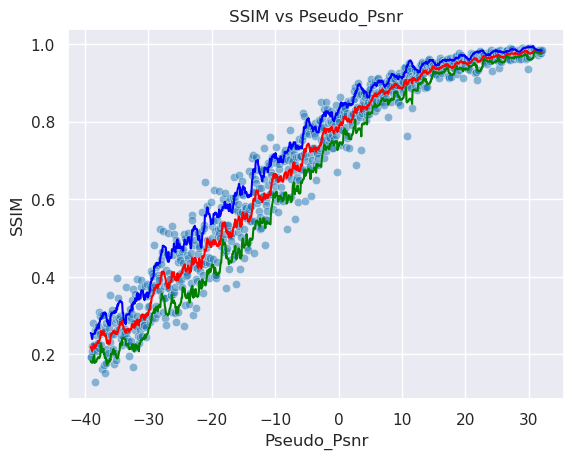

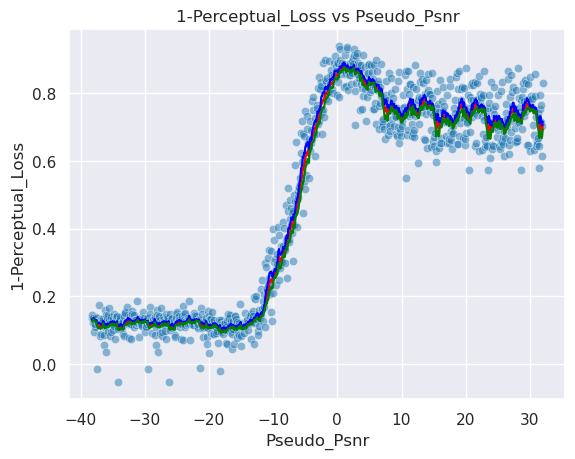

Psnr Area: 1726.4529654693615, SSIM Area: 48.65433480803574, Perceptual Area: 33.57931505950857
Mean Psnr 24.44402544190185
Std Psnr 9.069157599330556
Min Psnr 6.698888297645347
Max Psnr 42.10363342318885
Mean Roll Var 1.4355771364871386
Mean SSIM 0.6887201
Std SSIM 0.2538846731185913
Min SSIM 0.12807995080947876
Max SSIM 0.9902815818786621
Mean Roll SSIM 0.04218612465715663
Mean 1-PL 0.48170528
Std 1-PL 0.312252938747406
Min 1-PL -0.052829742431640625
Max 1-PL 0.9372848272323608
Mean Roll 1-PL 0.051728596237115614


(1726.4529654693615, 48.65433480803574, 33.57931505950857)

In [129]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Seventh Highest PSNR Range.
Plot_Creater(Psnr_Distribution_8, SSIM_Distribution_8, Perceptual_Distribution_8, minpsnr, maxpsnr)

In [130]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Eighth Highest PSNR Range
print(PSNR_Ranges[-8][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-8][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-8][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-32 32


(16384, 4096)

In [131]:
# Creates the directory to save the model in for the Eighth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m32-32"
CHECKPOINT_PATH = "./models/" 

In [132]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [133]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-m32-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [134]:
# Loads the model from the checkpoint for the Eighth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14729127287864685    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14729127287864685}]

In [135]:
# Validates the trained model on the Train Set for the Eighth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14720633625984192    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14720633625984192}]

In [136]:
# Validates the trained model on the Validation Set for the Eighth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

2.4319644 0.05722269 2.43196439743042 1.0395455360412598
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 19.171245574951172
19.168603230705624 19.168603230705624 0.0


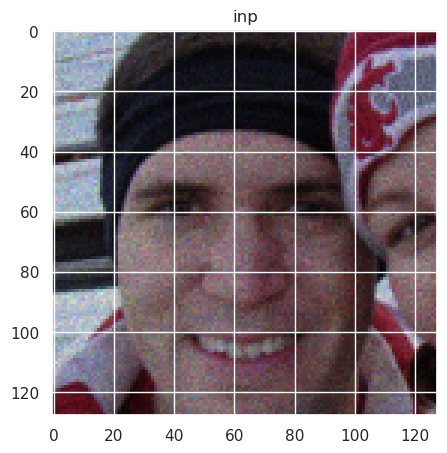

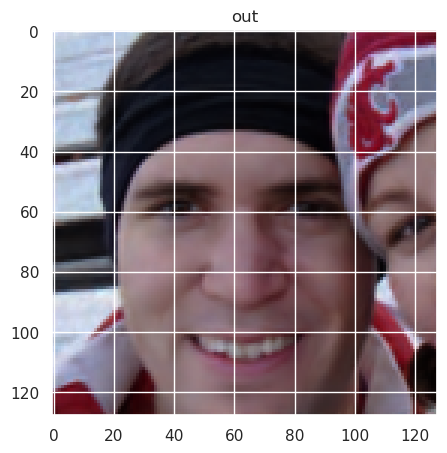

Text(0.5, 1.0, 'GT')

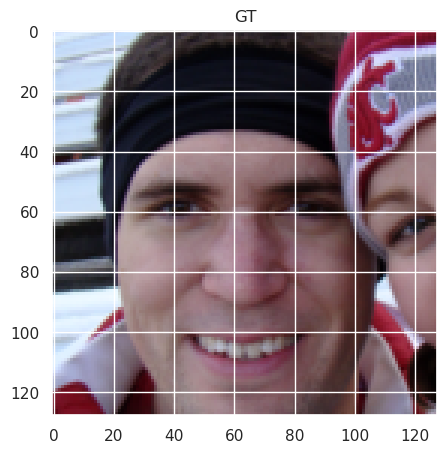

In [137]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

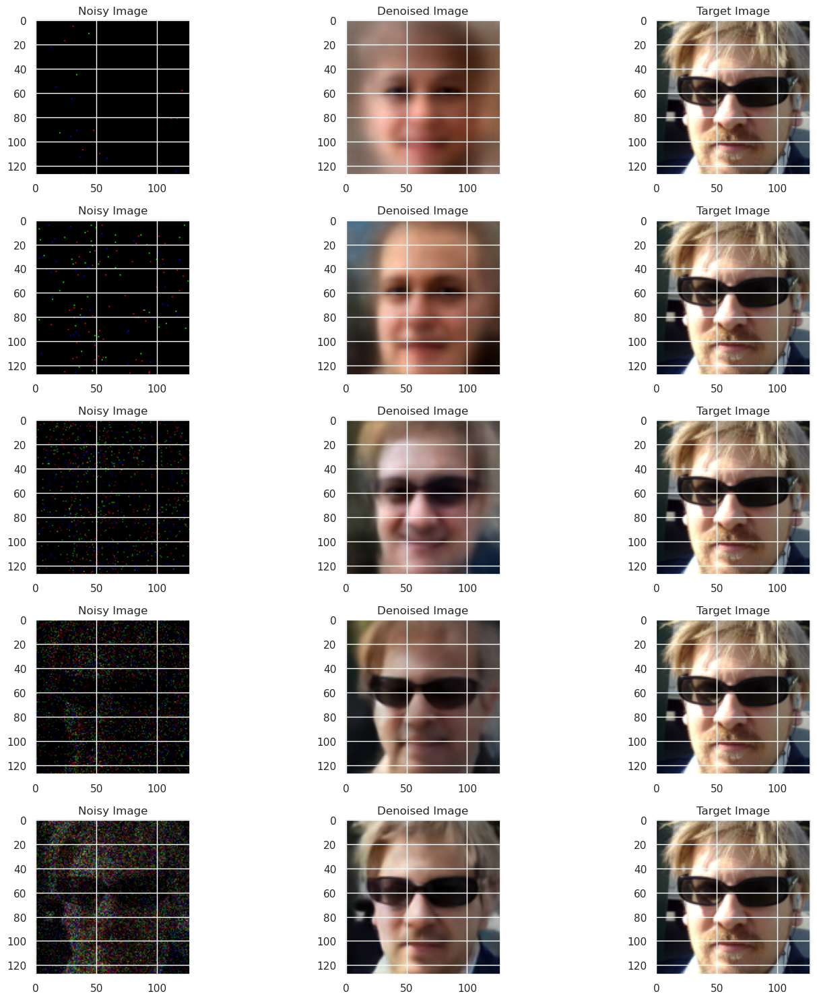

In [138]:
# # Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

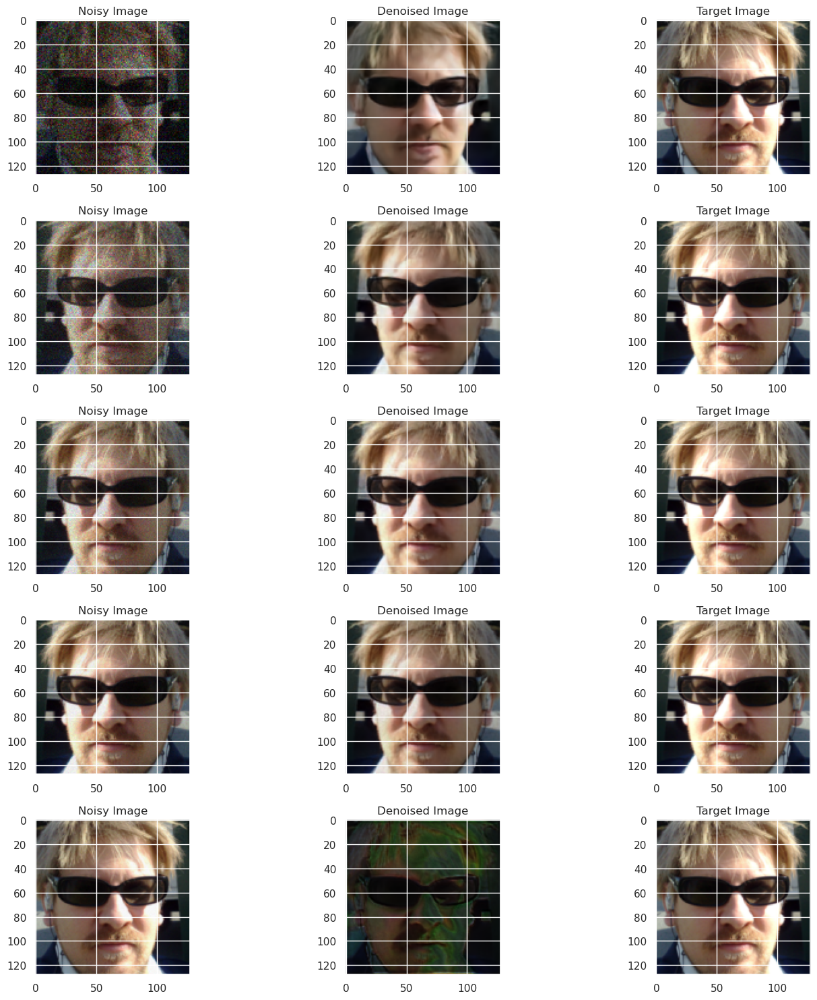

In [139]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [140]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Eighth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)
    
Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_9 = np.array(Psnr_Distribution)
SSIM_Distribution_9 = np.array(SSIM_Distribution)
Perceptual_Distribution_9 = np.array(Perceptual_Distribution)
Psnr_Distribution_9.shape, SSIM_Distribution_9.shape, Perceptual_Distribution_9.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [141]:
np.save("Data/Psnr_Distribution_m32_32.npy", Psnr_Distribution_9)
np.save("Data/SSIM_Distribution_m32_32.npy", SSIM_Distribution_9)
np.save("Data/Perceptual_Distribution_m32_32.npy", Perceptual_Distribution_9)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.900102,-3.559511,24.752018,1.443275,26.195293,23.308744
std,8.459360,20.564969,8.326313,0.332578,8.302850,8.362948
min,9.688631,-39.119021,12.921447,0.759630,14.162559,11.290475
25%,17.043985,-21.339266,17.006836,1.208232,18.307463,15.451413
50%,24.358179,-3.559511,24.029488,1.397169,25.510389,22.506888
75%,32.409700,14.220245,32.391135,1.626809,33.856686,31.103319
max,42.344877,32.000000,39.606929,2.658665,41.609727,37.751228


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.701854,-3.559511,0.697941,0.045664,0.743605,0.652277
std,0.231952,20.564969,0.227226,0.025025,0.205302,0.249734
min,0.181686,-39.119021,0.324206,0.003120,0.388109,0.258404
25%,0.482224,-21.339266,0.456505,0.020906,0.521521,0.394994
50%,0.746805,-3.559511,0.732683,0.049200,0.786334,0.680897
75%,0.929072,14.220245,0.928836,0.066994,0.951196,0.907133
max,0.989800,32.000000,0.983376,0.095651,0.992733,0.979922


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.481704,-3.119021,0.478027,0.051985,0.487206,0.468848
std,0.312777,20.310653,0.308720,0.021019,0.311428,0.306130
min,-0.053210,-38.238042,0.095840,0.011006,0.098517,0.090914
25%,0.131905,-20.678532,0.123519,0.033058,0.127101,0.120101
50%,0.639422,-3.119021,0.687901,0.054309,0.704064,0.670653
75%,0.767110,14.440489,0.752453,0.068983,0.760445,0.741516
max,0.935394,32.000000,0.886338,0.097667,0.893825,0.879815


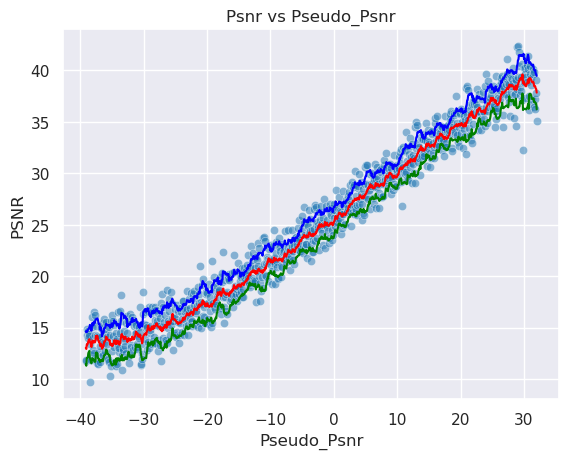

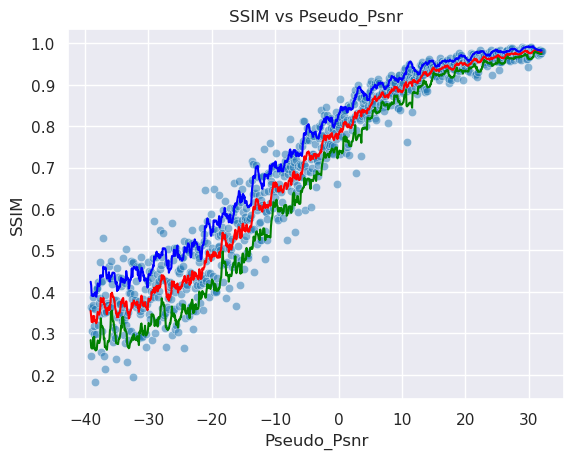

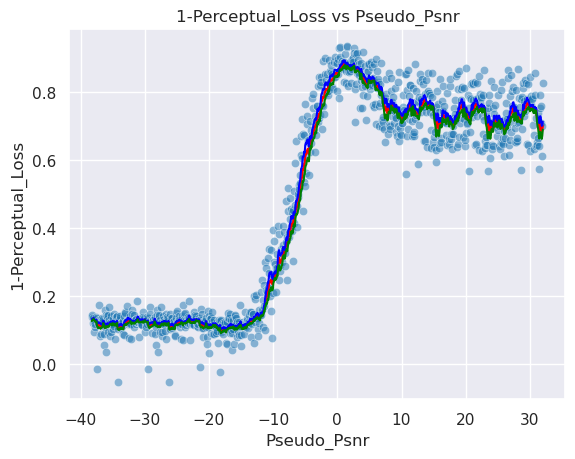

Psnr Area: 1760.2846796382964, SSIM Area: 49.63944387548625, Perceptual Area: 33.58066559620243
Mean Psnr 24.90010187756599
Std Psnr 8.459359793453919
Min Psnr 9.688631250862507
Max Psnr 42.34487687579018
Mean Roll Var 1.4432745737993318
Mean SSIM 0.7018544
Std SSIM 0.23195195198059082
Min SSIM 0.18168552219867706
Max SSIM 0.989799976348877
Mean Roll SSIM 0.045663866458630964
Mean 1-PL 0.48170388
Std 1-PL 0.3127765357494354
Min 1-PL -0.053209543228149414
Max 1-PL 0.9353938102722168
Mean Roll 1-PL 0.051985450062344486


(1760.2846796382964, 49.63944387548625, 33.58066559620243)

In [142]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Eighth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_9, SSIM_Distribution_9, Perceptual_Distribution_9, minpsnr, maxpsnr)

In [143]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

In [144]:
# Creates the directory to save the model in for the Ninth Highest PSNR Range.
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [145]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)],
                    enable_checkpointing=False)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [146]:
try:
    Trainer.fit(model, Train_Loader, Validation_Loader)
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')
except OSError:
    Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationProgressiveUNet128x128-m40-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode
-------------------------------------------------
0 | conv_final | Conv2d     | 153    | eval
1 | down_convs | ModuleList | 76.8 M | eval
2 | up_convs   | ModuleList | 32.4 M | eval
-------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [147]:
# Loads the model from the checkpoint for the Ninth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [148]:
# Validates the trained model on the Train Set for the Ninth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1355423927307129    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1355423927307129}]

In [149]:
# Validates the trained model on the Validation Set for the Ninth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1340816468000412    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1340816468000412}]

1.8089103 0.07203625 1.7608860731124878 0.9604833126068115
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -24.304420471191406
-24.435679276535925 -24.435678995738993 0.0


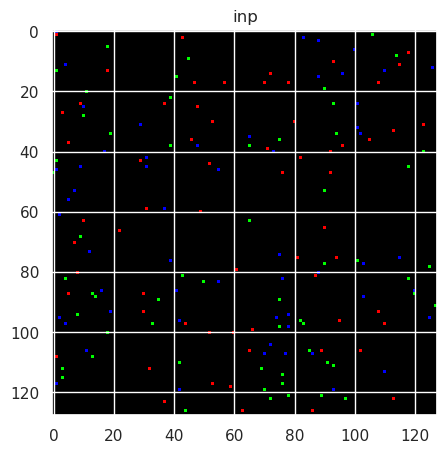

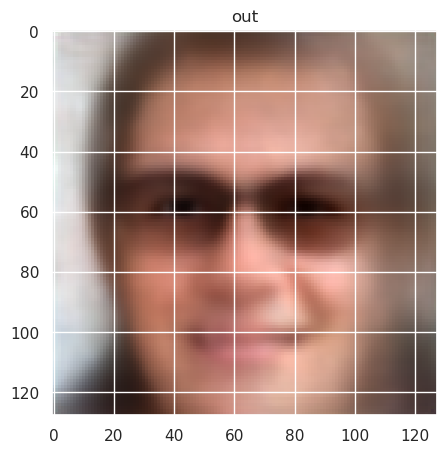

Text(0.5, 1.0, 'GT')

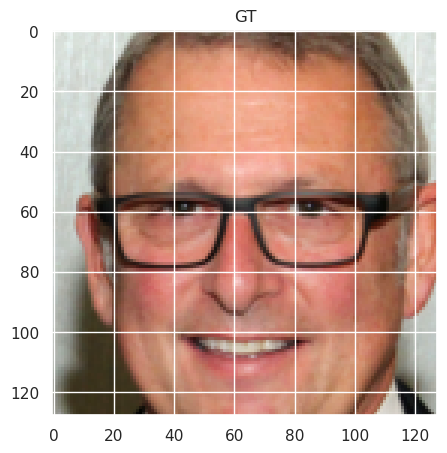

In [150]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

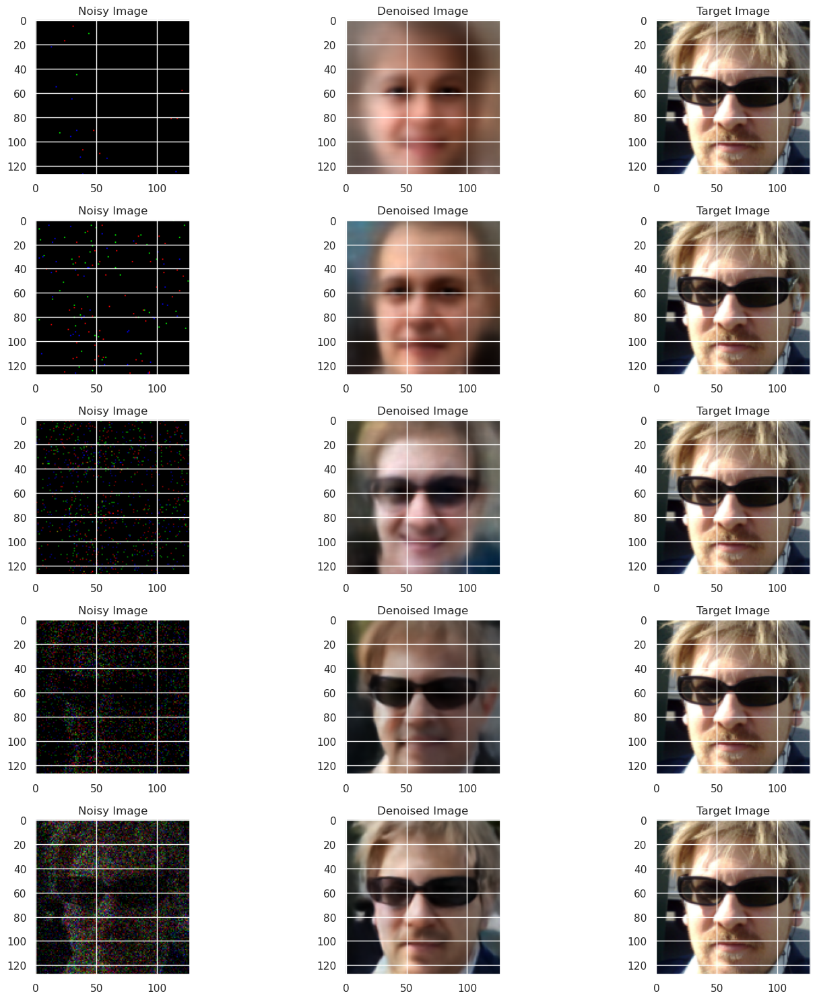

In [151]:
# Plots for a sample image the Noisy Image, its corresponding denoised image and the Target Image.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

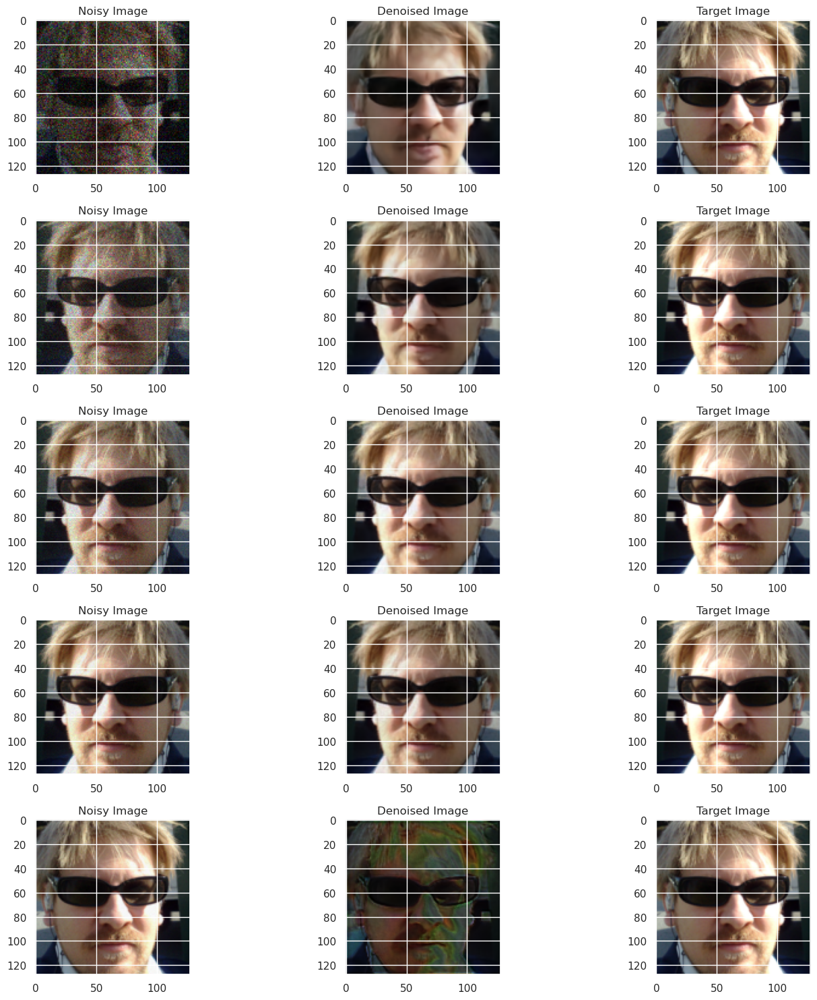

In [152]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [153]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Ninth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_10 = np.array(Psnr_Distribution)
SSIM_Distribution_10 = np.array(SSIM_Distribution)
Perceptual_Distribution_10 = np.array(Perceptual_Distribution)
Psnr_Distribution_10.shape, SSIM_Distribution_10.shape, Perceptual_Distribution_10.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [154]:
np.save("Data/Psnr_Distribution_m40_32.npy", Psnr_Distribution_10)
np.save("Data/SSIM_Distribution_m40_32.npy", SSIM_Distribution_10)
np.save("Data/Perceptual_Distribution_m40_32.npy", Perceptual_Distribution_10)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,24.968161,-3.559511,24.819464,1.441148,26.260612,23.378316
std,8.510095,20.564969,8.374373,0.312003,8.345447,8.414776
min,9.737091,-39.119021,13.035003,0.783395,14.274246,11.381798
25%,17.128278,-21.339266,17.071709,1.214722,18.405350,15.526596
50%,24.198618,-3.559511,24.067920,1.419496,25.524386,22.561903
75%,32.516467,14.220245,32.549511,1.616529,33.930837,31.314579
max,42.684962,32.000000,39.773384,2.473116,41.728144,37.845191


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.702550,-3.559511,0.698686,0.046087,0.744772,0.652599
std,0.231611,20.564969,0.226688,0.025516,0.204037,0.249893
min,0.195042,-39.119021,0.328582,0.002989,0.396672,0.258376
25%,0.481903,-21.339266,0.457178,0.021189,0.528814,0.394663
50%,0.746348,-3.559511,0.731810,0.050624,0.786138,0.680007
75%,0.928132,14.220245,0.929157,0.067617,0.951299,0.907504
max,0.990199,32.000000,0.983577,0.102216,0.991756,0.980081


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.482428,-3.119021,0.478745,0.051986,0.487909,0.469582
std,0.313128,20.310653,0.309081,0.021005,0.311775,0.306505
min,-0.052750,-38.238042,0.095657,0.010982,0.098313,0.090742
25%,0.131541,-20.678532,0.123388,0.033473,0.126959,0.119890
50%,0.638462,-3.119021,0.689249,0.054315,0.702920,0.669666
75%,0.769265,14.440489,0.751797,0.069384,0.760659,0.741720
max,0.937761,32.000000,0.887501,0.099488,0.896261,0.880893


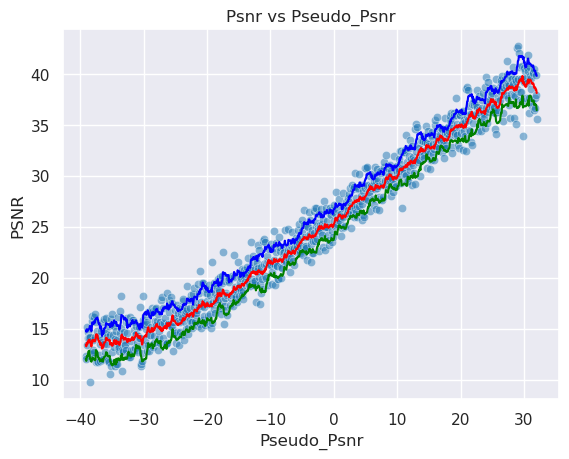

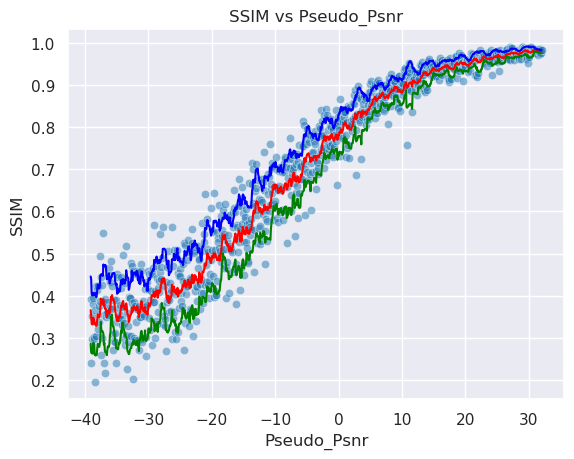

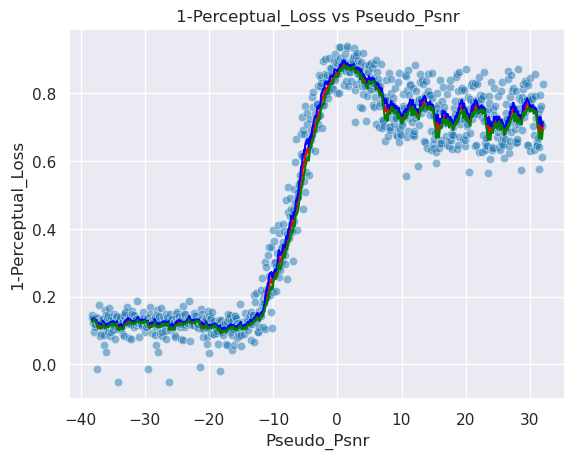

Psnr Area: 1765.0611865521332, SSIM Area: 49.6919333021487, Perceptual Area: 33.63114440925129
Mean Psnr 24.968160625588677
Std Psnr 8.510094922703633
Min Psnr 9.737090593889086
Max Psnr 42.684962499657566
Mean Roll Var 1.4411481489200502
Mean SSIM 0.70255023
Std SSIM 0.23161110281944275
Min SSIM 0.19504201412200928
Max SSIM 0.9901989102363586
Mean Roll SSIM 0.04608656389521393
Mean 1-PL 0.48242757
Std 1-PL 0.3131280541419983
Min 1-PL -0.052750468254089355
Max 1-PL 0.9377613067626953
Mean Roll 1-PL 0.05198603576323822


(1765.0611865521332, 49.6919333021487, 33.63114440925129)

In [155]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_10, SSIM_Distribution_10, Perceptual_Distribution_10, minpsnr, maxpsnr)

In [156]:
len(Psnr_Distribution_3)

900

In [28]:
Psnr_Distribution_1 = np.load("Data/Psnr_Distribution_0.npy")
SSIM_Distribution_1 = np.load("Data/SSIM_Distribution_0.npy")    
Perceptual_Distribution_1 = np.load("Data/Perceptual_Distribution_0.npy")

Psnr_Distribution_2 = np.load("Data/Psnr_Distribution_24_32.npy")
SSIM_Distribution_2 = np.load("Data/SSIM_Distribution_24_32.npy")   
Perceptual_Distribution_2 = np.load("Data/Perceptual_Distribution_24_32.npy")

Psnr_Distribution_3 = np.load("Data/Psnr_Distribution_16_32.npy")
SSIM_Distribution_3 = np.load("Data/SSIM_Distribution_16_32.npy")
Perceptual_Distribution_3 = np.load("Data/Perceptual_Distribution_16_32.npy")

Psnr_Distribution_4 = np.load("Data/Psnr_Distribution_8_32.npy")
SSIM_Distribution_4 = np.load("Data/SSIM_Distribution_8_32.npy")
Perceptual_Distribution_4 = np.load("Data/Perceptual_Distribution_8_32.npy")

Psnr_Distribution_5 = np.load("Data/Psnr_Distribution_0_32.npy")    
SSIM_Distribution_5 = np.load("Data/SSIM_Distribution_0_32.npy")
Perceptual_Distribution_5 = np.load("Data/Perceptual_Distribution_0_32.npy")

Psnr_Distribution_6 = np.load("Data/Psnr_Distribution_m8_32.npy")
SSIM_Distribution_6 = np.load("Data/SSIM_Distribution_m8_32.npy")
Perceptual_Distribution_6 = np.load("Data/Perceptual_Distribution_m8_32.npy")

Psnr_Distribution_7 = np.load("Data/Psnr_Distribution_m16_32.npy")
SSIM_Distribution_7 = np.load("Data/SSIM_Distribution_m16_32.npy")
Perceptual_Distribution_7 = np.load("Data/Perceptual_Distribution_m16_32.npy")

Psnr_Distribution_8 = np.load("Data/Psnr_Distribution_m24_32.npy")
SSIM_Distribution_8 = np.load("Data/SSIM_Distribution_m24_32.npy")
Perceptual_Distribution_8 = np.load("Data/Perceptual_Distribution_m24_32.npy")

Psnr_Distribution_9 = np.load("Data/Psnr_Distribution_m32_32.npy")
SSIM_Distribution_9 = np.load("Data/SSIM_Distribution_m32_32.npy")
Perceptual_Distribution_9 = np.load("Data/Perceptual_Distribution_m32_32.npy")

Psnr_Distribution_10 = np.load("Data/Psnr_Distribution_m40_32.npy")
SSIM_Distribution_10 = np.load("Data/SSIM_Distribution_m40_32.npy") 
Perceptual_Distribution_10 = np.load("Data/Perceptual_Distribution_m40_32.npy")


In [29]:
Psnr_Distribution_2.shape

(900,)

In [30]:
# Combines the data from the 9 uniformly spaced PSNR ranges into a single dataframe.
uniform = np.linspace(-40, 32, 900)
Psnr_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Psnr_Distribution_m40_32":Psnr_Distribution_1, "Psnr_Distribution_24_32":Psnr_Distribution_2, "Psnr_Distribution_16_24":Psnr_Distribution_3, 
                                  "Psnr_Distribution_8_16":Psnr_Distribution_4, "Psnr_Distribution_0_8":Psnr_Distribution_5, "Psnr_Distribution_m8_0":Psnr_Distribution_6, 
                                  "Psnr_Distribution_m16_m8":Psnr_Distribution_7, "Psnr_Distribution_m24_m16":Psnr_Distribution_8, "Psnr_Distribution_m32_m24":Psnr_Distribution_9, 
                                  "Psnr_Distribution_m40_m32":Psnr_Distribution_10})
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,-8.807845,-1.274334,-3.230460,-2.307835,1.733227,4.383237,7.819912,13.143361,13.744031
1,-39.919911,11.197247,-11.852603,-4.239110,-6.323534,-5.481950,-0.877312,1.826622,8.412304,9.519016,10.927868
2,-39.839822,15.486684,-7.283725,0.329085,-1.725354,-0.917776,3.740061,5.659464,11.051834,14.744418,15.087534
3,-39.759733,12.448342,-6.244953,0.852365,-1.067871,-0.149748,3.711948,5.601339,9.399683,13.172113,12.985627
4,-39.679644,11.442880,-6.844496,0.534661,-1.476664,-0.606552,3.138452,5.636496,9.702582,11.281038,11.456978
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,34.734503,33.093615,35.568464,36.622534,37.145710,36.437614,36.325686,36.281697,36.585042
896,31.759733,28.674237,37.484039,35.805880,37.880770,38.295175,38.507159,37.233190,37.132427,37.203964,37.646528
897,31.839822,29.096009,37.326116,36.169564,37.887821,38.322665,38.389747,37.448343,37.670728,37.836255,37.895987
898,31.919911,30.148988,39.700998,37.408609,39.630964,40.162549,40.304339,38.441179,38.575271,39.073213,39.850183


In [31]:
# Generates the smoothed Psnr Distribution for the combined data.
Smoothed_Psnr_Distribution = Psnr_Distribution.rolling(window=10).mean()
Smoothed_Psnr_Distribution = Smoothed_Psnr_Distribution.dropna()
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,-7.791832,-0.327677,-2.315507,-1.425197,2.485605,4.849792,9.747193,12.931356,13.300986
10,-39.559511,13.361748,-7.673996,-0.221749,-2.208136,-1.317711,2.575100,4.894582,9.976837,13.141731,13.480507
11,-39.479422,13.514017,-7.467824,-0.026504,-2.003608,-1.113549,2.717987,4.978465,9.929202,13.368886,13.621488
12,-39.399333,13.179642,-7.283468,0.140187,-1.844677,-0.945044,2.837498,5.128501,9.775211,13.079392,13.312102
13,-39.319244,13.476313,-7.477726,0.012141,-1.958896,-1.040871,2.617168,5.023585,9.731790,13.252924,13.531442
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.389116,36.817523,38.559213,38.957206,39.086917,38.068411,38.210648,38.383749,38.558244
896,31.399333,29.333183,38.096536,36.536352,38.320273,38.743279,38.904639,37.875243,37.980625,38.137376,38.346663
897,31.479422,29.168538,37.821302,36.292850,38.124823,38.569237,38.736703,37.738866,37.859427,37.994106,38.180836
898,31.559511,29.226247,37.853233,36.290292,38.168137,38.659996,38.837104,37.763084,37.873544,38.041628,38.313694


In [32]:
str(PSNR_Ranges[0][0]) + "_" + str(PSNR_Ranges[-1][1])

'-40_32'

In [33]:
Psnr_columns = ["m40_32", "24_32", "16_32", "8_32", "0_32", "m8_32", "m16_32", "m24_32", "m32_32", "m40_32"]

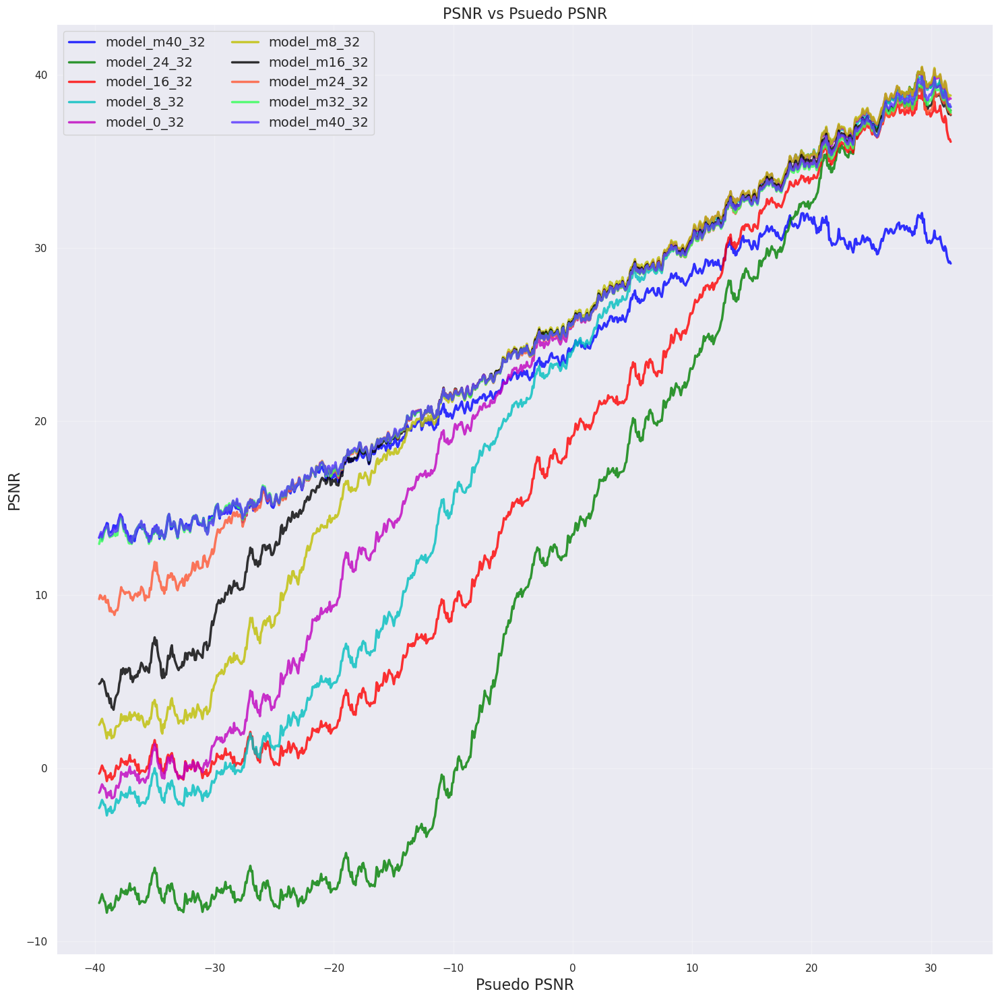

In [34]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Psnr_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/PSNR_vs_Psuedo_PSNR_Curriculum_Models.pdf", format = "pdf", dpi = 300)
plt.show()

In [35]:
Psnr_columns = ["m40_32", "24_32", "16_24", "8_16", "0_8", "m8_0", "m16_m8", "m24_m16", "m32_m24", "m40_m32"]

In [36]:
# Combines the 9 different models into a single model.
Augmented_Psnr_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Psnr_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Psnr_Distribution.extend(Specific_Psnr_Distribution)
Augmented_Psnr_Distribution = np.array(Augmented_Psnr_Distribution)
Augmented_Psnr_Distribution.shape

(891,)

In [37]:
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,-7.791832,-0.327677,-2.315507,-1.425197,2.485605,4.849792,9.747193,12.931356,13.300986
10,-39.559511,13.361748,-7.673996,-0.221749,-2.208136,-1.317711,2.575100,4.894582,9.976837,13.141731,13.480507
11,-39.479422,13.514017,-7.467824,-0.026504,-2.003608,-1.113549,2.717987,4.978465,9.929202,13.368886,13.621488
12,-39.399333,13.179642,-7.283468,0.140187,-1.844677,-0.945044,2.837498,5.128501,9.775211,13.079392,13.312102
13,-39.319244,13.476313,-7.477726,0.012141,-1.958896,-1.040871,2.617168,5.023585,9.731790,13.252924,13.531442
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.389116,36.817523,38.559213,38.957206,39.086917,38.068411,38.210648,38.383749,38.558244
896,31.399333,29.333183,38.096536,36.536352,38.320273,38.743279,38.904639,37.875243,37.980625,38.137376,38.346663
897,31.479422,29.168538,37.821302,36.292850,38.124823,38.569237,38.736703,37.738866,37.859427,37.994106,38.180836
898,31.559511,29.226247,37.853233,36.290292,38.168137,38.659996,38.837104,37.763084,37.873544,38.041628,38.313694


In [38]:
idx = 8
print(PSNR_Ranges[idx][0], PSNR_Ranges[idx][1])
Specific_Psnr_Distribution = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
Specific_Psnr_Distribution.iloc[:, -(idx+1)]

24 32


804    36.734188
805    36.782909
806    36.927193
807    37.380439
808    37.251534
         ...    
895    38.389116
896    38.096536
897    37.821302
898    37.853233
899    37.953980
Name: Psnr_Distribution_24_32, Length: 96, dtype: float64

In [39]:
Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"] = Augmented_Psnr_Distribution

In [193]:
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,-8.807845,-1.274334,-3.230460,-2.307835,1.733227,4.383237,7.819912,13.143361,13.744031
1,-39.919911,11.197247,-11.852603,-4.239110,-6.323534,-5.481950,-0.877312,1.826622,8.412304,9.519016,10.927868
2,-39.839822,15.486684,-7.283725,0.329085,-1.725354,-0.917776,3.740061,5.659464,11.051834,14.744418,15.087534
3,-39.759733,12.448342,-6.244953,0.852365,-1.067871,-0.149748,3.711948,5.601339,9.399683,13.172113,12.985627
4,-39.679644,11.442880,-6.844496,0.534661,-1.476664,-0.606552,3.138452,5.636496,9.702582,11.281038,11.456978
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,34.734503,33.093615,35.568464,36.622534,37.145710,36.437614,36.325686,36.281697,36.585042
896,31.759733,28.674237,37.484039,35.805880,37.880770,38.295175,38.507159,37.233190,37.132427,37.203964,37.646528
897,31.839822,29.096009,37.326116,36.169564,37.887821,38.322665,38.389747,37.448343,37.670728,37.836255,37.895987
898,31.919911,30.148988,39.700998,37.408609,39.630964,40.162549,40.304339,38.441179,38.575271,39.073213,39.850183


In [195]:
np.save("Data/Ensemble_Model_m40_32.npy", Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"].values)
np.save("Data/Curriculum_Model_m40_32.npy", Smoothed_Psnr_Distribution["Psnr_Distribution_m40_m32"].values)

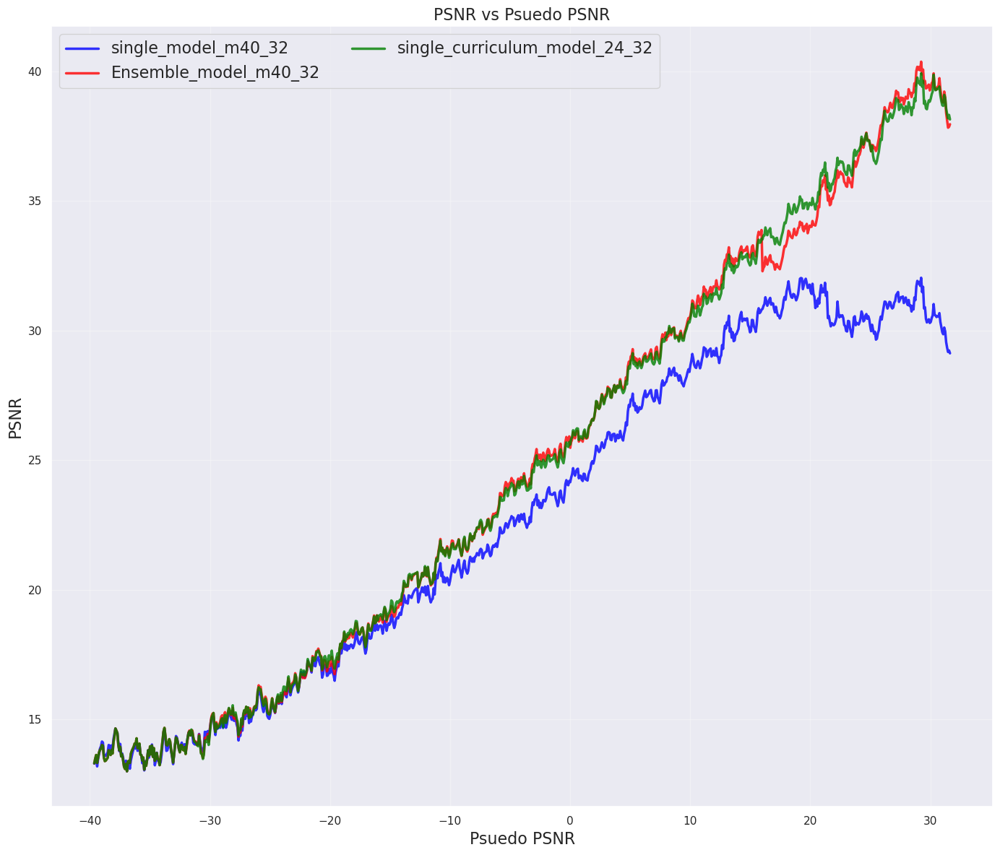

In [40]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Augmented_Psnr_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 16, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/PSNR_vs_Psuedo_PSNR_CurriculumEnsemble_Model.pdf", format = "pdf", dpi = 300)
plt.show()

In [51]:
# Generates the SSIM Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
SSIM_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "SSIM_Distribution_m40_32":SSIM_Distribution_1, "SSIM_Distribution_24_32":SSIM_Distribution_2, "SSIM_Distribution_16_24":SSIM_Distribution_3, 
                                  "SSIM_Distribution_8_16":SSIM_Distribution_4, "SSIM_Distribution_0_8":SSIM_Distribution_5, "SSIM_Distribution_m8_0":SSIM_Distribution_6, 
                                  "SSIM_Distribution_m16_m8":SSIM_Distribution_7, "SSIM_Distribution_m24_m16":SSIM_Distribution_8, "SSIM_Distribution_m32_m24":SSIM_Distribution_9, 
                                  "SSIM_Distribution_m40_m32":SSIM_Distribution_10})
SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
0,-40.000000,0.390496,0.125072,0.200736,0.148305,0.114437,0.105101,0.156558,0.215976,0.401179,0.403152
1,-39.919911,0.526384,0.195246,0.269637,0.149184,0.135099,0.118989,0.113490,0.271804,0.468762,0.518763
2,-39.839822,0.375515,0.173864,0.256184,0.196459,0.163042,0.184066,0.189237,0.253375,0.362306,0.371710
3,-39.759733,0.356718,0.168776,0.185582,0.115010,0.115798,0.110836,0.094038,0.208560,0.375556,0.377362
4,-39.679644,0.221678,0.099609,0.149668,0.115017,0.102250,0.101589,0.114439,0.153403,0.204319,0.210024
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.918908,0.982483,0.975543,0.983973,0.986664,0.987378,0.986368,0.985756,0.984674,0.985156
896,31.759733,0.911203,0.975573,0.970352,0.977080,0.978608,0.978479,0.977059,0.975724,0.973890,0.973486
897,31.839822,0.906421,0.973301,0.968411,0.975174,0.977360,0.977756,0.977003,0.976427,0.975525,0.976162
898,31.919911,0.928583,0.984635,0.979521,0.984070,0.984834,0.984939,0.982738,0.981891,0.981635,0.982452


In [52]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Smoothed_SSIM_Distribution = SSIM_Distribution.rolling(window=10).mean()
Smoothed_SSIM_Distribution = Smoothed_SSIM_Distribution.dropna()
Smoothed_SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
9,-39.639600,0.351868,0.140505,0.197834,0.134359,0.117384,0.116902,0.124437,0.217369,0.343858,0.354148
10,-39.559511,0.356867,0.143197,0.198302,0.134623,0.119901,0.115643,0.121953,0.221585,0.347994,0.359731
11,-39.479422,0.345892,0.140868,0.194906,0.130348,0.117996,0.115740,0.119833,0.213669,0.337505,0.346999
12,-39.399333,0.332943,0.137874,0.188160,0.122203,0.114073,0.111604,0.114209,0.207662,0.325772,0.333814
13,-39.319244,0.327897,0.132660,0.187001,0.123201,0.112330,0.108919,0.115485,0.207751,0.318805,0.325740
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.925335,0.979930,0.974994,0.979971,0.981450,0.981658,0.980061,0.979199,0.978593,0.979188
896,31.399333,0.923415,0.979621,0.974624,0.979832,0.981356,0.981543,0.979972,0.979074,0.978381,0.978916
897,31.479422,0.920253,0.978716,0.973637,0.979283,0.980919,0.981120,0.979611,0.978761,0.978033,0.978548
898,31.559511,0.920735,0.979124,0.974097,0.979759,0.981356,0.981564,0.980116,0.979350,0.978663,0.979166


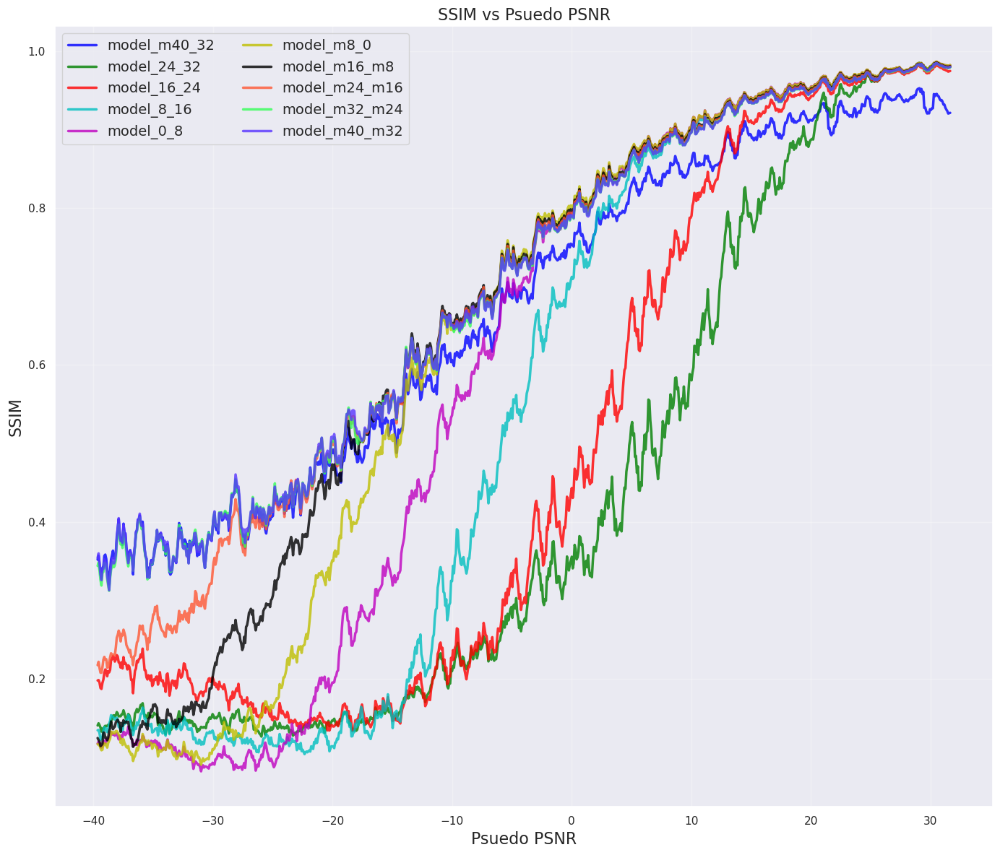

In [53]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, SSIM in enumerate(Smoothed_SSIM_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = SSIM, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/SSIM_vs_Psuedo_PSNR_Curriculum_Models.pdf", format = "pdf", dpi = 300)
plt.show()

In [54]:
# Combines the 9 different models into a single model.
Augmented_SSIM_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_SSIM_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_SSIM_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_SSIM_Distribution.extend(Specific_SSIM_Distribution)
Augmented_SSIM_Distribution = np.array(Augmented_SSIM_Distribution)
Augmented_SSIM_Distribution.shape

(891,)

In [55]:
Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"] = Augmented_SSIM_Distribution

In [56]:
np.save("Data/Ensemble_Model_SSIM_m40_32.npy", Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"].values)
np.save("Data/Curriculum_Model_SSIM_m40_32.npy", Smoothed_SSIM_Distribution["SSIM_Distribution_m40_m32"].values)

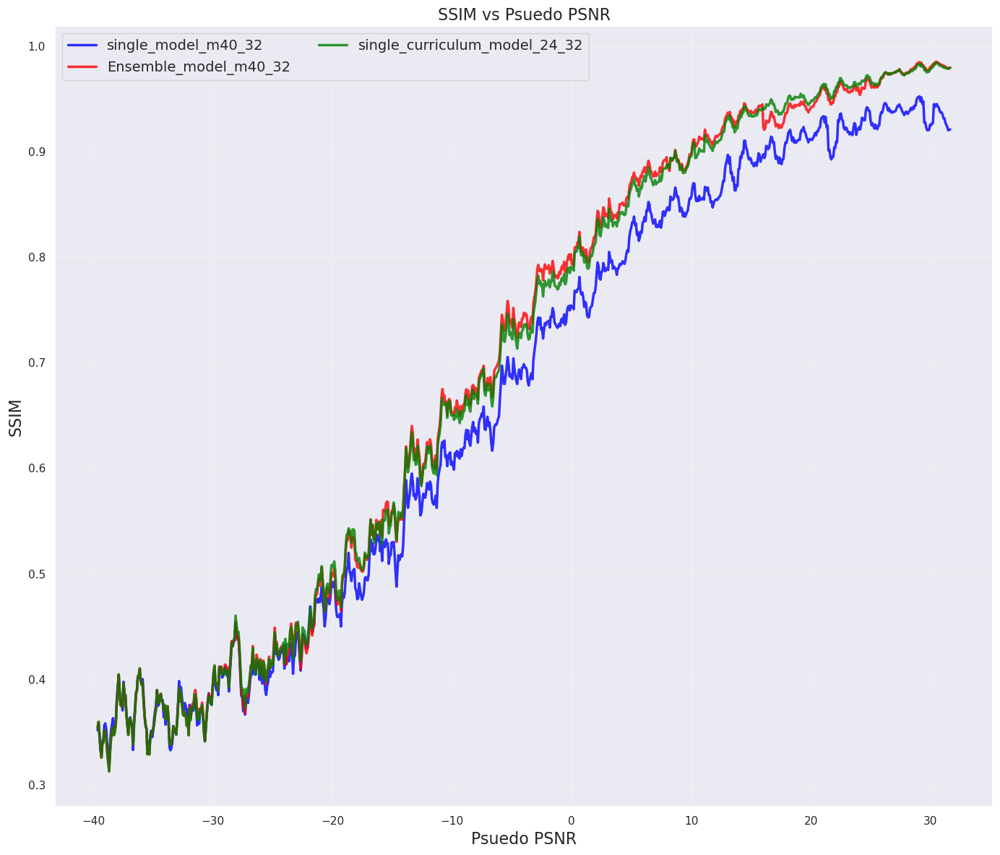

In [57]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "Augmented_SSIM_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/SSIM_vs_Psuedo_PSNR_CurriculumEnsemble_Model.pdf", format = "pdf", dpi = 300)
plt.show()

In [58]:
# Generates the Perceptual Loss Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
Perceptual_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Perceptual_Distribution_m40_32":Perceptual_Distribution_1, "Perceptual_Distribution_24_32":Perceptual_Distribution_2, "Perceptual_Distribution_16_24":Perceptual_Distribution_3, 
                                  "Perceptual_Distribution_8_16":Perceptual_Distribution_4, "Perceptual_Distribution_0_8":Perceptual_Distribution_5, "Perceptual_Distribution_m8_0":Perceptual_Distribution_6, 
                                  "Perceptual_Distribution_m16_m8":Perceptual_Distribution_7, "Perceptual_Distribution_m24_m16":Perceptual_Distribution_8, "Perceptual_Distribution_m32_m24":Perceptual_Distribution_9, 
                                  "Perceptual_Distribution_m40_m32":Perceptual_Distribution_10})
Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
0,-40.000000,0.172402,0.172353,0.172402,0.172422,0.172630,0.172220,0.172306,0.172355,0.172362,0.172369
1,-39.919911,0.151720,0.151701,0.151684,0.151720,0.151911,0.151618,0.151646,0.151643,0.151659,0.151657
2,-39.839822,0.126976,0.126886,0.126879,0.126898,0.127201,0.126879,0.126868,0.126838,0.126840,0.126842
3,-39.759733,0.153367,0.153233,0.153313,0.153295,0.153386,0.153169,0.153245,0.153313,0.153366,0.153361
4,-39.679644,0.111610,0.111619,0.111620,0.111661,0.111668,0.111495,0.111562,0.111621,0.111662,0.111659
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.700143,0.753535,0.747633,0.757606,0.763344,0.764465,0.764119,0.765115,0.760296,0.760412
896,31.759733,0.675431,0.712385,0.707614,0.710906,0.712381,0.713035,0.711345,0.712617,0.709186,0.710130
897,31.839822,0.577300,0.608249,0.606824,0.611465,0.615467,0.614613,0.613833,0.614898,0.611186,0.612601
898,31.919911,0.661423,0.697056,0.695196,0.698968,0.700821,0.701631,0.700721,0.702181,0.700523,0.701578


In [59]:
# Generates the smoothed Perceptual Loss Distribution for the combined data.
Smoothed_Perceptual_Distribution = Perceptual_Distribution.rolling(window=10).mean()
Smoothed_Perceptual_Distribution = Smoothed_Perceptual_Distribution.dropna()
Smoothed_Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
9,-39.639600,0.135467,0.135436,0.135453,0.135486,0.135614,0.135272,0.135354,0.135409,0.135443,0.135447
10,-39.559511,0.136927,0.136890,0.136912,0.136943,0.137061,0.136728,0.136810,0.136864,0.136905,0.136910
11,-39.479422,0.135272,0.135231,0.135255,0.135287,0.135412,0.135072,0.135155,0.135211,0.135250,0.135256
12,-39.399333,0.134909,0.134877,0.134906,0.134930,0.135036,0.134704,0.134793,0.134857,0.134902,0.134909
13,-39.319244,0.127537,0.127526,0.127541,0.127577,0.127696,0.127337,0.127425,0.127485,0.127528,0.127535
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.648668,0.685545,0.681541,0.686432,0.689052,0.688728,0.688216,0.689399,0.686568,0.687671
896,31.399333,0.655081,0.692731,0.688483,0.693181,0.695756,0.695607,0.695034,0.696227,0.693369,0.694345
897,31.479422,0.649299,0.688027,0.683458,0.688749,0.691554,0.691508,0.690860,0.691980,0.689080,0.690115
898,31.559511,0.653860,0.693020,0.688546,0.693762,0.696667,0.696776,0.696031,0.697252,0.694530,0.695470


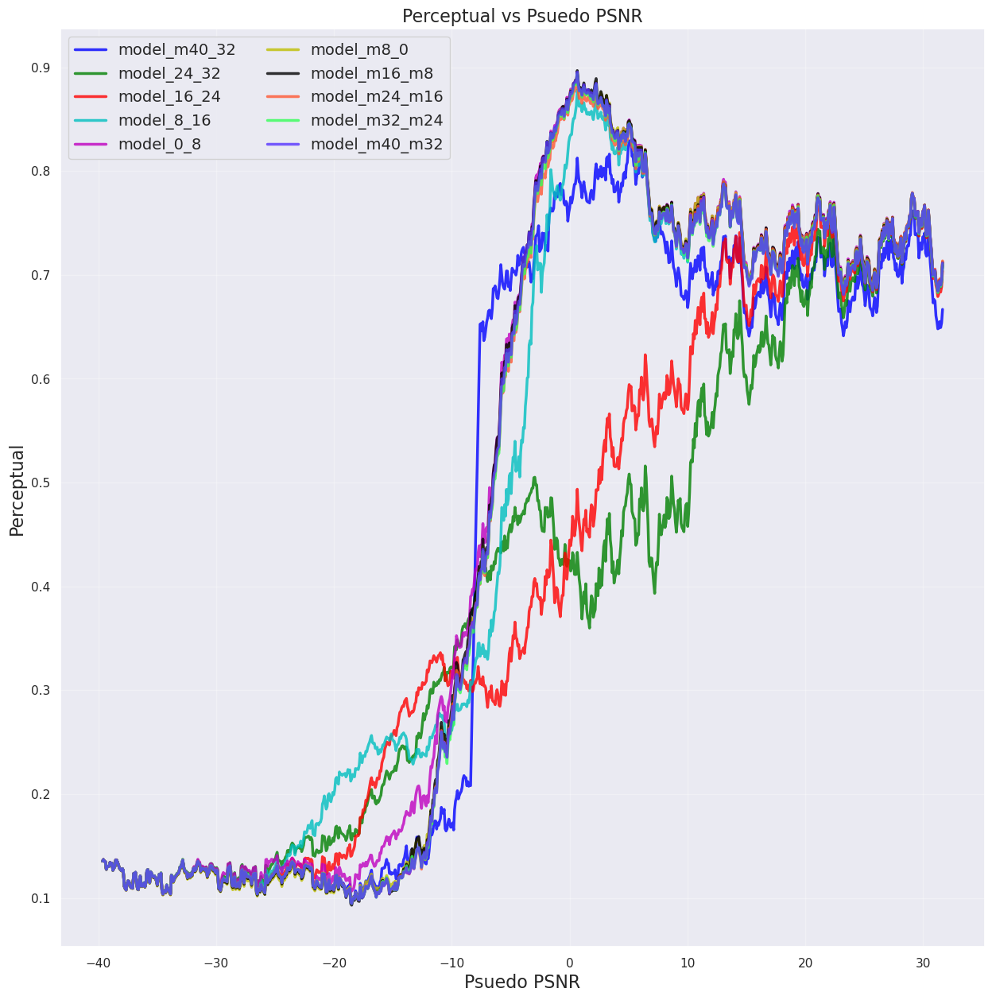

In [60]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Perceptual_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [61]:
# Combines the 9 different models into a single model.
Augmented_Perceptual_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Perceptual_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Perceptual_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Perceptual_Distribution.extend(Specific_Perceptual_Distribution)
Augmented_Perceptual_Distribution = np.array(Augmented_Perceptual_Distribution)
Augmented_Perceptual_Distribution.shape

(891,)

In [62]:
Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"] = Augmented_Perceptual_Distribution

In [212]:
np.save("Data/Ensemble_Model_Perceptual_m40_32.npy", Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"].values)
np.save("Data/Curriculum_Model_Perceptual_m40_32.npy", Smoothed_Perceptual_Distribution["Perceptual_Distribution_m40_m32"].values)

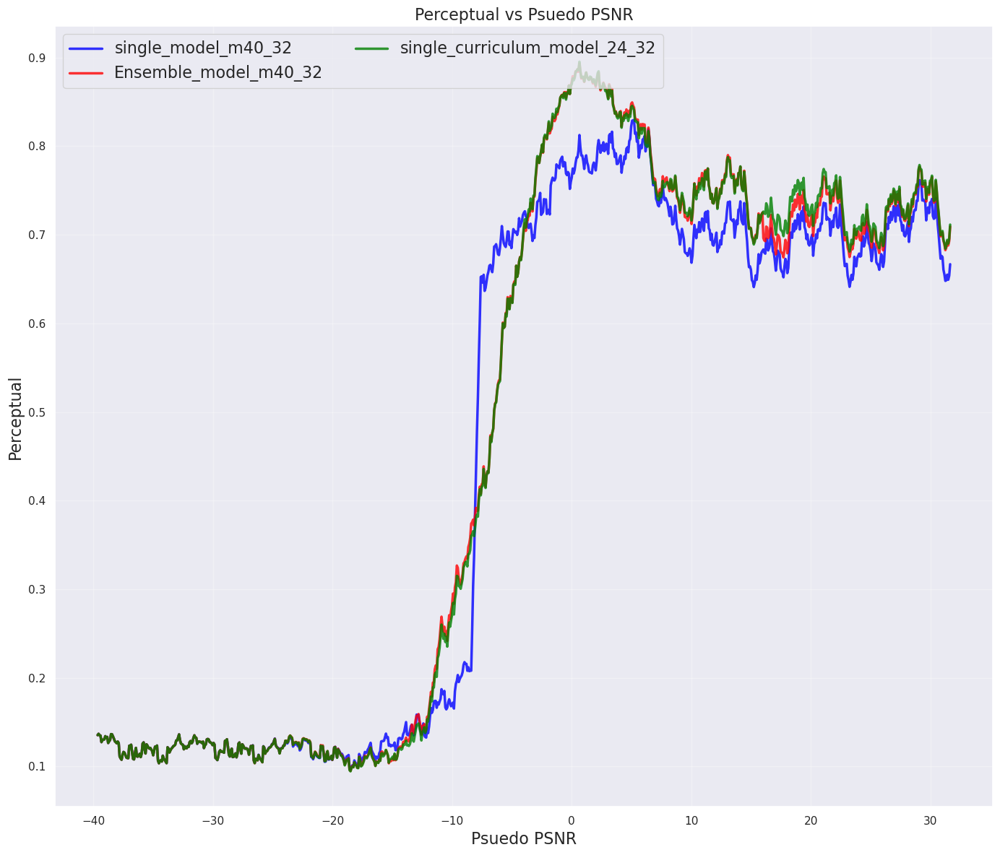

In [63]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Augmented_Perceptual_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_m32", alpha = 0.8, color = "green", linewidth = 2.5, label = "single_curriculum_model_24_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 16, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/Perceptual_vs_Psuedo_PSNR_CurriculumEnsemble_Model.pdf", format = "pdf", dpi = 300)
plt.show()

In [23]:
# Loads the models from their checkpoints and combines them to form the ensemble model.
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/"
model_m40_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m32-32"
CHECKPOINT_PATH = "./models/"
model_m32_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m24-32"
CHECKPOINT_PATH = "./models/"
model_m24_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m16-32"
CHECKPOINT_PATH = "./models/"
model_m16_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-m8-32"
CHECKPOINT_PATH = "./models/"
model_m8_0 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-0-32"
CHECKPOINT_PATH = "./models/"
model_0_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationProgressiveUNet128x128-8-32"
CHECKPOINT_PATH = "./models/"
model_8_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-16-32"
CHECKPOINT_PATH = "./models/"
model_16_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/"
model_24_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

Models = [model_m40_32, model_m32_24, model_m24_16, model_m16_8, model_m8_0, model_0_8, model_8_16, model_16_24, model_24_32]
Models

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


[UNet(
   (conv_final): Conv2d(50, 3, kernel_size=(1, 1), stride=(1, 1))
   (down_convs): ModuleList(
     (0): DownConv(
       (conv1): Conv2d(30, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (1): DownConv(
       (conv1): Conv2d(50, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (2): DownConv(
       (conv1): Conv2d(100, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(200, 200, kernel_size=(3, 3), stride=(1,

In [36]:
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1
    model = model.to(device)

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        print("Hello World", psnr, max_psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            print(max_photons, "Maximum Photons Reached")
            break
            
        if psnr > max_psnr:
            print(psnr, "Maximum Psnr Reached")
            break
    
        denoised = model(photons).detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    denoised_2 = denoised[...].detach().cpu().numpy()
    denoised_2 = (denoised_2 - denoised_2.min())/(denoised_2.max() - denoised_2.min())
    vmax = denoised_2.max()
    plt.figure(figsize=(5,5))
    plt.imshow(denoised_2[0].transpose(1,2,0),vmin = 0, vmax = vmax)
    plt.show()
    plt.clf()
    return denoised, photons, stack, i, psnr


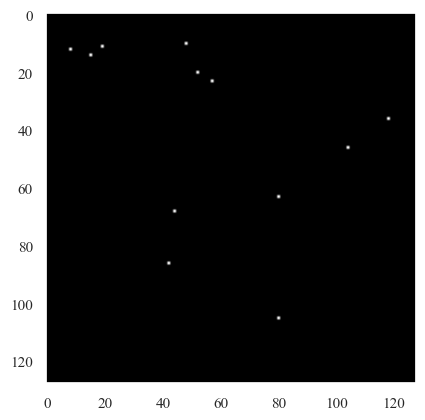

PSNR: -30.326692581176758


In [25]:
# Checks the Train_Dataset works
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(40)
plt.imshow(ImageNoise.detach().cpu().numpy().transpose(1,2,0)[:,:,0], cmap = "gray")
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")

In [26]:
PSNR_Ranges

[(-40, -32),
 (-32, -24),
 (-24, -16),
 (-16, -8),
 (-8, 0),
 (0, 8),
 (8, 16),
 (16, 24),
 (24, 32)]

PSNR: -500.0
Model: 1, psnr_level -32
Hello World -40 -32
-40
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -39.92571168970606 -32
-39.92571168970606
Hello World -38.46443124417179 -32
Hello World -38.46443124417179 -32
Hello World -37.884511940804714 -32
Hello World -36.91541173306625 -32
Hello World -36.91541173306625 -32
Hello World -36.50148499444094 -32
Hello World -36.12359947967774 -32
Hello World -36.12359947967774 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
-35.45413128753198
Hello World -35.45413128753198 -32
Hello World -34.8742119841649 -32
Hello World -34.12787582163215 -32
Hello World -33.90511177642644 -32
Hello World -33.90511177642644 -32
Hello World -33.49118503780113 -32
Hello World -33.11329952303793 -32
Hello World -33.11329952303793 -32
Hello World -32.601774298564116 -32
Hello World -32.291

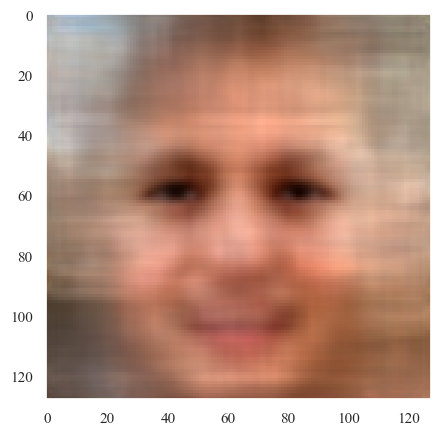

Psnr_Range -31.863912027525096 has been reached at 33 iterations
Model: 2, psnr_level -24
Hello World -31.863912027525096 -24
-31.863912027525096
Hello World -31.863912027525096 -24
Hello World -31.73027254137512 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.600622526098803 -24
Hello World -31.474731378315383 -24
Hello World -31.35238693248112 -24
Hello World -31.2333944756054 -24
Hello World -31.11757586499234 -24
-31.11757586499234
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -31.004765869889003 -24
Hello World -30.894811819786625 -24
Hello World -30.78757327193823 -24
Hello World -30.68291903617499 -24
Hello World -30.580727191718363 -24
-30.580727191718363
Hello World -30.480885081161325 -24
Hello World -30.480885081161325 -24
Hello World -30.28783344326195

<Figure size 640x480 with 0 Axes>

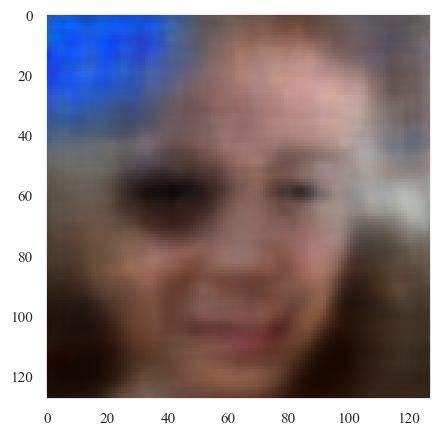

Psnr_Range -23.99285105753801 has been reached at 141 iterations
Model: 3, psnr_level -16
Hello World -23.99285105753801 -16
-23.99285105753801
Hello World -23.970749342151887 -16
Hello World -23.94876003753868 -16
Hello World -23.905111652173797 -16
Hello World -23.905111652173797 -16
Hello World -23.883451365949103 -16
Hello World -23.883451365949103 -16
Hello World -23.79787316796699 -16
Hello World -23.79787316796699 -16
Hello World -23.776739414772766 -16
Hello World -23.734778431228115 -16
-23.734778431228115
Hello World -23.65205301828121 -16
Hello World -23.631615905766616 -16
Hello World -23.570874428644682 -16
Hello World -23.510970791752808 -16
Hello World -23.412931460972736 -16
Hello World -23.412931460972736 -16
Hello World -23.355153076292908 -16
Hello World -23.29813329185599 -16
Hello World -23.27929214123255 -16
Hello World -23.18629162965599 -16
-23.18629162965599
Hello World -23.131432653400328 -16
Hello World -23.05934920417087 -16
Hello World -22.988442273411426 -

<Figure size 640x480 with 0 Axes>

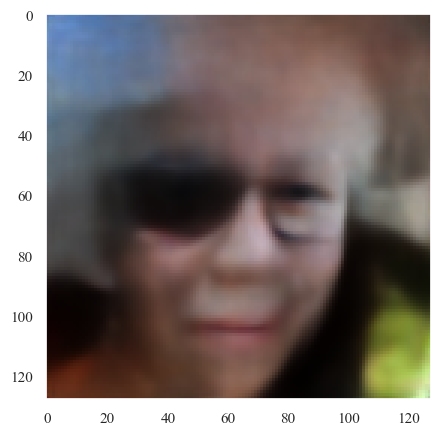

Psnr_Range -15.995227232626021 has been reached at 187 iterations
Model: 4, psnr_level -8
Hello World -15.995227232626021 -8
-15.995227232626021
Hello World -15.970700547111514 -8
Hello World -15.918605423706836 -8
Hello World -15.880795719206944 -8
Hello World -15.819626471110125 -8
Hello World -15.775978315134736 -8
Hello World -15.729458287916371 -8
Hello World -15.703097188149222 -8
Hello World -15.647606071052456 -8
Hello World -15.592815044843547 -8
Hello World -15.541870729845966 -8
-15.541870729845966
Hello World -15.497779637396112 -8
Hello World -15.43864860341122 -8
Hello World -15.392528402988106 -8
Hello World -15.337822987518345 -8
Hello World -15.286782006934732 -8
Hello World -15.221606897301147 -8
Hello World -15.186464873622052 -8
Hello World -15.15449934959718 -8
Hello World -15.094119799624009 -8
Hello World -15.068497631978005 -8
-15.068497631978005
Hello World -15.023316701417212 -8
Hello World -14.992525814472788 -8
Hello World -14.9508865231201 -8
Hello World -1

<Figure size 640x480 with 0 Axes>

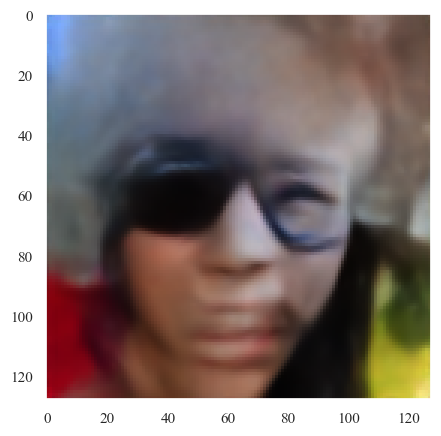

Psnr_Range -7.986122116601935 has been reached at 183 iterations
Model: 5, psnr_level 0
Hello World -7.986122116601935 0
-7.986122116601935
Hello World -7.940240511900923 0
Hello World -7.887227259331456 0
Hello World -7.8450624153198225 0
Hello World -7.809701455341407 0
Hello World -7.765109037562383 0
Hello World -7.722538535110165 0
Hello World -7.672101840647441 0
Hello World -7.6258232816014395 0
Hello World -7.581551273912156 0
Hello World -7.534219125945048 0
-7.534219125945048
Hello World -7.499303918617653 0
Hello World -7.4582646794093 0
Hello World -7.4137113420719905 0
Hello World -7.375400027587488 0
Hello World -7.335031545601015 0
Hello World -7.291718467827909 0
Hello World -7.24930195883257 0
Hello World -7.201725458985192 0
Hello World -7.1574187312549 0
Hello World -7.10901626571662 0
-7.10901626571662
Hello World -7.072389620354959 0
Hello World -7.022248672915287 0
Hello World -6.975321501416161 0
Hello World -6.920626391048268 0
Hello World -6.878652809530874 0
H

<Figure size 640x480 with 0 Axes>

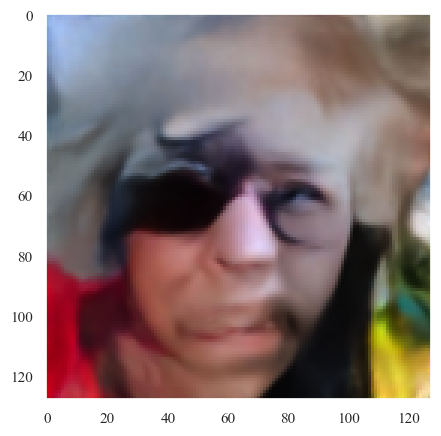

Psnr_Range 0.029587086437045947 has been reached at 186 iterations
Model: 6, psnr_level 8
Hello World 0.029587086437045947 8
0.029587086437045947
Hello World 0.06994298546601943 8
Hello World 0.11294184176529798 8
Hello World 0.15406932872396978 8
Hello World 0.20105796790352892 8
Hello World 0.24754364882341895 8
Hello World 0.2899020235797447 8
Hello World 0.33250637816014483 8
Hello World 0.3729126568872018 8
Hello World 0.41840667216470073 8
Hello World 0.46549365472273363 8
0.46549365472273363
Hello World 0.5104256794575652 8
Hello World 0.5528755292254832 8
Hello World 0.5936814027178372 8
Hello World 0.6357110219448328 8
Hello World 0.6795289812864374 8
Hello World 0.7213384247979768 8
Hello World 0.7622301495427053 8
Hello World 0.8067047226448264 8
Hello World 0.8490575821051811 8
Hello World 0.89272787899381 8
0.89272787899381
Hello World 0.9362488755956526 8
Hello World 0.9795492085894462 8
Hello World 1.0215841224543412 8
Hello World 1.0625939071541954 8
Hello World 1.10424

<Figure size 640x480 with 0 Axes>

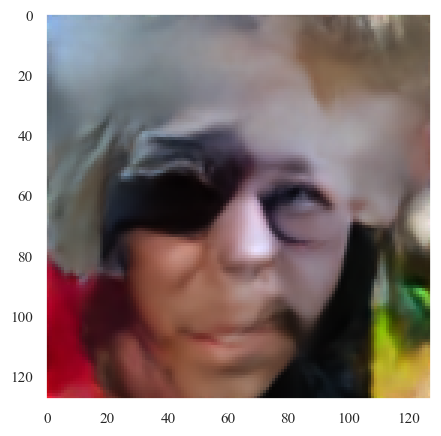

Psnr_Range 8.025354535917575 has been reached at 185 iterations
Model: 7, psnr_level 16
Hello World 8.025354535917575 16
8.025354535917575
Hello World 8.0683417597373 16
Hello World 8.111193989132389 16
Hello World 8.15410080014922 16
Hello World 8.197136766663222 16
Hello World 8.239577765543306 16
Hello World 8.283182984986519 16
Hello World 8.326393705721069 16
Hello World 8.36835534931469 16
Hello World 8.411354989370345 16
Hello World 8.453920642303382 16
8.453920642303382
Hello World 8.496735084641816 16
Hello World 8.539007775549933 16
Hello World 8.583432765530972 16
Hello World 8.62731076918196 16
Hello World 8.669681886057427 16
Hello World 8.713449990566579 16
Hello World 8.757181457076072 16
Hello World 8.799999512355875 16
Hello World 8.843460498091812 16
Hello World 8.886251077308163 16
8.886251077308163
Hello World 8.929121585017008 16
Hello World 8.970979665976236 16
Hello World 9.013913195743342 16
Hello World 9.057513323512556 16
Hello World 9.100897366010845 16
Hello

<Figure size 640x480 with 0 Axes>

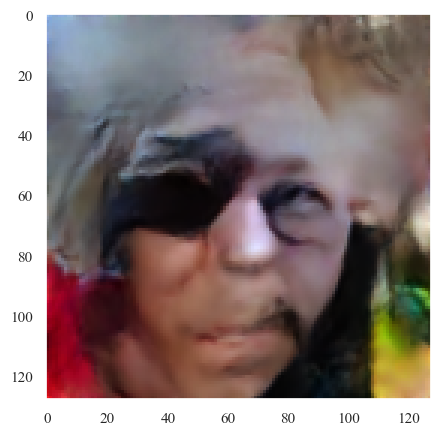

Psnr_Range 16.01636995055426 has been reached at 185 iterations
Model: 8, psnr_level 24
Hello World 16.01636995055426 24
16.01636995055426
Hello World 16.06023895303025 24
Hello World 16.103340114490102 24
Hello World 16.146403593276492 24
Hello World 16.189590453241507 24
Hello World 16.233397684563755 24
Hello World 16.277129375917024 24
Hello World 16.32013285424744 24
Hello World 16.363932971685884 24
Hello World 16.407728429093332 24
Hello World 16.451358578454514 24
16.451358578454514
Hello World 16.494687337694522 24
Hello World 16.53796458212347 24
Hello World 16.58115301312931 24
Hello World 16.624515579840093 24
Hello World 16.667641809329417 24
Hello World 16.71111671133509 24
Hello World 16.754484978045753 24
Hello World 16.79763363538796 24
Hello World 16.84076519450509 24
Hello World 16.883907540580484 24
16.883907540580484
Hello World 16.927229614626103 24
Hello World 16.97052485422059 24
Hello World 17.01410118450683 24
Hello World 17.056908590888558 24
Hello World 17.0

<Figure size 640x480 with 0 Axes>

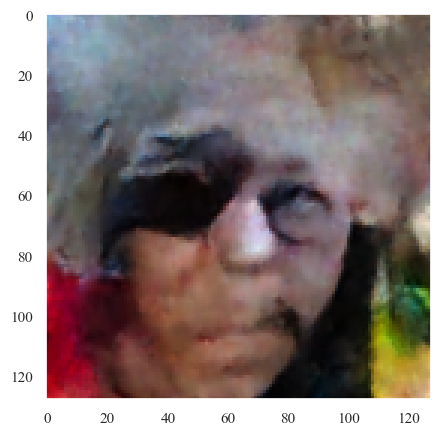

Psnr_Range 24.01409797176461 has been reached at 185 iterations
Model: 9, psnr_level 32
Hello World 24.01409797176461 32
24.01409797176461
Hello World 24.057372050059126 32
Hello World 24.100531628396027 32
Hello World 24.143770358164165 32
Hello World 24.187033675530827 32
Hello World 24.23026909024852 32
Hello World 24.27354503931772 32
Hello World 24.31673788085628 32
Hello World 24.359951725529598 32
Hello World 24.40326396622347 32
Hello World 24.44644227348774 32
24.44644227348774
Hello World 24.489637222169552 32
Hello World 24.532923453818107 32
Hello World 24.57605422372214 32
Hello World 24.61936892988165 32
Hello World 24.66259971772725 32
Hello World 24.705946206646296 32
Hello World 24.749293277617493 32
Hello World 24.79240277879507 32
Hello World 24.835794622485025 32
Hello World 24.879059316321378 32
24.879059316321378
Hello World 24.922207467947235 32
Hello World 24.965373918843166 32
Hello World 25.00870074777709 32
Hello World 25.05183276752986 32
Hello World 25.0949

<Figure size 640x480 with 0 Axes>

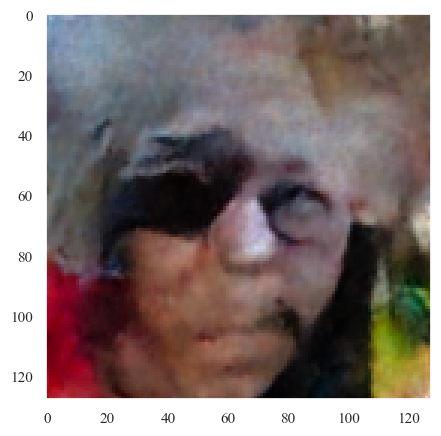

Psnr_Range 32.00938190115394 has been reached at 185 iterations


((9, 1, 3, 128, 128), (9, 1, 3, 128, 128))

<Figure size 640x480 with 0 Axes>

In [27]:
# Generates an unseen image from a blank canvas using the ensemble model.
def Sample_From_Scratch(input_image,
                        Models,
                        max_photons = None,
                        max_its = 500000,
                        max_psnr_list = None,
                        save_every_n = 5,
                        beta = 0.15
                        ):
    output_images = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    output_photons = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    stacks = []
    for i, model in enumerate(Models):
        if i == 0:
            photons = input_image.clone()
        if max_psnr_list is not None:
            max_psnr = max_psnr_list[i]
        else:
            max_psnr = -15
        print(f"Model: {i+1}, psnr_level {max_psnr_list[i]}")
        denoised, photons, stack, it, psnr = sample_image_3(photons, model, max_photons = max_photons, max_its = max_its, max_psnr = max_psnr, save_every_n = save_every_n, beta = beta)
        print(f"Psnr_Range {psnr} has been reached at {it} iterations")
        output_images[i] = denoised[...].detach().cpu().numpy()
        output_photons[i] = photons[...].detach().cpu().numpy()
        stacks.append(stack)

    return output_images, output_photons

inp_img = torch.zeros(1,3,128,128).to(device)
Psnr = np.log10(inp_img.mean().item() + 1e-50) * 10
print(f"PSNR: {Psnr}")
Output_Images, Output_Photons = Sample_From_Scratch(inp_img, Models, max_photons = 1e8, max_its = 1000, max_psnr_list = [-32, -24, -16, -8, 0, 8, 16, 24, 32], save_every_n = 5, beta = 0.01)
Output_Images.shape, Output_Photons.shape

In [28]:
# Generates the images from the blank canvas using the curriculum trained model. 
name = "FaceGenerationProgressiveUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/"
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

torch.Size([1, 3, 128, 128])
Hello World -33.6932189928148 32
-33.6932189928148
Hello World -33.6932189928148 32
Hello World -33.11329952303793 32
Hello World -32.93601152209324 32
Hello World -32.765678301147545 32
Hello World -32.443831330892166 32
Hello World -32.14419939295737 32
Hello World -32.14419939295737 32
Hello World -31.863912027525096 32
Hello World -31.73027254137512 32
Hello World -31.474731378315383 32
-31.474731378315383
Hello World -31.2333944756054 32
Hello World -31.004765869889003 32
Hello World -31.004765869889003 32
Hello World -31.004765869889003 32
Hello World -30.894811819786625 32
Hello World -30.580727191718363 32
Hello World -30.580727191718363 32
Hello World -30.480885081161325 32
Hello World -30.287833443261952 32
Hello World -30.194433272674374 32
-30.194433272674374
Hello World -30.102999566398122 32
Hello World -30.013450970817637 32
Hello World -29.925711565453422 32
Hello World -29.755378344507733 32
Hello World -29.672652931560837 32
Hello World -2

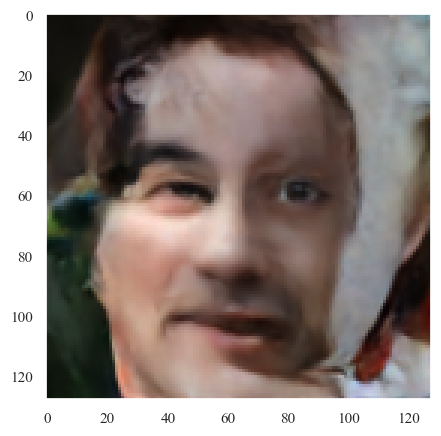

ValueError: too many values to unpack (expected 4)

<Figure size 640x480 with 0 Axes>

In [37]:
# Generates the unseen image from a blank canvas using a curricullum trained model
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.01,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])